In [ ]:
!nvidia-smi

Fri Dec  3 08:31:02 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# Imports
import torch
import torchvision # torch package for vision related things
import torch.nn as nn
import torch.nn.functional as F  # Parameterless functions, like (some) activation functions
import torchvision.datasets as datasets  # Standard datasets
import torchvision.transforms as transforms  # Transformations we can perform on our dataset for augmentation
from PIL import Image
from torchvision import models
from torch import optim  # For optimizers like SGD, Adam, etc.
# import torch_optimizer as optimi
# from torch import nn  # All neural network modules
# from torch.utils.data import DataLoader  # Gives easier dataset managment by creating mini batches etc.
from tqdm import tqdm  # For nice progress bar!
from torchsummary import summary
# import albumentations as A
# from albumentations.pytorch import ToTensorV2
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import skimage as io
import torch.backends.cudnn as cudnn
import torch.nn.init as init
from torch.autograd import Variable
import sys
import time
from datetime import datetime

# HarDNet - MSEG model

In [ ]:
# +
class Flatten(nn.Module):
    def __init__(self):
        super().__init__()
    def forward(self, x):
        return x.view(x.data.size(0),-1)
    
class ConvLayer(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel=3, stride=1, dropout=0.1, bias=False):
        super().__init__()
        out_ch = out_channels
        groups = 1
        #print(kernel, 'x', kernel, 'x', in_channels, 'x', out_channels)
        self.add_module('conv', nn.Conv2d(in_channels, out_ch, kernel_size=kernel,          
                                          stride=stride, padding=kernel//2, groups=groups, bias=bias))
        self.add_module('norm', nn.BatchNorm2d(out_ch))
        self.add_module('relu', nn.ReLU6(True))                                          
    def forward(self, x):
        return super().forward(x)


# -

class HarDBlock(nn.Module):
    def get_link(self, layer, base_ch, growth_rate, grmul):
        if layer == 0:
          return base_ch, 0, []
        out_channels = growth_rate
        link = []
        for i in range(10):
          dv = 2 ** i
          if layer % dv == 0:
            k = layer - dv
            link.append(k)
            if i > 0:
                out_channels *= grmul
        out_channels = int(int(out_channels + 1) / 2) * 2
        in_channels = 0
        for i in link:
          ch,_,_ = self.get_link(i, base_ch, growth_rate, grmul)
          in_channels += ch
        return out_channels, in_channels, link

    def get_out_ch(self):
        return self.out_channels

    def __init__(self, in_channels, growth_rate, grmul, n_layers, keepBase=False, residual_out=False, dwconv=False):
        super().__init__()
        self.keepBase = keepBase
        self.links = []
        layers_ = []
        self.out_channels = 0 # if upsample else in_channels
        for i in range(n_layers):
          outch, inch, link = self.get_link(i+1, in_channels, growth_rate, grmul)
          self.links.append(link)
          use_relu = residual_out
          if dwconv:
            layers_.append(CombConvLayer(inch, outch))
          else:
            layers_.append(ConvLayer(inch, outch))
          
          if (i % 2 == 0) or (i == n_layers - 1):
            self.out_channels += outch
        #print("Blk out =",self.out_channels)
        self.layers = nn.ModuleList(layers_)
        
    def forward(self, x):
        layers_ = [x]
        
        for layer in range(len(self.layers)):
            link = self.links[layer]
            tin = []
            for i in link:
                tin.append(layers_[i])
            if len(tin) > 1:            
                x = torch.cat(tin, 1)
            else:
                x = tin[0]
            out = self.layers[layer](x)
            layers_.append(out)
            
        t = len(layers_)
        out_ = []
        for i in range(t):
          if (i == 0 and self.keepBase) or \
             (i == t-1) or (i%2 == 1):
              out_.append(layers_[i])
        out = torch.cat(out_, 1)
        return out

# +
class HarDNet(nn.Module):
    def __init__(self, depth_wise=False, arch=85, pretrained=True, weight_path=''):
        super().__init__()
        first_ch  = [32, 64]
        second_kernel = 3
        max_pool = True
        grmul = 1.7
        drop_rate = 0.1
        
        #HarDNet68
        ch_list = [  128, 256, 320, 640, 1024]
        gr       = [  14, 16, 20, 40,160]
        n_layers = [   8, 16, 16, 16,  4]
        downSamp = [   1,  0,  1,  1,  0]
        
        # if arch==85:
        #   #HarDNet85
        #   first_ch  = [48, 96]
        #   ch_list = [  192, 256, 320, 480, 720, 1280]
        #   gr       = [  24,  24,  28,  36,  48, 256]
        #   n_layers = [   8,  16,  16,  16,  16,   4]
        #   downSamp = [   1,   0,   1,   0,   1,   0]
        #   drop_rate = 0.2
        # elif arch==39:
        #   #HarDNet39
        #   first_ch  = [24, 48]
        #   ch_list = [  96, 320, 640, 1024]
        #   grmul = 1.6
        #   gr       = [  16,  20, 64, 160]
        #   n_layers = [   4,  16,  8,   4]
        #   downSamp = [   1,   1,  1,   0]
          
        if depth_wise:
          second_kernel = 1
          max_pool = False
          drop_rate = 0.05
        
        blks = len(n_layers)
        self.base = nn.ModuleList([])

        # First Layer: Standard Conv3x3, Stride=2
        self.base.append (
             ConvLayer(in_channels=3, out_channels=first_ch[0], kernel=3,
                       stride=2,  bias=False) )
  
        # Second Layer
        self.base.append ( ConvLayer(first_ch[0], first_ch[1],  kernel=second_kernel) )
        
        # Maxpooling or DWConv3x3 downsampling
        if max_pool:
          self.base.append(nn.MaxPool2d(kernel_size=3, stride=2, padding=1))
        else:
          self.base.append ( DWConvLayer(first_ch[1], first_ch[1], stride=2) )

        # Build all HarDNet blocks
        ch = first_ch[1]
        for i in range(blks):
            blk = HarDBlock(ch, gr[i], grmul, n_layers[i], dwconv=depth_wise)
            ch = blk.get_out_ch()
            self.base.append ( blk )
            
            # if i == blks-1 and arch == 85:
            #     self.base.append ( nn.Dropout(0.1))
            
            self.base.append ( ConvLayer(ch, ch_list[i], kernel=1) )
            ch = ch_list[i]
            if downSamp[i] == 1:
              if max_pool:
                self.base.append(nn.MaxPool2d(kernel_size=2, stride=2))
              else:
                self.base.append ( DWConvLayer(ch, ch, stride=2) )
            
        
        ch = ch_list[blks-1]
        self.base.append (
            nn.Sequential(
                nn.AdaptiveAvgPool2d((1,1)),
                Flatten(),
                nn.Dropout(drop_rate),
                nn.Linear(ch, 1000) ))
                
    def forward(self, x):
        out_branch =[]
        #for layer in self.base:
        #    x = layer(x)
            
        for i in range(len(self.base)-1):
            x = self.base[i](x)
            if i == 4 or i == 9 or i == 12 or i == 15:
                out_branch.append(x)

        out = x
        
        #for i in range(4):
        #    print(out_branch[i].size())
            
        return out_branch
    
def hardnet(arch=68,pretrained=True, **kwargs):
    if arch == 68:
        print("68 LOADED")
        model = HarDNet(arch=68)
        if pretrained:
            weights = torch.load('/home/james128333/PraNet/lib/hardnet68.pth')
            model.load_state_dict(weights)
            print("68 LOADED READY")
    #elif arch == 85:
    #    print("85 LOADED")
    #    model = HarDNet(arch=85)
    #    if pretrained:
    #        print("HAAAHAAA")
    #        weights = torch.load('/home/james128333/HarDNet-MSEG/lib/hardnet85.pth')
    #        model.load_state_dict(weights)
    return model

class BasicConv2d(nn.Module):
    def __init__(self, in_planes, out_planes, kernel_size, stride=1, padding=0, dilation=1):
        super(BasicConv2d, self).__init__()
        
        
        self.conv = nn.Conv2d(in_planes, out_planes,
                              kernel_size=kernel_size, stride=stride,
                              padding=padding, dilation=dilation, bias=False)
        self.bn = nn.BatchNorm2d(out_planes)
        self.relu = nn.ReLU(inplace=True)
        
        

    def forward(self, x):
        
        x = self.conv(x)
        x = self.bn(x)
        return x

class AttentionBlock(nn.Module):
    """Attention block with learnable parameters"""

    def __init__(self, F_g, F_l, n_coefficients):
        """
        :param F_g: number of feature maps (channels) in previous layer
        :param F_l: number of feature maps in corresponding encoder layer, transferred via skip connection
        :param n_coefficients: number of learnable multi-dimensional attention coefficients
        """
        super(AttentionBlock, self).__init__()

        self.W_gate = nn.Sequential(
            nn.Conv2d(F_g, n_coefficients, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(n_coefficients)
        )

        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, n_coefficients, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(n_coefficients)
        )

        self.psi = nn.Sequential(
            nn.Conv2d(n_coefficients, 1, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, gate, skip_connection):
        """
        :param gate: gating signal from previous layer
        :param skip_connection: activation from corresponding encoder layer
        :return: output activations
        """
        g1 = self.W_gate(gate)
        x1 = self.W_x(skip_connection)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        out = skip_connection * psi
        return out

class RFB_modified(nn.Module):
    def __init__(self, in_channel, out_channel):
        super(RFB_modified, self).__init__()
        self.relu = nn.ReLU(True)
        self.branch0 = nn.Sequential(
            BasicConv2d(in_channel, out_channel, 1),
        )
        self.branch1 = nn.Sequential(
            BasicConv2d(in_channel, out_channel, 1),
            BasicConv2d(out_channel, out_channel, kernel_size=(1, 3), padding=(0, 1)),
            BasicConv2d(out_channel, out_channel, kernel_size=(3, 1), padding=(1, 0)),
            BasicConv2d(out_channel, out_channel, 3, padding=3, dilation=3)
        )
        self.branch2 = nn.Sequential(
            BasicConv2d(in_channel, out_channel, 1),
            BasicConv2d(out_channel, out_channel, kernel_size=(1, 5), padding=(0, 2)),
            BasicConv2d(out_channel, out_channel, kernel_size=(5, 1), padding=(2, 0)),
            BasicConv2d(out_channel, out_channel, 3, padding=5, dilation=5)
        )
        self.branch3 = nn.Sequential(
            BasicConv2d(in_channel, out_channel, 1),
            BasicConv2d(out_channel, out_channel, kernel_size=(1, 7), padding=(0, 3)),
            BasicConv2d(out_channel, out_channel, kernel_size=(7, 1), padding=(3, 0)),
            BasicConv2d(out_channel, out_channel, 3, padding=7, dilation=7)
        )
        self.conv_cat = BasicConv2d(4*out_channel, out_channel, 3, padding=1)
        self.conv_res = BasicConv2d(in_channel, out_channel, 1)

    def forward(self, x):
        x0 = self.branch0(x)
        x1 = self.branch1(x)
        x2 = self.branch2(x)
        x3 = self.branch3(x)
        x_cat = self.conv_cat(torch.cat((x0, x1, x2, x3), 1))

        x = self.relu(x_cat + self.conv_res(x))
        return x

class UpConv(nn.Module):

    def __init__(self, in_channels, out_channels):
        super(UpConv, self).__init__()

        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.up(x)
        return x
    
class aggregation(nn.Module):
    # dense aggregation, it can be replaced by other aggregation previous, such as DSS, amulet, and so on.
    # used after MSF
    def __init__(self, channel):
        super(aggregation, self).__init__()
        self.relu = nn.ReLU(True)

        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.conv_upsample1 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample2 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample3 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample4 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample5 = BasicConv2d(2*channel, 2*channel, 3, padding=1)
        
        
        self.conv_upsample6 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample7 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample8 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample9 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        
        self.conv_concat2 = BasicConv2d(2*channel, 2*channel, 3, padding=1)
        self.conv_concat3 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        self.conv_concat4 = BasicConv2d(4*channel, 4*channel, 3, padding=1)
        self.conv4 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        self.conv5 = nn.Conv2d(3*channel, 1, 1)

    def forward(self, x1, x2, x3): # x1 1,32,11,11 x2 1,32,22,22 x3 1,32,44,44 x3 1,32,88,88
        x1_1 = x1 #1 32 11 11 
        x2_1 = self.conv_upsample1(self.upsample(x1)) * x2 # 1 32 22 22 
        x3_1 = self.conv_upsample2(self.upsample(self.upsample(x1))) \
               * self.conv_upsample3(self.upsample(x2)) * x3 # 1 32 44 44 
               
        # x4_1 = self.conv_upsample6(self.upsample(self.upsample(self.upsample(x1)))) \
        #         * self.conv_upsample7(self.upsample(self.upsample(x2)))\
        #             * self.conv_upsample8(self.upsample(x3)) * x4 # 1 32 88 88 
        
        x2_2 = torch.cat((x2_1, self.conv_upsample4(self.upsample(x1_1))), 1) # 1 64 22 22 
        x2_2 = self.conv_concat2(x2_2) # 1 64 22 22  

        x3_2 = torch.cat((x3_1, self.conv_upsample5(self.upsample(x2_2))), 1) # 1 96 44 44  
        x3_2 = self.conv_concat3(x3_2) # 1 96 44 44  

        # x4_2 =  torch.cat((x4_1, self.conv_upsample9(self.upsample(x3_2))), 1) # 1,128,88,88
        # x4_2 = self.conv_concat4(x4_2) # 1,128,88,88
        
        x = self.conv4(x3_2) # 1 128 88 88  
        x = self.conv5(x) # 1 1 88 88  

        return x
    
class agressive_aggregation(nn.Module):
    # dense aggregation, it can be replaced by other aggregation previous, such as DSS, amulet, and so on.
    # used after MSF
    def __init__(self, channel):
        super(aggregation, self).__init__()
        self.relu = nn.ReLU(True)

        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.conv_upsample1 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample2 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample3 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample4 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample5 = BasicConv2d(2*channel, 2*channel, 3, padding=1)

        self.conv_concat2 = BasicConv2d(2*channel, 2*channel, 3, padding=1)
        self.conv_concat3 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        self.conv4 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        self.conv5 = nn.Conv2d(3*channel, 1, 1)

    def forward(self, x1, x2, x3): # x1 1,32,11,11 x2 1,32,22,22 x3 1,32,44,44
        x1_1 = x1 #1 32 11 11 
        x2_1 = self.conv_upsample1(self.upsample(x1)) * x2 # 1 32 22 22 
        x3_1 = self.conv_upsample2(self.upsample(self.upsample(x1))) \
               * self.conv_upsample3(self.upsample(x2)) * x3 # 1 32 44 44 
        
        
        
        x2_2 = torch.cat((x2_1, self.conv_upsample4(self.upsample(x1_1))), 1) # 1 64 22 22 
        x2_2 = self.conv_concat2(x2_2) # 1 64 22 22  

        x3_2 = torch.cat((x3_1, self.conv_upsample5(self.upsample(x2_2))), 1) # 1 96 44 44  
        x3_2 = self.conv_concat3(x3_2) # 1 96 44 44  

        x = self.conv4(x3_2) # 1 96 44 44  
        x = self.conv5(x) # 1 1 44 44  

        return x


class HarDMSEG(nn.Module):
    # res2net based encoder decoder
    def __init__(self, channel=32):
        super(HarDMSEG, self).__init__()
        # ---- ResNet Backbone ----
        #self.resnet = res2net50_v1b_26w_4s(pretrained=True)
        self.relu = nn.ReLU(True)
        # ---- Receptive Field Block like module ----
        self.rfb1_1 = RFB_modified(128, channel)
        self.rfb2_1 = RFB_modified(320, channel)
        self.rfb3_1 = RFB_modified(640, channel)
        self.rfb4_1 = RFB_modified(1024, channel)
        # ---- Partial Decoder ----
        #self.agg1 = aggregation(channel)
        self.agg1 = aggregation(32)
        
        # ---- reverse attention branch 4 ----
        self.ra4_conv1 = BasicConv2d(1024, 256, kernel_size=1)
        self.ra4_conv2 = BasicConv2d(256, 256, kernel_size=5, padding=2)
        self.ra4_conv3 = BasicConv2d(256, 256, kernel_size=5, padding=2)
        self.ra4_conv4 = BasicConv2d(256, 256, kernel_size=5, padding=2)
        self.ra4_conv5 = BasicConv2d(256, 1, kernel_size=1)
        # ---- reverse attention branch 3 ----
        self.ra3_conv1 = BasicConv2d(640, 64, kernel_size=1)
        self.ra3_conv2 = BasicConv2d(64, 64, kernel_size=3, padding=1)
        self.ra3_conv3 = BasicConv2d(64, 64, kernel_size=3, padding=1)
        self.ra3_conv4 = BasicConv2d(64, 1, kernel_size=3, padding=1)
        # ---- reverse attention branch 2 ----
        self.ra2_conv1 = BasicConv2d(320, 64, kernel_size=1)
        self.ra2_conv2 = BasicConv2d(64, 64, kernel_size=3, padding=1)
        self.ra2_conv3 = BasicConv2d(64, 64, kernel_size=3, padding=1)
        self.ra2_conv4 = BasicConv2d(64, 1, kernel_size=3, padding=1)
        self.conv2 = BasicConv2d(320, 32, kernel_size=1)
        self.conv3 = BasicConv2d(640, 32, kernel_size=1)
        self.conv4 = BasicConv2d(1024, 32, kernel_size=1)
        self.conv5 = BasicConv2d(1024, 1024, 3, padding=1)
        self.conv6 = nn.Conv2d(1024, 1, 1)
        self.upsample = nn.Upsample(scale_factor=4, mode='bilinear', align_corners=True)
        self.hardnet = hardnet(arch=68)
        self.Up2 = UpConv(320, 128)
        self.Att2 = AttentionBlock(F_g=128, F_l=128, n_coefficients=64)
        self.Up3 = UpConv(640,320)
        self.Att3 = AttentionBlock(F_g=320, F_l=320, n_coefficients=160)
        self.Up4 = UpConv(1024,640)
        self.Att4 = AttentionBlock(F_g=640, F_l=640, n_coefficients=320)
        
    def forward(self, x):
        #print("input",x.size())
        #x : 1,3,352,352
        hardnetout = self.hardnet(x)
        
        x1 = hardnetout[0] #1,128,88,88 
        x2 = hardnetout[1] #1,320,44,44 
        x3 = hardnetout[2] #1,640,22,22
        x4 = hardnetout[3] # 1,1024,11,11 
        
        g1 = self.Up2(x2) #1,128,88,88 
        a1 = self.Att2(gate=g1, skip_connection=x1) #1,128,88,88 
        
        g2 = self.Up3(x3) #1,320,44,44 
        a2 = self.Att3(gate=g2, skip_connection=x2) #1,320,44,44 
        
        g3 = self.Up4(x4) #1,640,22,22 
        a3 = self.Att4(gate=g3, skip_connection=x3) #1,640,22,22 
        
        x1_rfb = self.rfb1_1(a1)        # channel -> 32  1,32,88,88
        x2_rfb = self.rfb2_1(a2)        # channel -> 32  1,32,44,44
        x3_rfb = self.rfb3_1(a3)        # channel -> 32  1,32,22,22 
        x4_rfb = self.rfb4_1(x4)        # channel -> 32  1,32,11,11 
        # ag(x1.x2) -> 
        
        ra5_feat = self.agg1(x3_rfb, x2_rfb,x1_rfb)     
        
        lateral_map_5 = F.interpolate(ra5_feat, scale_factor=4, mode='bilinear')    # NOTES: Sup-1 (bs, 1, 44, 44) -> (bs, 1, 352, 352)

        return lateral_map_5 #, lateral_map_4, lateral_map_3, lateral_map_2

if __name__ == '__main__':
    ras = HarDMSEG().cuda()
    input_tensor = torch.randn(1, 3, 352, 352).cuda()

    out = ras(input_tensor)

68 LOADED


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


In [ ]:
model = HarDMSEG().cuda()
# torch.cuda.clear_memory_allocated()  # entirely clear all allocated memory
pp=0
for p in list(model.parameters()):
    nn=1
    for s in list(p.size()):
        nn = nn*s
    pp += nn
print(pp)

68 LOADED
42364149


# Data Loader

In [ ]:
!pip install thop
from thop import profile
from thop import clever_format

def clip_gradient(optimizer, grad_clip):
    """
    For calibrating misalignment gradient via cliping gradient technique
    :param optimizer:
    :param grad_clip:
    :return:
    """
    for group in optimizer.param_groups:
        for param in group['params']:
            if param.grad is not None:
                param.grad.data.clamp_(-grad_clip, grad_clip)


def adjust_lr(optimizer, init_lr, epoch, decay_rate=0.9, decay_epoch=30):
    decay = decay_rate ** (epoch // decay_epoch)
    for param_group in optimizer.param_groups:
        param_group['lr'] *= decay


class AvgMeter(object):
    def __init__(self, num=40):
        self.num = num
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0
        self.losses = []

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count
        self.losses.append(val)

    def show(self):
        return torch.mean(torch.stack(self.losses[np.maximum(len(self.losses)-self.num, 0):]))


def CalParams(model, input_tensor):
    """
    Usage:
        Calculate Params and FLOPs via [THOP](https://github.com/Lyken17/pytorch-OpCounter)
    Necessarity:
        from thop import profile
        from thop import clever_format
    :param model:
    :param input_tensor:
    :return:
    """
    flops, params = profile(model, inputs=(input_tensor,))
    flops, params = clever_format([flops, params], "%.3f")
    print('[Statistics Information]\nFLOPs: {}\nParams: {}'.format(flops, params))

  
from PIL import Image
import torch.utils.data as data
import torchvision.transforms as transforms
import random

class PolypDataset(data.Dataset):
    """
    dataloader for polyp segmentation tasks
    """
    def __init__(self, image_root, gt_root, trainsize, augmentations):
        self.trainsize = trainsize
        self.augmentations = augmentations
        print(self.augmentations)
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.png') or f.endswith('.jpg')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.filter_files()
        self.size = len(self.images)
        if self.augmentations == True:
            print('Using RandomRotation, RandomFlip')
            self.img_transform = transforms.Compose([
                # A.Resize(height=self.trainsize, width=self.trainsize,
                #             interpolation=cv2.INTER_NEAREST, always_apply=True),
                # A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1,
                #                       rotate_limit=10, border_mode=0, p=0.5),
                # A.HorizontalFlip(p=0.5),
                # A.VerticalFlip(p=0.5),
                # A.ColorJitter(brightness=0.2, contrast=0.2,
                #                 saturation=0.2, hue=0.2, p=0.5),
                # A.MotionBlur(blur_limit=(3, 7), p=0.5),
                # A.Normalize(mean=(0.485, 0.456, 0.406),
                #             std=(0.229, 0.224, 0.225),
                #             max_pixel_value=255.0,
                #             always_apply=True),
                # ToTensorV2(),
                transforms.RandomRotation(10, resample=False, expand=False, center=None, fill=None),
                transforms.RandomVerticalFlip(p=0.5),
                transforms.RandomHorizontalFlip(p=0.5),
                transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
                # transforms.GaussianBlur(kernel_size=(3, 7)),
                transforms.Resize((self.trainsize, self.trainsize)),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406],
                                     [0.229, 0.224, 0.225])
                ])
            self.gt_transform = transforms.Compose([
                # A.Resize(height=self.trainsize, width=self.trainsize,
                #             interpolation=cv2.INTER_NEAREST, always_apply=True),
                # A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1,
                #                       rotate_limit=10, border_mode=0, p=0.5),
                # A.HorizontalFlip(p=0.5),
                # A.VerticalFlip(p=0.5),
                # A.ColorJitter(brightness=0.2, contrast=0.2,
                #                 saturation=0.2, hue=0.2, p=0.5),
                # A.MotionBlur(blur_limit=(3, 7), p=0.5),
                # ToTensorV2()
                transforms.RandomRotation(10, resample=False, expand=False, center=None, fill=None),
                transforms.RandomVerticalFlip(p=0.5),
                transforms.RandomHorizontalFlip(p=0.5),
                transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
                # transforms.GaussianBlur(kernel_size=(3, 7)),
                transforms.Resize((self.trainsize, self.trainsize)),
                transforms.ToTensor()
                ])
            
        else:
            print('no augmentation')
            self.img_transform = transforms.Compose([
                transforms.Resize((self.trainsize, self.trainsize)),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406],
                                     [0.229, 0.224, 0.225])
                # A.Resize(height=self.trainsize, width=self.trainsize,
                #             interpolation=cv2.INTER_NEAREST, always_apply=True),
                # A.Normalize(mean=(0.485, 0.456, 0.406),
                #             std=(0.229, 0.224, 0.225),
                #             max_pixel_value=255.0,
                #             always_apply=True),
                # ToTensorV2(),
                ])
            
            self.gt_transform = transforms.Compose([
                transforms.Resize((self.trainsize, self.trainsize)),
                transforms.ToTensor()
                # A.Resize(height=self.trainsize, width=self.trainsize,
                #             interpolation=cv2.INTER_NEAREST, always_apply=True),
                # ToTensorV2(),
                ])
            

    def __getitem__(self, index):
        
        image = self.rgb_loader(self.images[index])
        gt = self.binary_loader(self.gts[index])
        
        seed = np.random.randint(2147483647) # make a seed with numpy generator 
        random.seed(seed) # apply this seed to img tranfsorms
        torch.manual_seed(seed) # needed for torchvision 0.7
        if self.img_transform is not None:
            image = self.img_transform(image)
            
        random.seed(seed) # apply this seed to img tranfsorms
        torch.manual_seed(seed) # needed for torchvision 0.7
        if self.gt_transform is not None:
            gt = self.gt_transform(gt)
        return image, gt

    def filter_files(self):
        assert len(self.images) == len(self.gts)
        images = []
        gts = []
        for img_path, gt_path in zip(self.images, self.gts):
            img = Image.open(img_path)
            gt = Image.open(gt_path)
            if img.size == gt.size:
                images.append(img_path)
                gts.append(gt_path)
        self.images = images
        self.gts = gts

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            # return img.convert('1')
            return img.convert('L')

    def resize(self, img, gt):
        assert img.size == gt.size
        w, h = img.size
        if h < self.trainsize or w < self.trainsize:
            h = max(h, self.trainsize)
            w = max(w, self.trainsize)
            return img.resize((w, h), Image.BILINEAR), gt.resize((w, h), Image.NEAREST)
        else:
            return img, gt

    def __len__(self):
        return self.size


def get_loader(image_root, gt_root, batchsize, trainsize, shuffle=True, num_workers=4, pin_memory=True, augmentation = False):

    dataset = PolypDataset(image_root, gt_root, trainsize, augmentation)
    data_loader = data.DataLoader(dataset=dataset,
                                  batch_size=batchsize,
                                  shuffle=shuffle,
                                  num_workers=num_workers,
                                  pin_memory=pin_memory)
    return data_loader


class test_dataset:
    def __init__(self, image_root, gt_root, testsize):
        self.testsize = testsize
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406],
                                 [0.229, 0.224, 0.225])])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)
        self.index = 0

    def load_data(self):
        image = self.rgb_loader(self.images[self.index])
        image = self.transform(image).unsqueeze(0)
        gt = self.binary_loader(self.gts[self.index])
        name = self.images[self.index].split('/')[-1]
        if name.endswith('.jpg'):
            name = name.split('.jpg')[0] + '.png'
        self.index += 1
        return image, gt, name

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('L')

In [ ]:
!gdown https://drive.google.com/u/2/uc?id=1lODorfB33jbd-im-qrtUgWnZXxB94F55
!gdown https://drive.google.com/u/2/uc?id=1o8OfBvYE6K-EpDyvzsmMPndnUMwb540R
!unzip TrainDataset.zip
!unzip TestDataset.zip

Downloading...
From: https://drive.google.com/u/2/uc?id=1lODorfB33jbd-im-qrtUgWnZXxB94F55
To: /content/TrainDataset.zip
100% 422M/422M [00:07<00:00, 57.9MB/s]
Downloading...
From: https://drive.google.com/u/2/uc?id=1o8OfBvYE6K-EpDyvzsmMPndnUMwb540R
To: /content/TestDataset.zip
100% 343M/343M [00:07<00:00, 48.3MB/s]
Archive:  TrainDataset.zip
   creating: TrainDataset/
   creating: TrainDataset/image/
 extracting: TrainDataset/image/1.png  
 extracting: TrainDataset/image/10.png  
 extracting: TrainDataset/image/101.png  
  inflating: TrainDataset/image/102.png  
  inflating: TrainDataset/image/103.png  
 extracting: TrainDataset/image/104.png  
 extracting: TrainDataset/image/105.png  
 extracting: TrainDataset/image/107.png  
 extracting: TrainDataset/image/108.png  
 extracting: TrainDataset/image/109.png  
 extracting: TrainDataset/image/11.png  
 extracting: TrainDataset/image/110.png  
 extracting: TrainDataset/image/111.png  
 extracting: TrainDataset/image/112.png  
 extracting:

In [ ]:
train_image_root = '/content/Train/'
train_mask_root = '/content/GT/train/'
train_loader = get_loader(train_image_root, train_mask_root, batchsize=batchsize, trainsize=trainsize, augmentation = False)
print(len(train_loader))

False
no augmentation
12


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [ ]:
test_image_root = '/content/Test/'
test_mask_root = '/content/GT/test/'
test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
print(test_loader.size)

45


# Training

In [ ]:
# model = HarDMSEG().cuda()

# ---- flops and params ----
# from utils.utils import CalParams
# x = torch.randn(1, 3, 352, 352).cuda()
# CalParams(lib, x)
best = 0

In [ ]:
learning_rate = 1e-3
trainsize = 352
clip = 0.5
batchsize = 16
num_epochs = 300
train_save = '/content/drive/MyDrive/Data_Segmentation/Kvasir-HarD-MSEG-best.pth'


params = model.parameters()
optimizer = torch.optim.Adam(params, learning_rate)
# optimizer = torch.optim.SGD(params, learning_rate, weight_decay = 1e-4, momentum = 0.9, nesterov=True)
    
print(optimizer)


Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Load checkpoint
print('| Resuming from checkpoint...')
# assert os.path.isdir('checkpoint'), 'Error: No checkpoint directory found!'
# _, file_name = getNetwork(args)
checkpoint = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth')
model.load_state_dict(checkpoint['model'])
best = checkpoint['acc']
start_epoch = checkpoint['epoch']

| Resuming from checkpoint...


In [ ]:
print(best)
print(start_epoch)

0.5441755555555557
135


In [ ]:
learning_rate = 0.0012
from torch.optim import Optimizer
from torch.optim.lr_scheduler import _LRScheduler
import math

class CosineAnnealingWarmupLR(_LRScheduler):
    def __init__(self,
        optimizer: Optimizer,
        T_max: int, 
        eta_min: float = 0,
        last_epoch: int = -1,
        warmup_epochs=5
    ) -> None:
        self.T_max = T_max
        self.eta_min = eta_min
        self.warmup_epochs = warmup_epochs

        super().__init__(optimizer, last_epoch)

    def get_lr(self):
        if not self._get_lr_called_within_step:
            warnings.warn("To get the last learning rate computed by the scheduler, "
                          "please use `get_last_lr()`.", UserWarning)

        offset_epoch = self.last_epoch - self.warmup_epochs
        if self.last_epoch < self.warmup_epochs:
            return [
                lr * (self.last_epoch + 1) / self.warmup_epochs
                for lr in self.base_lrs
            ]
        elif self.last_epoch == self.warmup_epochs:
            return self.base_lrs
        elif (offset_epoch - 1 - self.T_max) % (2 * self.T_max) == 0:
            return [group['lr'] + (base_lr - self.eta_min) *
                    (1 - math.cos(math.pi / self.T_max)) / 2
                    for base_lr, group in
                    zip(self.base_lrs, self.optimizer.param_groups)]
        return [(1 + math.cos(math.pi * offset_epoch / self.T_max)) /
                (1 + math.cos(math.pi * (offset_epoch - 1) / self.T_max)) *
                (group['lr'] - self.eta_min) + self.eta_min
                for group in self.optimizer.param_groups]

scheduler = CosineAnnealingWarmupLR(optimizer,
                                    T_max=295,
                                    warmup_epochs=5,
                                    eta_min=0)

def structure_loss(pred, mask):
    
    weit = 1 + 5*torch.abs(F.avg_pool2d(mask, kernel_size=31, stride=1, padding=15) - mask)
    wbce = F.binary_cross_entropy_with_logits(pred, mask, reduce='none')
    wbce = (weit*wbce).sum(dim=(2, 3)) / weit.sum(dim=(2, 3))

    pred = torch.sigmoid(pred)
    inter = ((pred * mask)*weit).sum(dim=(2, 3))
    union = ((pred + mask)*weit).sum(dim=(2, 3))
    wiou = 1 - (inter + 1)/(union - inter+1)
    
    return (wbce + wiou).mean()

def test(model):
    
    ##### put ur data_path of TestDataSet/Kvasir here #####
    # data_path = path
    #####                                             #####
    
    model.eval()
    test_path = '/content/TestDataset/Kvasir'
    image_root = '{}/images/'.format(test_path)
    gt_root = '{}/masks/'.format(test_path)
    test_loader = test_dataset(image_root, gt_root, testsize = 352)
    # test_image_root = '/content/Test/'
    # test_mask_root = '/content/GT/test/'
    # test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
    b=0.0
    for i in range(test_loader.size):
        image, gt, name = test_loader.load_data()
        gt = np.asarray(gt, np.float32)
        gt /= (gt.max() + 1e-8)
        image = image.cuda()
        
        res  = model(image)
        res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
        res = res.sigmoid().data.cpu().numpy().squeeze()
        res = (res - res.min()) / (res.max() - res.min() + 1e-8)
        
        input = res
        target = np.array(gt)
        N = gt.shape
        smooth = 1
        input_flat = np.reshape(input,(-1))
        target_flat = np.reshape(target,(-1))
 
        intersection = (input_flat*target_flat)
        
        loss =  (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)

        a =  '{:.4f}'.format(loss)
        a = float(a)
        b = b + a
        
    return b/test_loader.size



def train(train_loader, model, optimizer, epoch):
    model.train()
    # ---- multi-scale training ----
    size_rates = [0.75, 1, 1.25]
    loss_record2, loss_record3, loss_record4, loss_record5 = AvgMeter(), AvgMeter(), AvgMeter(), AvgMeter()

    for i, pack in enumerate(train_loader, start=1):
        for rate in size_rates:
            optimizer.zero_grad()
            # ---- data prepare ----
            images, gts = pack
            images = Variable(images).cuda()
            gts = Variable(gts).cuda()
            # ---- rescale ----
            Train_size = int(round(trainsize*rate/32)*32)
            if rate != 1:
                images = F.upsample(images, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
                gts = F.upsample(gts, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
            # ---- forward ----
            #lateral_map_5, lateral_map_4, lateral_map_3, lateral_map_2 = model(images)
            lateral_map_5 = model(images)
            # ---- loss function ----
            loss5 = structure_loss(lateral_map_5, gts)
            
            
            #loss = loss2 + 0.4*loss3 + 0.4*loss4 + 0.2*loss5    # TODO: try different weights for loss
            loss = loss5
            # ---- backward ----
            loss.backward()
            clip_gradient(optimizer, clip)
            optimizer.step()
            # ---- recording loss ----
            if rate == 1:
                
                loss_record5.update(loss5.data, batchsize)
        # ---- train visualization ----
        if i == total_step:
            print('{} Epoch [{:03d}/{:03d}], Step [{:04d}/{:04d}], '
                  ' lateral-5: {:0.4f}]'.
                  format(datetime.now(), epoch, num_epochs, i, total_step,
                          loss_record5.show()))
    # save_path = '{}/'.format(train_save)
    # os.makedirs(save_path, exist_ok=True)
    
    global best
    # if (epoch+1) % 1 == 0:
    meandice = test(model)
    print ("current mean dice = "+str(meandice))
    if meandice > best:
        print ("current best is "+str(best) +" new best is "+str(meandice))
        best = meandice
        # torch.save(model.state_dict(), save_path + 'HarD-MSEG-best.pth' )
        # print('[Saving Snapshot:]', save_path + 'HarD-MSEG-best.pth',meandice)
        state = {
            'model': model.state_dict(),
            'acc': meandice,
            'epoch': epoch,
        }
        if not os.path.isdir('checkpoint'):
            os.mkdir('checkpoint')
        torch.save(state, train_save)
        print('[Saving Snapshot:]', train_save, meandice)

train_path = '/content/TrainDataset'
image_root = '{}/image/'.format(train_path)
gt_root = '{}/mask/'.format(train_path)
train_loader = get_loader(image_root, gt_root, batchsize=batchsize, trainsize=trainsize, augmentation = True)
# train_image_root = '/content/Train/'
# train_mask_root = '/content/GT/train/'
# train_loader = get_loader(train_image_root, train_mask_root, batchsize=batchsize, trainsize=trainsize, augmentation = True)
total_step = len(train_loader)

  # ---- build models ----
    # torch.cuda.set_device(0)  # set your gpu device


print("#"*20, "Start Training", "#"*20)
    
for epoch in range(1, 300):
    # adjust_lr(optimizer, learning_rate, epoch, 0.9, 30)
    train(train_loader, model, optimizer, epoch)
    scheduler.step()

True
Using RandomRotation, RandomFlip
#################### Start Training ####################


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:1249: UserWarning: Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead
  "Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead"
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate 

2021-12-03 08:33:53.136022 Epoch [001/300], Step [0091/0091],  lateral-5: 1.3544]
current mean dice = 0.357764
current best is 0 new best is 0.357764
[Saving Snapshot:] /content/drive/MyDrive/Data_Segmentation/Kvasir-HarD-MSEG-best.pth 0.357764
2021-12-03 08:35:52.835771 Epoch [002/300], Step [0091/0091],  lateral-5: 1.1234]
current mean dice = 0.4270419999999999
current best is 0.357764 new best is 0.4270419999999999
[Saving Snapshot:] /content/drive/MyDrive/Data_Segmentation/Kvasir-HarD-MSEG-best.pth 0.4270419999999999
2021-12-03 08:37:53.675650 Epoch [003/300], Step [0091/0091],  lateral-5: 1.0165]
current mean dice = 0.502216
current best is 0.4270419999999999 new best is 0.502216
[Saving Snapshot:] /content/drive/MyDrive/Data_Segmentation/Kvasir-HarD-MSEG-best.pth 0.502216
2021-12-03 08:39:53.667719 Epoch [004/300], Step [0091/0091],  lateral-5: 0.8961]
current mean dice = 0.525039
current best is 0.502216 new best is 0.525039
[Saving Snapshot:] /content/drive/MyDrive/Data_Segment

In [ ]:
learning_rate = 0.0012
from torch.optim import Optimizer
from torch.optim.lr_scheduler import _LRScheduler
import math

class CosineAnnealingWarmupLR(_LRScheduler):
    def __init__(self,
        optimizer: Optimizer,
        T_max: int, 
        eta_min: float = 0,
        last_epoch: int = -1,
        warmup_epochs=5
    ) -> None:
        self.T_max = T_max
        self.eta_min = eta_min
        self.warmup_epochs = warmup_epochs

        super().__init__(optimizer, last_epoch)

    def get_lr(self):
        if not self._get_lr_called_within_step:
            warnings.warn("To get the last learning rate computed by the scheduler, "
                          "please use `get_last_lr()`.", UserWarning)

        offset_epoch = self.last_epoch - self.warmup_epochs
        if self.last_epoch < self.warmup_epochs:
            return [
                lr * (self.last_epoch + 1) / self.warmup_epochs
                for lr in self.base_lrs
            ]
        elif self.last_epoch == self.warmup_epochs:
            return self.base_lrs
        elif (offset_epoch - 1 - self.T_max) % (2 * self.T_max) == 0:
            return [group['lr'] + (base_lr - self.eta_min) *
                    (1 - math.cos(math.pi / self.T_max)) / 2
                    for base_lr, group in
                    zip(self.base_lrs, self.optimizer.param_groups)]
        return [(1 + math.cos(math.pi * offset_epoch / self.T_max)) /
                (1 + math.cos(math.pi * (offset_epoch - 1) / self.T_max)) *
                (group['lr'] - self.eta_min) + self.eta_min
                for group in self.optimizer.param_groups]

scheduler = CosineAnnealingWarmupLR(optimizer,
                                    T_max=395,
                                    warmup_epochs=5,
                                    eta_min=0)

def structure_loss(pred, mask):
    
    weit = 1 + 5*torch.abs(F.avg_pool2d(mask, kernel_size=31, stride=1, padding=15) - mask)
    wbce = F.binary_cross_entropy_with_logits(pred, mask, reduce='none')
    wbce = (weit*wbce).sum(dim=(2, 3)) / weit.sum(dim=(2, 3))

    pred = torch.sigmoid(pred)
    inter = ((pred * mask)*weit).sum(dim=(2, 3))
    union = ((pred + mask)*weit).sum(dim=(2, 3))
    wiou = 1 - (inter + 1)/(union - inter+1)
    
    return (wbce + wiou).mean()

def test(model):
    
    ##### put ur data_path of TestDataSet/Kvasir here #####
    # data_path = path
    #####                                             #####
    
    model.eval()
    # test_path = '/content/TestDataset/Kvasir'
    # image_root = '{}/images/'.format(test_path)
    # gt_root = '{}/masks/'.format(test_path)
    test_image_root = '/content/Test/'
    test_mask_root = '/content/GT/test/'
    test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
    b=0.0
    for i in range(test_loader.size):
        image, gt, name = test_loader.load_data()
        gt = np.asarray(gt, np.float32)
        gt /= (gt.max() + 1e-8)
        image = image.cuda()
        
        res  = model(image)
        res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
        res = res.sigmoid().data.cpu().numpy().squeeze()
        res = (res - res.min()) / (res.max() - res.min() + 1e-8)
        
        input = res
        target = np.array(gt)
        N = gt.shape
        smooth = 1
        input_flat = np.reshape(input,(-1))
        target_flat = np.reshape(target,(-1))
 
        intersection = (input_flat*target_flat)
        
        loss =  (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)

        a =  '{:.4f}'.format(loss)
        a = float(a)
        b = b + a
        
    return b/test_loader.size



def train(train_loader, model, optimizer, epoch):
    model.train()
    # ---- multi-scale training ----
    size_rates = [0.75, 1, 1.25]
    loss_record2, loss_record3, loss_record4, loss_record5 = AvgMeter(), AvgMeter(), AvgMeter(), AvgMeter()

    for i, pack in enumerate(train_loader, start=1):
        for rate in size_rates:
            optimizer.zero_grad()
            # ---- data prepare ----
            images, gts = pack
            images = Variable(images).cuda()
            gts = Variable(gts).cuda()
            # ---- rescale ----
            Train_size = int(round(trainsize*rate/32)*32)
            if rate != 1:
                images = F.upsample(images, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
                gts = F.upsample(gts, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
            # ---- forward ----
            #lateral_map_5, lateral_map_4, lateral_map_3, lateral_map_2 = model(images)
            lateral_map_5 = model(images)
            # ---- loss function ----
            loss5 = structure_loss(lateral_map_5, gts)
            
            
            #loss = loss2 + 0.4*loss3 + 0.4*loss4 + 0.2*loss5    # TODO: try different weights for loss
            loss = loss5
            # ---- backward ----
            loss.backward()
            clip_gradient(optimizer, clip)
            optimizer.step()
            # ---- recording loss ----
            if rate == 1:
                
                loss_record5.update(loss5.data, batchsize)
        # ---- train visualization ----
        if i == total_step:
            print('{} Epoch [{:03d}/{:03d}], Step [{:04d}/{:04d}], '
                  ' lateral-5: {:0.4f}]'.
                  format(datetime.now(), epoch, num_epochs, i, total_step,
                          loss_record5.show()))
    # save_path = '{}/'.format(train_save)
    # os.makedirs(save_path, exist_ok=True)
    
    global best
    # if (epoch+1) % 1 == 0:
    meandice = test(model)
    print ("current mean dice = "+str(meandice))
    if meandice > best:
        print ("current best is "+str(best) +" new best is "+str(meandice))
        best = meandice
        # torch.save(model.state_dict(), save_path + 'HarD-MSEG-best.pth' )
        # print('[Saving Snapshot:]', save_path + 'HarD-MSEG-best.pth',meandice)
        state = {
            'model': model.state_dict(),
            'acc': meandice,
            'epoch': epoch,
        }
        if not os.path.isdir('checkpoint'):
            os.mkdir('checkpoint')
        torch.save(state, train_save)
        print('[Saving Snapshot:]', train_save, meandice)

# train_path = '/content/TrainDataset'
# image_root = '{}/image/'.format(train_path)
# gt_root = '{}/mask/'.format(train_path)
train_image_root = '/content/Train/'
train_mask_root = '/content/GT/train/'
train_loader = get_loader(train_image_root, train_mask_root, batchsize=batchsize, trainsize=trainsize, augmentation = False)
total_step = len(train_loader)

  # ---- build models ----
    # torch.cuda.set_device(0)  # set your gpu device


print("#"*20, "Start Training", "#"*20)
    
for epoch in range(1, 500):
    # adjust_lr(optimizer, learning_rate, epoch, 0.9, 30)
    train(train_loader, model, optimizer, epoch)
    scheduler.step()

False
no augmentation
#################### Start Training ####################


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.

2021-12-02 08:34:00.378056 Epoch [001/500], Step [0012/0012],  lateral-5: 0.7056]
current mean dice = 0.4684066666666667
current best is 0.45767111111111114 new best is 0.4684066666666667
[Saving Snapshot:] /content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth 0.4684066666666667
2021-12-02 08:34:21.625173 Epoch [002/500], Step [0012/0012],  lateral-5: 0.6724]
current mean dice = 0.47717555555555563
current best is 0.4684066666666667 new best is 0.47717555555555563
[Saving Snapshot:] /content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth 0.47717555555555563
2021-12-02 08:34:42.948845 Epoch [003/500], Step [0012/0012],  lateral-5: 0.6548]
current mean dice = 0.47851777777777776
current best is 0.47717555555555563 new best is 0.47851777777777776
[Saving Snapshot:] /content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth 0.47851777777777776
2021-12-02 08:35:04.252490 Epoch [004/500], Step [0012/0012],  lateral-5: 0.6767]
current mean dice = 0.49484888888888884
current best is

KeyboardInterrupt: ignored

In [ ]:
learning_rate = 1e-3
from torch.optim import Optimizer
from torch.optim.lr_scheduler import _LRScheduler
import math

class CosineAnnealingWarmupLR(_LRScheduler):
    def __init__(self,
        optimizer: Optimizer,
        T_max: int, 
        eta_min: float = 0,
        last_epoch: int = -1,
        warmup_epochs=5
    ) -> None:
        self.T_max = T_max
        self.eta_min = eta_min
        self.warmup_epochs = warmup_epochs

        super().__init__(optimizer, last_epoch)

    def get_lr(self):
        if not self._get_lr_called_within_step:
            warnings.warn("To get the last learning rate computed by the scheduler, "
                          "please use `get_last_lr()`.", UserWarning)

        offset_epoch = self.last_epoch - self.warmup_epochs
        if self.last_epoch < self.warmup_epochs:
            return [
                lr * (self.last_epoch + 1) / self.warmup_epochs
                for lr in self.base_lrs
            ]
        elif self.last_epoch == self.warmup_epochs:
            return self.base_lrs
        elif (offset_epoch - 1 - self.T_max) % (2 * self.T_max) == 0:
            return [group['lr'] + (base_lr - self.eta_min) *
                    (1 - math.cos(math.pi / self.T_max)) / 2
                    for base_lr, group in
                    zip(self.base_lrs, self.optimizer.param_groups)]
        return [(1 + math.cos(math.pi * offset_epoch / self.T_max)) /
                (1 + math.cos(math.pi * (offset_epoch - 1) / self.T_max)) *
                (group['lr'] - self.eta_min) + self.eta_min
                for group in self.optimizer.param_groups]

scheduler = CosineAnnealingWarmupLR(optimizer,
                                    T_max=295,
                                    warmup_epochs=5,
                                    eta_min=0)

def structure_loss(pred, mask):
    
    weit = 1 + 5*torch.abs(F.avg_pool2d(mask, kernel_size=31, stride=1, padding=15) - mask)
    wbce = F.binary_cross_entropy_with_logits(pred, mask, reduce='none')
    wbce = (weit*wbce).sum(dim=(2, 3)) / weit.sum(dim=(2, 3))

    pred = torch.sigmoid(pred)
    inter = ((pred * mask)*weit).sum(dim=(2, 3))
    union = ((pred + mask)*weit).sum(dim=(2, 3))
    wiou = 1 - (inter + 1)/(union - inter+1)
    
    return (wbce + wiou).mean()

def test(model):
    
    ##### put ur data_path of TestDataSet/Kvasir here #####
    # data_path = path
    #####                                             #####
    
    model.eval()
    # test_path = '/content/TestDataset/Kvasir'
    # image_root = '{}/images/'.format(test_path)
    # gt_root = '{}/masks/'.format(test_path)
    test_image_root = '/content/Test/'
    test_mask_root = '/content/GT/test/'
    test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
    b=0.0
    for i in range(test_loader.size):
        image, gt, name = test_loader.load_data()
        gt = np.asarray(gt, np.float32)
        gt /= (gt.max() + 1e-8)
        image = image.cuda()
        
        res  = model(image)
        res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
        res = res.sigmoid().data.cpu().numpy().squeeze()
        res = (res - res.min()) / (res.max() - res.min() + 1e-8)
        
        input = res
        target = np.array(gt)
        N = gt.shape
        smooth = 1
        input_flat = np.reshape(input,(-1))
        target_flat = np.reshape(target,(-1))
 
        intersection = (input_flat*target_flat)
        
        loss =  (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)

        a =  '{:.4f}'.format(loss)
        a = float(a)
        b = b + a
        
    return b/test_loader.size



def train(train_loader, model, optimizer, epoch):
    model.train()
    # ---- multi-scale training ----
    size_rates = [0.75, 1, 1.25]
    loss_record2, loss_record3, loss_record4, loss_record5 = AvgMeter(), AvgMeter(), AvgMeter(), AvgMeter()

    for i, pack in enumerate(train_loader, start=1):
        for rate in size_rates:
            optimizer.zero_grad()
            # ---- data prepare ----
            images, gts = pack
            images = Variable(images).cuda()
            gts = Variable(gts).cuda()
            # ---- rescale ----
            Train_size = int(round(trainsize*rate/32)*32)
            if rate != 1:
                images = F.upsample(images, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
                gts = F.upsample(gts, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
            # ---- forward ----
            #lateral_map_5, lateral_map_4, lateral_map_3, lateral_map_2 = model(images)
            lateral_map_5 = model(images)
            # ---- loss function ----
            loss5 = structure_loss(lateral_map_5, gts)
            
            
            #loss = loss2 + 0.4*loss3 + 0.4*loss4 + 0.2*loss5    # TODO: try different weights for loss
            loss = loss5
            # ---- backward ----
            loss.backward()
            clip_gradient(optimizer, clip)
            optimizer.step()
            # ---- recording loss ----
            if rate == 1:
                
                loss_record5.update(loss5.data, batchsize)
        # ---- train visualization ----
        if i % 20 == 0 or i == total_step:
            print('{} Epoch [{:03d}/{:03d}], Step [{:04d}/{:04d}], '
                  ' lateral-5: {:0.4f}]'.
                  format(datetime.now(), epoch, 100, i, total_step,
                          loss_record5.show()))
    save_path = '{}/'.format(train_save)
    os.makedirs(save_path, exist_ok=True)
    
    global best
    # if (epoch+1) % 1 == 0:
    meandice = test(model)
    if meandice > best:
        print ("current best is "+str(best) +" new best is "+str(meandice))
        best = meandice
        torch.save(model.state_dict(), save_path + 'HarD-MSEG-best.pth' )
        print('[Saving Snapshot:]', save_path + 'HarD-MSEG-best.pth',meandice)

# train_path = '/content/TrainDataset'
# image_root = '{}/image/'.format(train_path)
# gt_root = '{}/mask/'.format(train_path)
train_image_root = '/content/Train/'
train_mask_root = '/content/GT/train/'
train_loader = get_loader(train_image_root, train_mask_root, batchsize=batchsize, trainsize=trainsize, augmentation = True)
total_step = len(train_loader)

  # ---- build models ----
    # torch.cuda.set_device(0)  # set your gpu device


print("#"*20, "Start Training", "#"*20)
    
for epoch in range(1, 300):
    # adjust_lr(optimizer, learning_rate, epoch, 0.9, 30)
    train(train_loader, model, optimizer, epoch)
    scheduler.step()

True
Using RandomRotation, RandomFlip
#################### Start Training ####################


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:1249: UserWarning: Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead
  "Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead"
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)
/usr/local/lib/python3.7/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_ave

2021-11-30 10:34:54.862522 Epoch [001/100], Step [0020/0023],  lateral-5: 1.5531]
2021-11-30 10:34:57.022757 Epoch [001/100], Step [0023/0023],  lateral-5: 1.5531]
current best is 0 new best is 0.15948888888888887
[Saving Snapshot:] /content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth 0.15948888888888887
2021-11-30 10:35:19.829110 Epoch [002/100], Step [0020/0023],  lateral-5: 1.5133]
2021-11-30 10:35:21.999967 Epoch [002/100], Step [0023/0023],  lateral-5: 1.5025]
current best is 0.15948888888888887 new best is 0.17332444444444445
[Saving Snapshot:] /content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth 0.17332444444444445
2021-11-30 10:35:42.850005 Epoch [003/100], Step [0020/0023],  lateral-5: 1.3965]
2021-11-30 10:35:45.011367 Epoch [003/100], Step [0023/0023],  lateral-5: 1.3848]
2021-11-30 10:36:05.133636 Epoch [004/100], Step [0020/0023],  lateral-5: 1.2475]
2021-11-30 10:36:07.293063 Epoch [004/100], Step [0023/0023],  lateral-5: 1.2255]
2021-11-30 10:36:27.380004 E

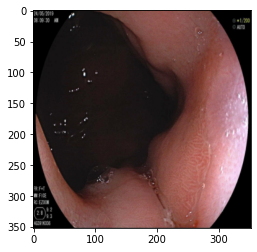

In [ ]:
plt.imshow(image.squeeze().permute(1, 2, 0).cpu().numpy())

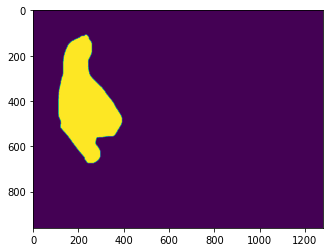

In [ ]:
from PIL import Image
for i in range(test_loader.size):
    image, gt, name = test_loader.load_data()
    # print(type(gt))
    # gt.show()
    plt.imshow(gt)
    # ImageShow.show(gt)
    break

In [ ]:
# Load checkpoint
print('| Resuming from checkpoint...')
# assert os.path.isdir('checkpoint'), 'Error: No checkpoint directory found!'
# _, file_name = getNetwork(args)
checkpoint = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth')
model.load_state_dict(checkpoint['model'])
best = checkpoint['acc']
start_epoch = checkpoint['epoch']

class test_dataset:
    def __init__(self, image_root, gt_root, testsize):
        self.testsize = testsize
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor()])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)
        self.index = 0

    def load_data(self):
        image = self.rgb_loader(self.images[self.index])
        image = self.transform(image).unsqueeze(0)
        gt = self.binary_loader(self.gts[self.index])
        name = self.images[self.index].split('/')[-1]
        # if name.endswith('.jpg'):
        #     name = name.split('.jpg')[0] + '.png'
        self.index += 1
        return image, gt, name

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('L')

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        # if image.shape[0] == 3:
        #     image = image.transpose([1, 2, 0])
        plt.imshow(image)
    plt.show()

test_image_root = '/content/Train/'
test_mask_root = '/content/GT/train/'
test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
dice = 0.0
IOU = 0.0
for i in range(test_loader.size):
    image, gt, name = test_loader.load_data()
    image = image.cuda()

    res = model(image)
    res = F.upsample(res, size=(960, 1280), mode='bilinear', align_corners=False)
    res = res.sigmoid().data.cpu().numpy().squeeze()
    res = (res - res.min()) / (res.max() - res.min() + 1e-8)
    
    image = F.upsample(image, size=(960, 1280), mode='bilinear', align_corners=False)
    image = image.squeeze().permute(1, 2, 0).cpu().numpy()
    visualize(
      image=image, 
      ground_truth_mask=gt, 
      predicted_mask=res.round()
      # predicted_mask_erosion_with_dilation=pr_mask_er
    )

    gt = np.asarray(gt, np.float32)
    gt /= (gt.max() + 1e-8)
    # gt = gt.round()
    res = res.round()
    print("Dice = ", (2 * (gt * res).sum() + 1) / (gt.sum() + res.sum() + 1))
    print("IOU = ", ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1))
    dice += (2 * (gt * res).sum() + 1) / (gt.sum() + res.sum() + 1)
    IOU += ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1)
    
print("Mean dice = ",dice / test_loader.size)
print("Mean IOU = ",IOU / test_loader.size)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")


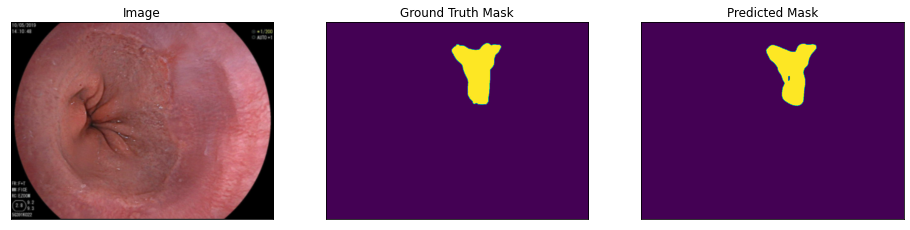

Dice =  0.9579752183183646
IOU =  0.9193411341556564


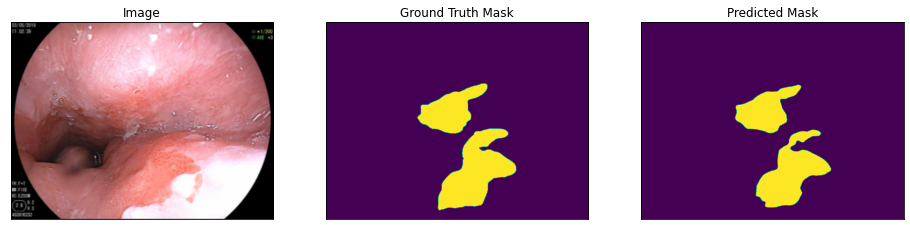

Dice =  0.925787754333989
IOU =  0.8618300179653159


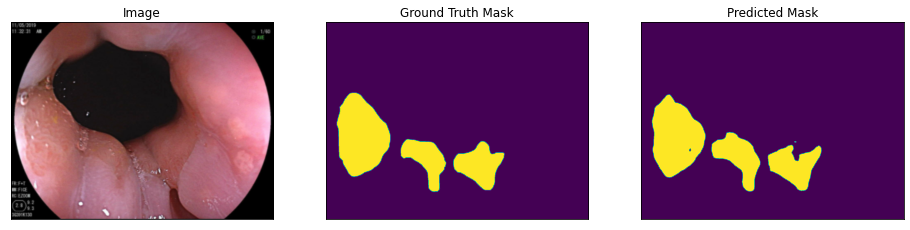

Dice =  0.9257750824706115
IOU =  0.8618079614363783


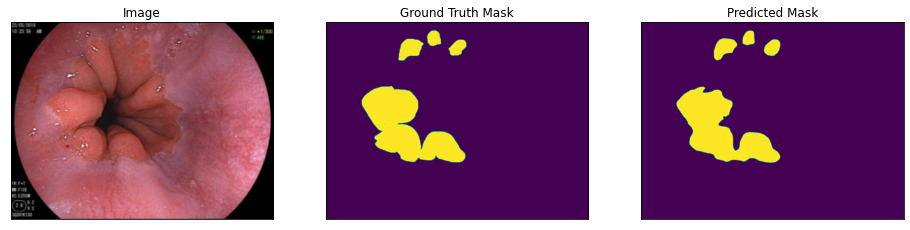

Dice =  0.940824751641936
IOU =  0.8882621306470248


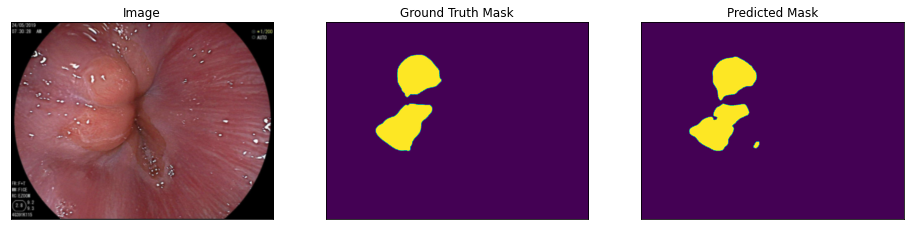

Dice =  0.9406356363840863
IOU =  0.8879253953619377


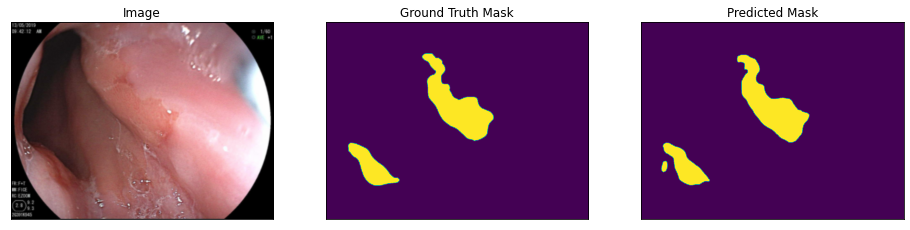

Dice =  0.9455596284493375
IOU =  0.8967413507194595


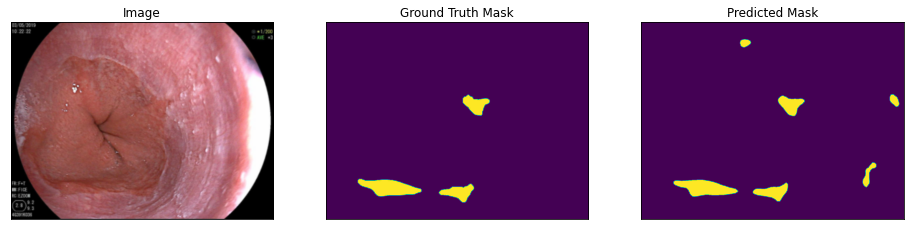

Dice =  0.8405187260365327
IOU =  0.7249126459457665


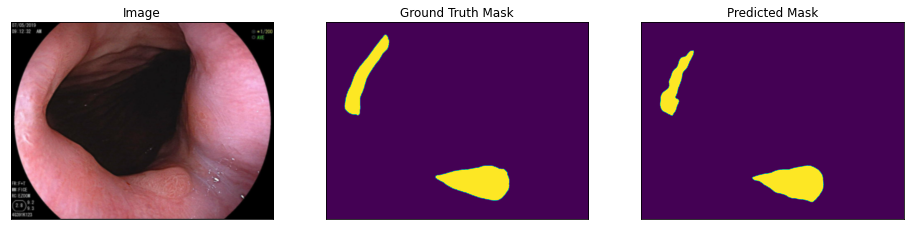

Dice =  0.898550876061232
IOU =  0.8157911429679465


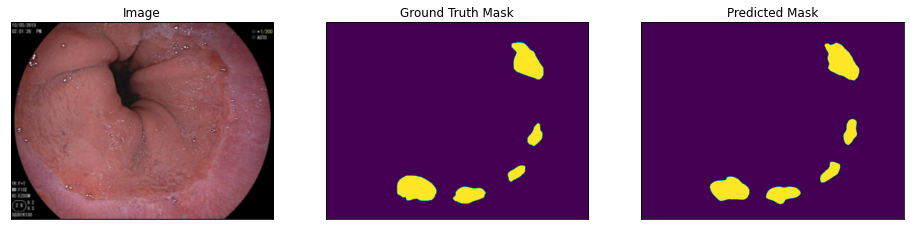

Dice =  0.8869851250348479
IOU =  0.7969228132509972


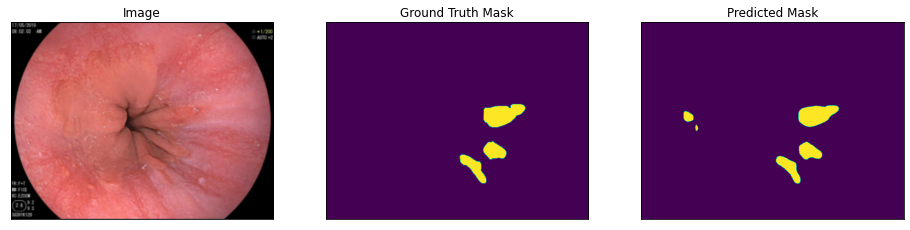

Dice =  0.8978568975176524
IOU =  0.8146491947527036


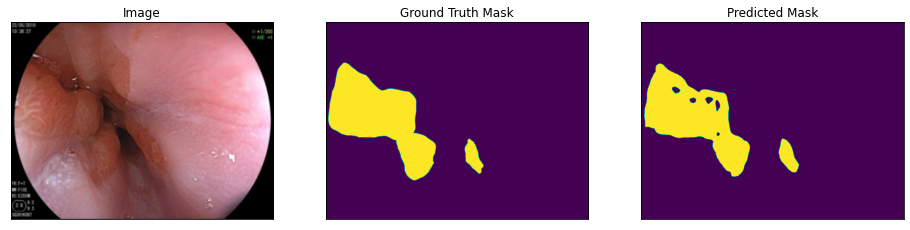

Dice =  0.9413196737427161
IOU =  0.8891447555817249


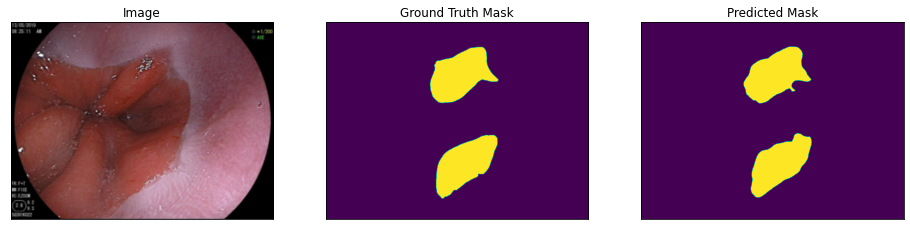

Dice =  0.9628193056168851
IOU =  0.9283046298382998


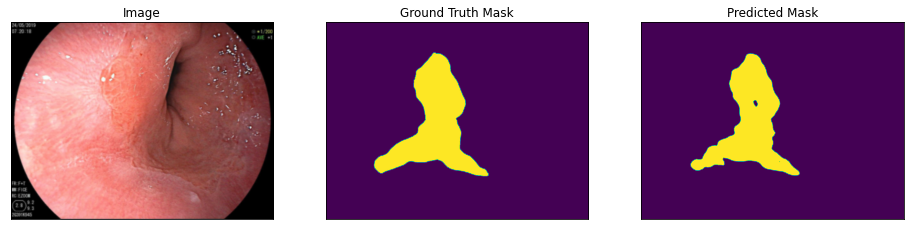

Dice =  0.9469517529820968
IOU =  0.8992485915509552


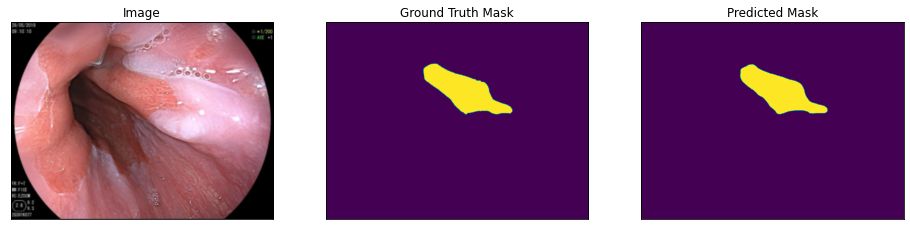

Dice =  0.9704376444753023
IOU =  0.9425735311149909


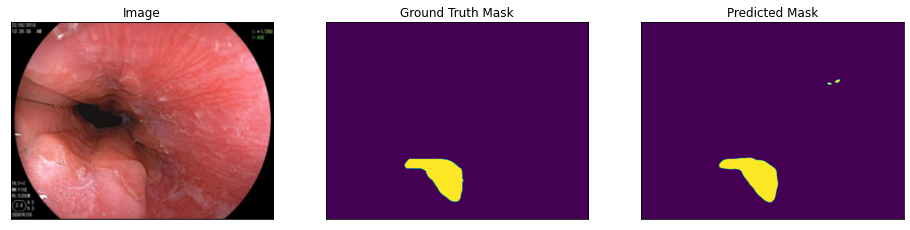

Dice =  0.9529562955184695
IOU =  0.9101412894409626


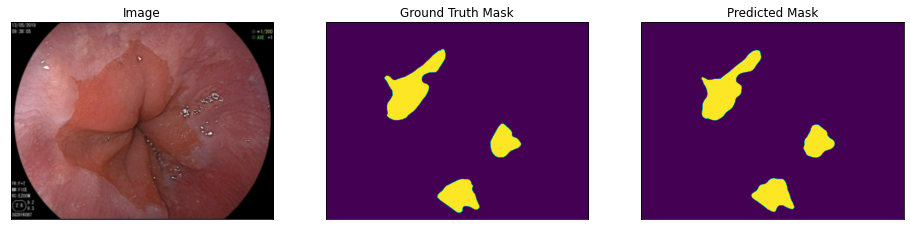

Dice =  0.9543250058403845
IOU =  0.9126407123102324


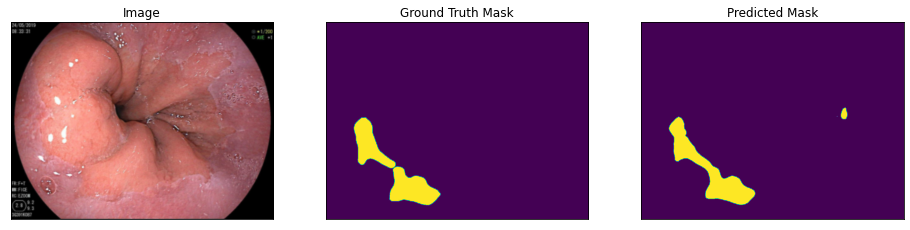

Dice =  0.9238156860344867
IOU =  0.8584190594113887


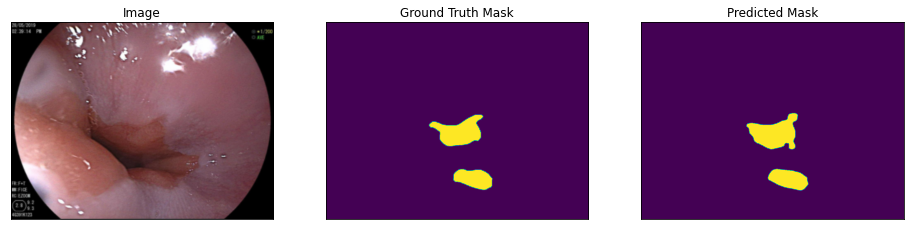

Dice =  0.9067110796647037
IOU =  0.8293446225420388


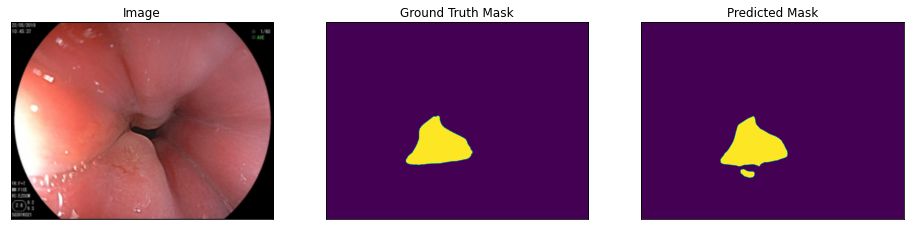

Dice =  0.9455871065619496
IOU =  0.8967912017425299


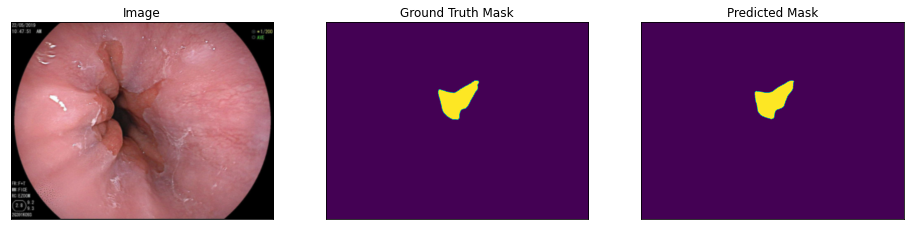

Dice =  0.9636870843973392
IOU =  0.9299207734373759


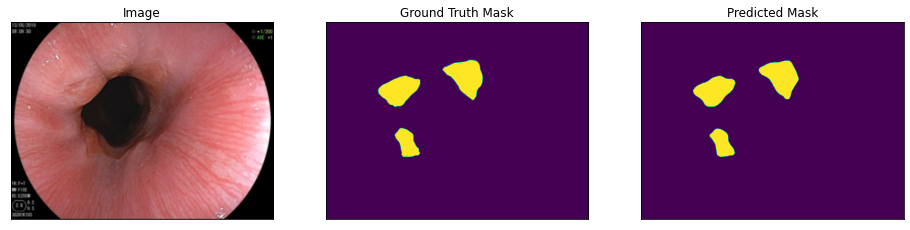

Dice =  0.970166688427033
IOU =  0.9420624061786046


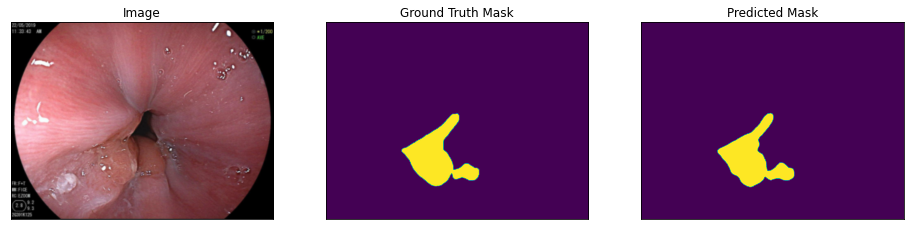

Dice =  0.9541025968735848
IOU =  0.9122342242853868


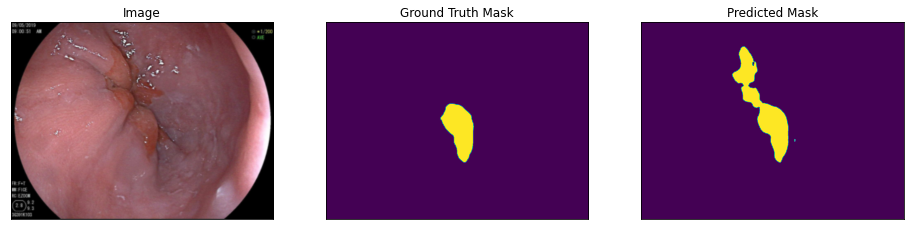

Dice =  0.6968218533662764
IOU =  0.5347143282467232


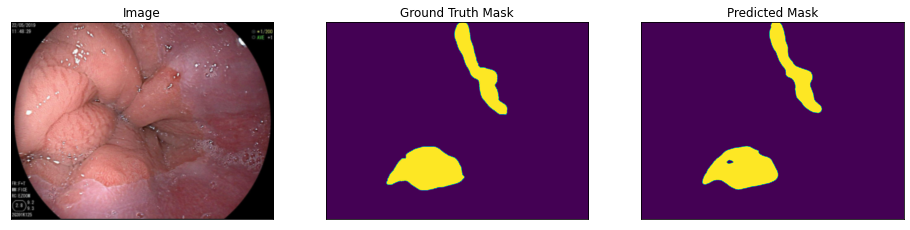

Dice =  0.9621671264482038
IOU =  0.9270929558784794


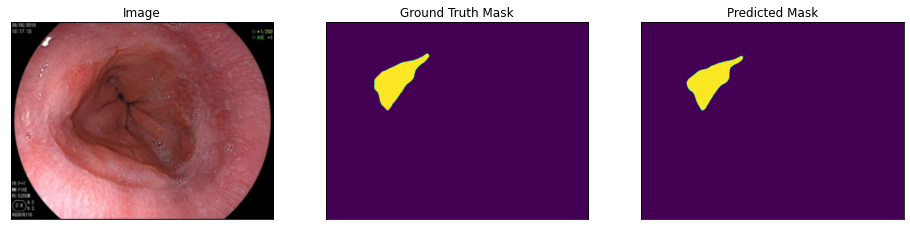

Dice =  0.9436819751900981
IOU =  0.8933708820447375


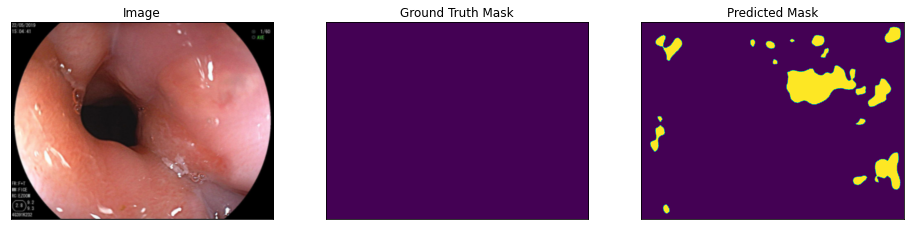

Dice =  1.0563625541922244e-05
IOU =  1.0563625541922244e-05


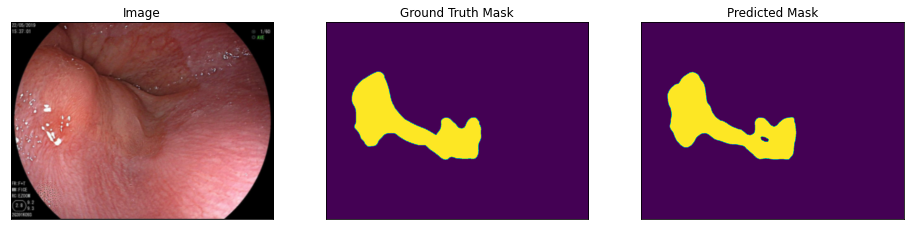

Dice =  0.9631886227985816
IOU =  0.9289914854955695


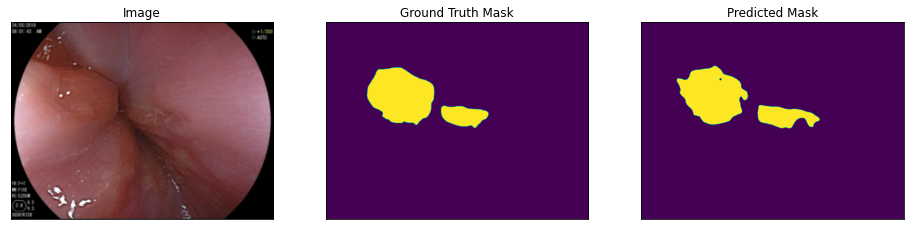

Dice =  0.9076860638591372
IOU =  0.8309763531087291


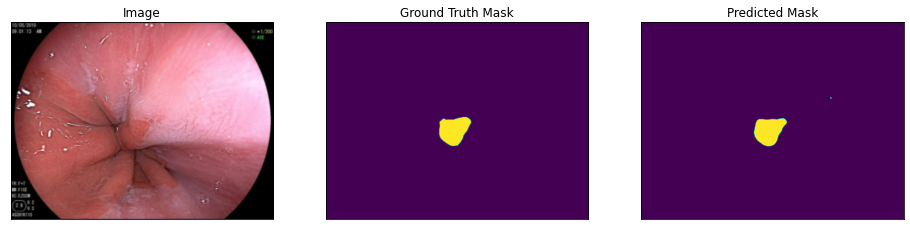

Dice =  0.9484600829375576
IOU =  0.9019753742633014


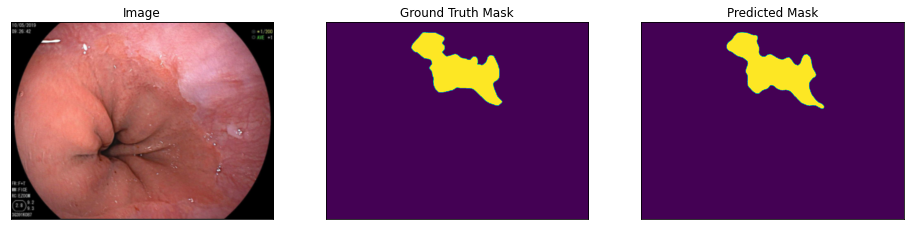

Dice =  0.9574212845898973
IOU =  0.9183209319287835


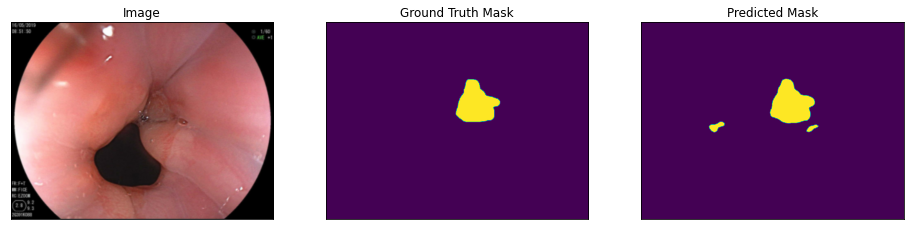

Dice =  0.9000805022747005
IOU =  0.818317510073658


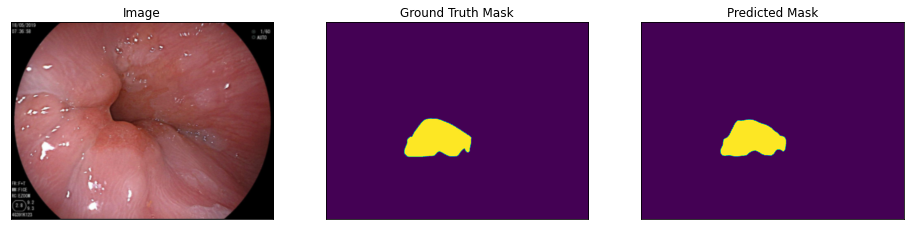

Dice =  0.9548273768076567
IOU =  0.9135604737800475


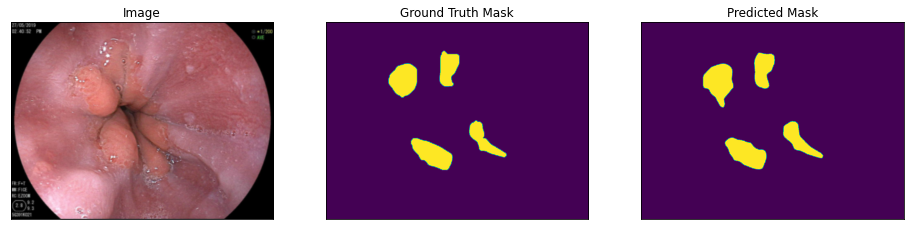

Dice =  0.9254594702234513
IOU =  0.8612616345077045


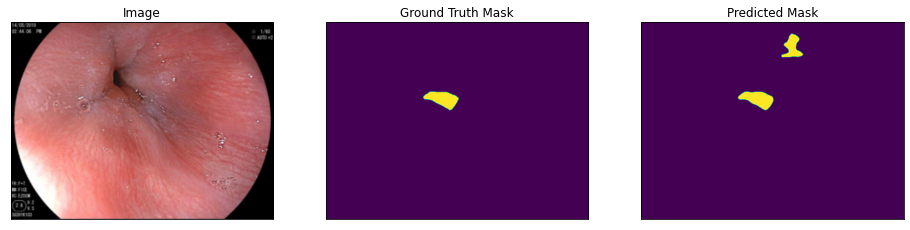

Dice =  0.7055583662328688
IOU =  0.5450816020142801


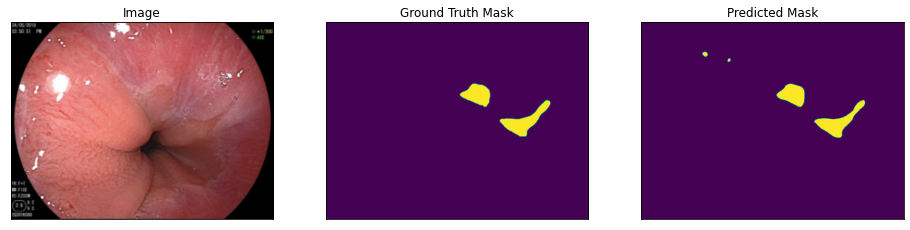

Dice =  0.9237828313362282
IOU =  0.8583636100076935


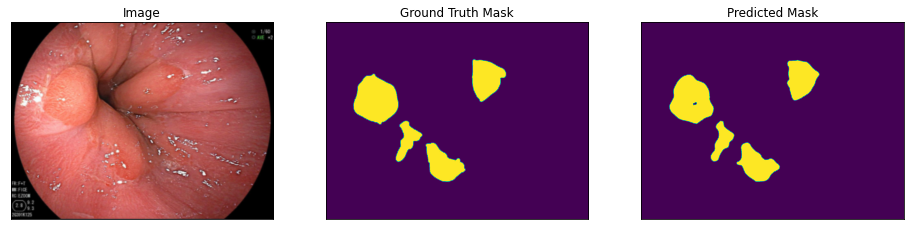

Dice =  0.9363285970738666
IOU =  0.8802805566176425


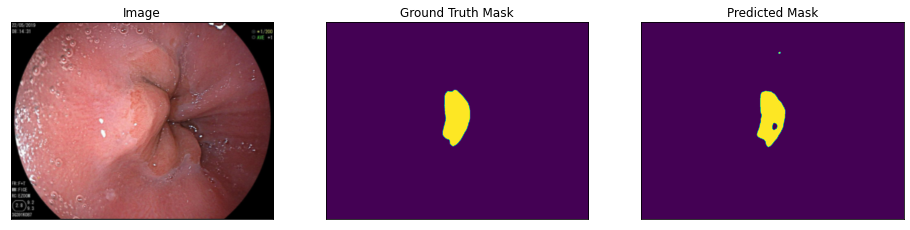

Dice =  0.9476889780918182
IOU =  0.9005806058218827


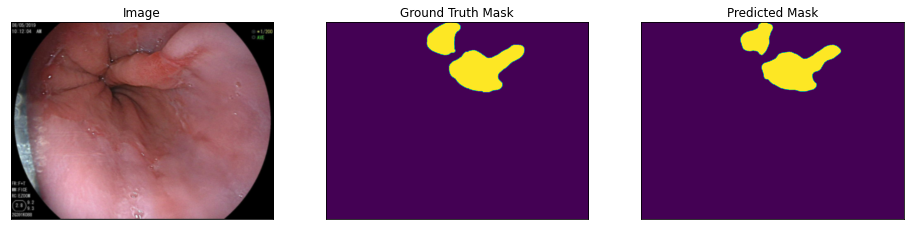

Dice =  0.9423855747598816
IOU =  0.8910491320134105


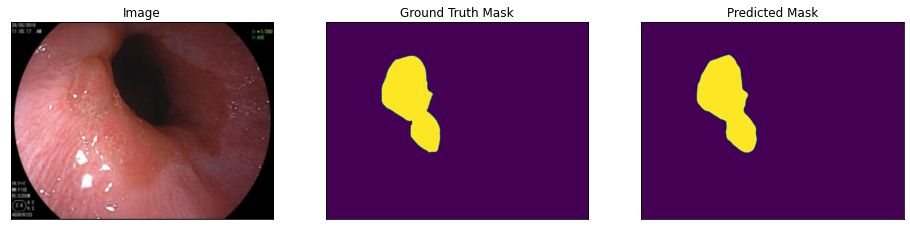

Dice =  0.9775174056757808
IOU =  0.956023792679533


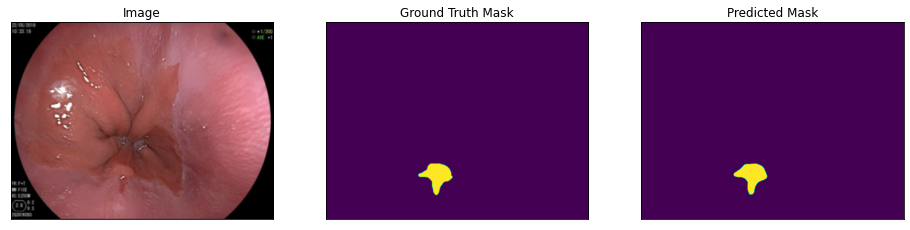

Dice =  0.9192366550059513
IOU =  0.8505491514021774


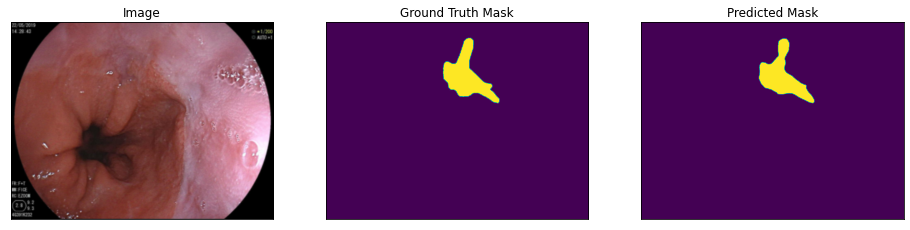

Dice =  0.9305857765379107
IOU =  0.870184483805721


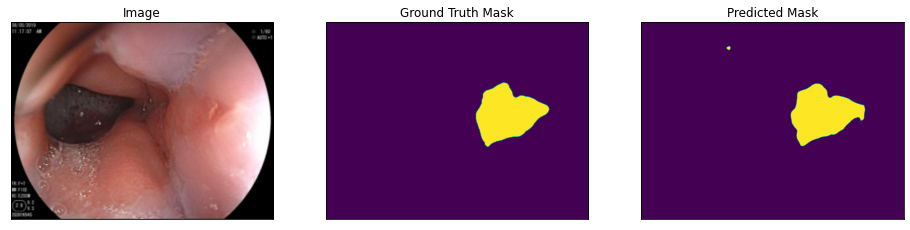

Dice =  0.9683177545928815
IOU =  0.9385818992323615


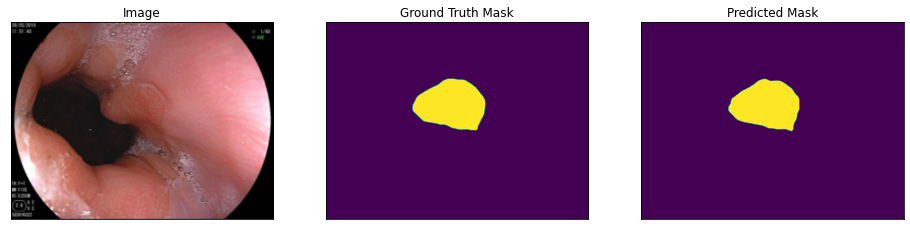

Dice =  0.9782774284144331
IOU =  0.9574788576845473


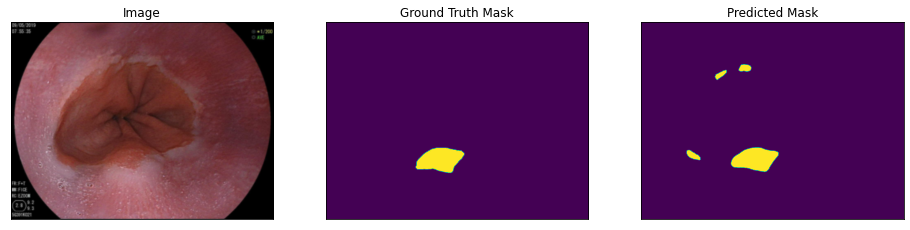

Dice =  0.8356859493345581
IOU =  0.7177550624686947


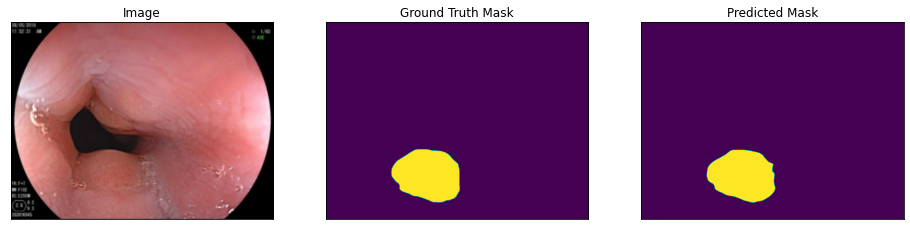

Dice =  0.9761982288528052
IOU =  0.9535035665111031


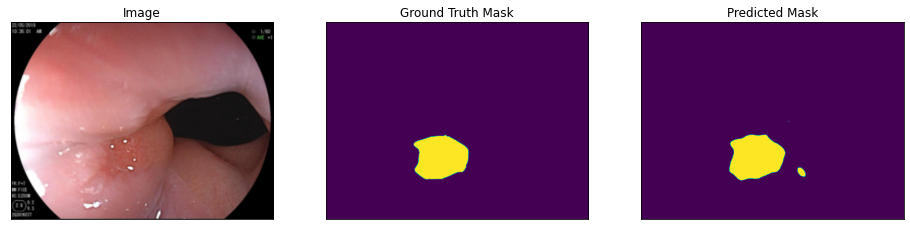

Dice =  0.9544224740498841
IOU =  0.9128193701915541


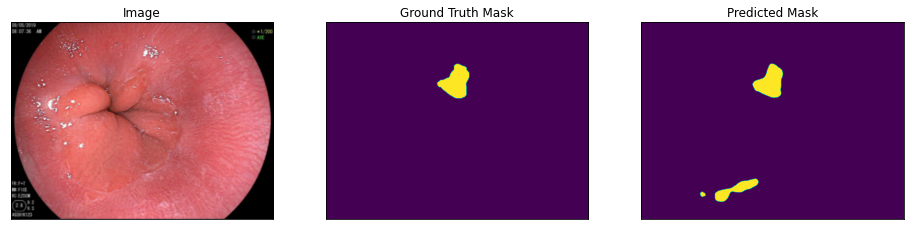

Dice =  0.7203393767365892
IOU =  0.5629227979557334


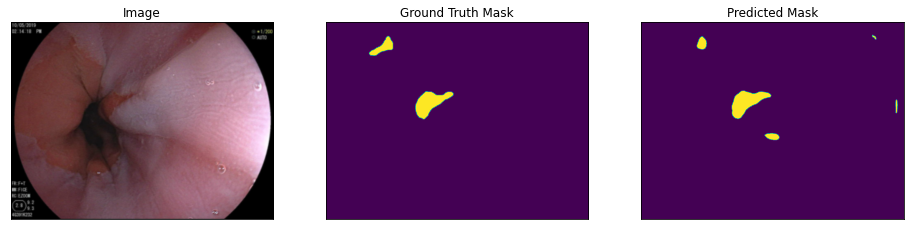

Dice =  0.7679475692694783
IOU =  0.6233159239214119


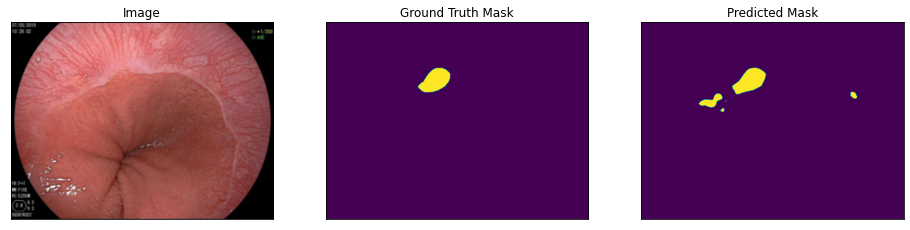

Dice =  0.7910760777474753
IOU =  0.6543732510736269


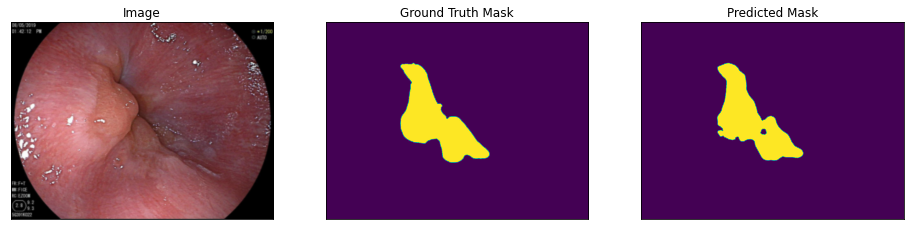

Dice =  0.9403137994439073
IOU =  0.8873517962528736


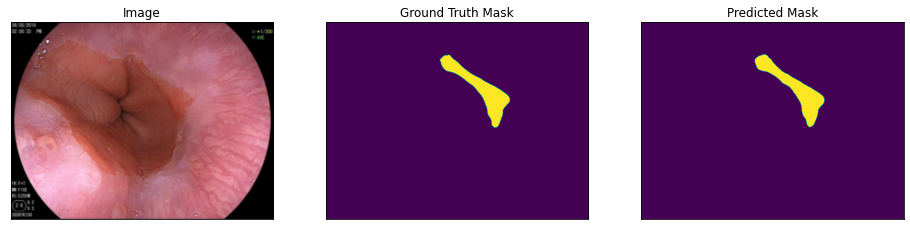

Dice =  0.9672219838104482
IOU =  0.9365255826647618


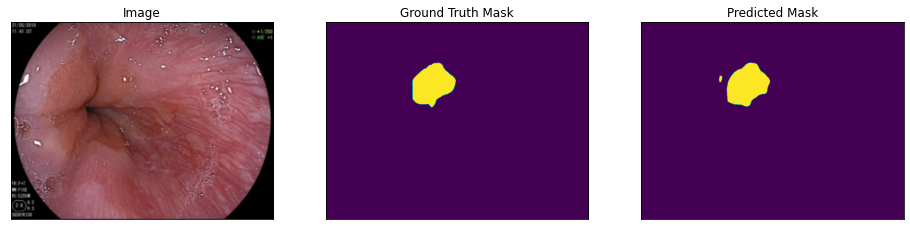

Dice =  0.9659211443695018
IOU =  0.9340895120087809


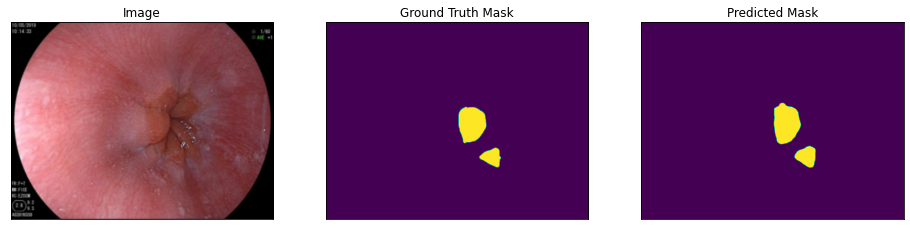

Dice =  0.9212221498684359
IOU =  0.8539523888862312


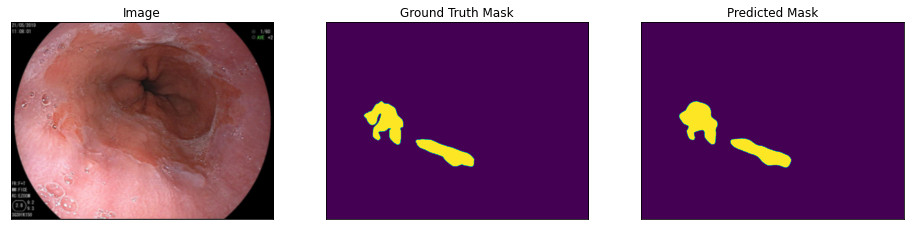

Dice =  0.9424735070559821
IOU =  0.8912068403450321


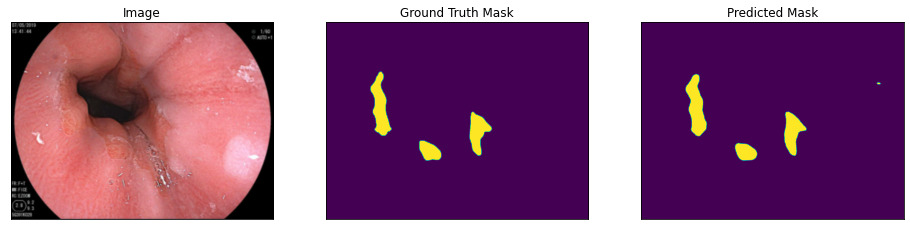

Dice =  0.9099373799720136
IOU =  0.8347590057063301


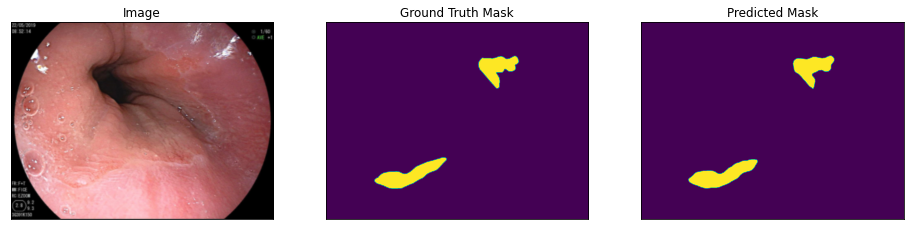

Dice =  0.9459061201024906
IOU =  0.8973654984283723


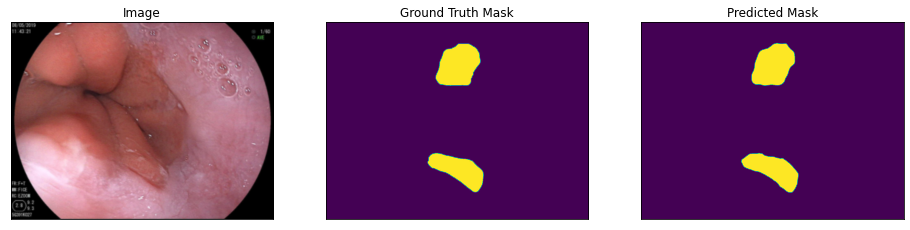

Dice =  0.9693597558018716
IOU =  0.9405418169371619


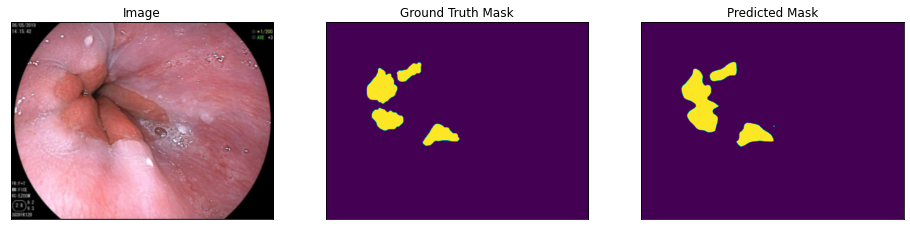

Dice =  0.8613423422208731
IOU =  0.7564564285297578


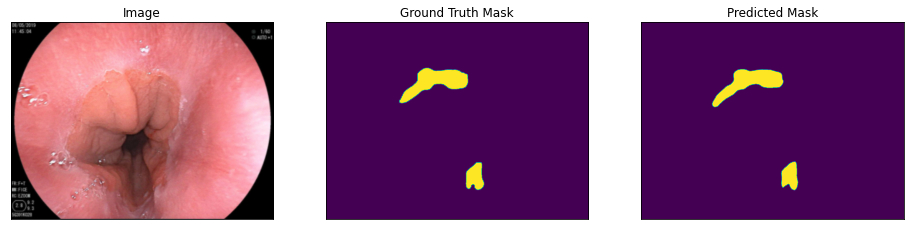

Dice =  0.9437999955389613
IOU =  0.8935822360203147


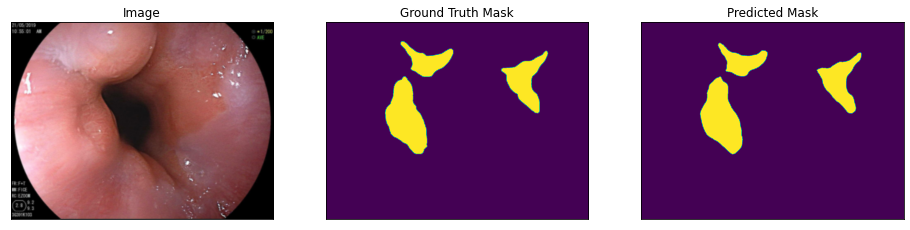

Dice =  0.9607355284014393
IOU =  0.924438349875256


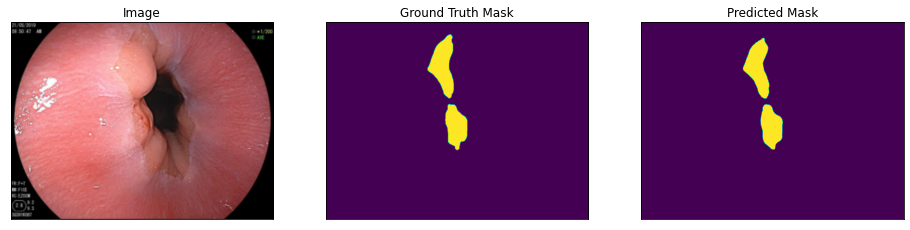

Dice =  0.9577598872976625
IOU =  0.9189446127019446


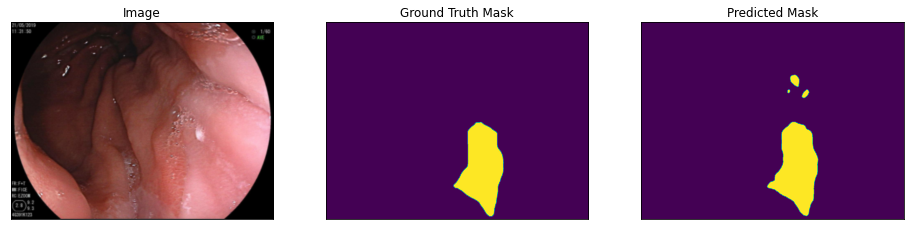

Dice =  0.951588425474445
IOU =  0.907648472244448


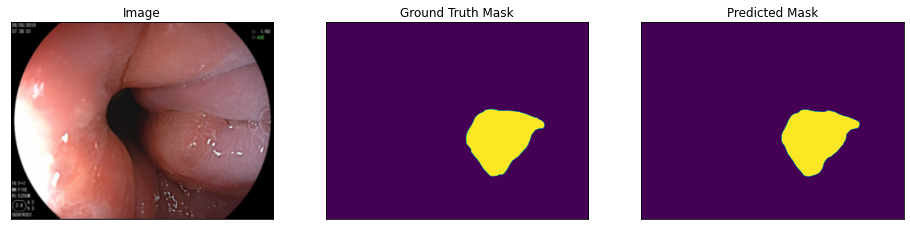

Dice =  0.9818252490556209
IOU =  0.9642995760055769


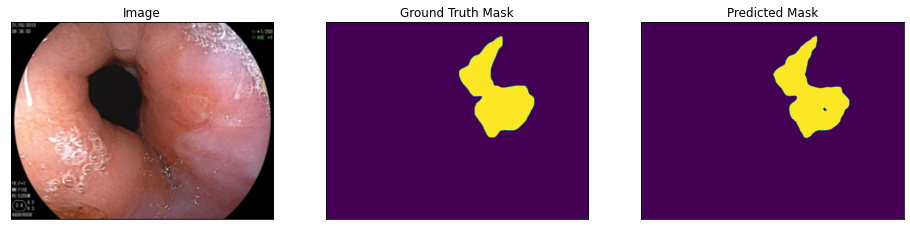

Dice =  0.9756194957075529
IOU =  0.9523997987989743


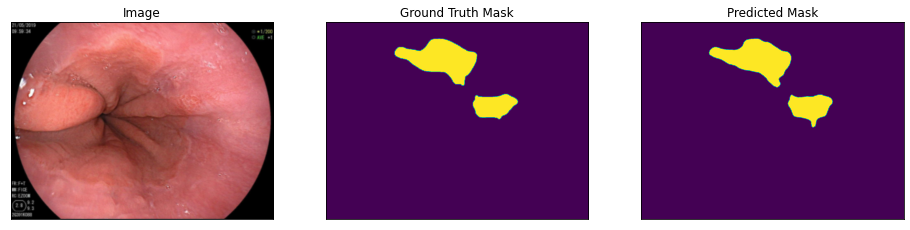

Dice =  0.9511333383110164
IOU =  0.9068206788163492


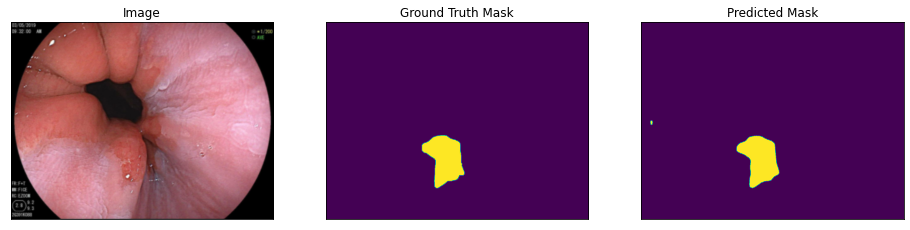

Dice =  0.9671160421989005
IOU =  0.9363269360765367


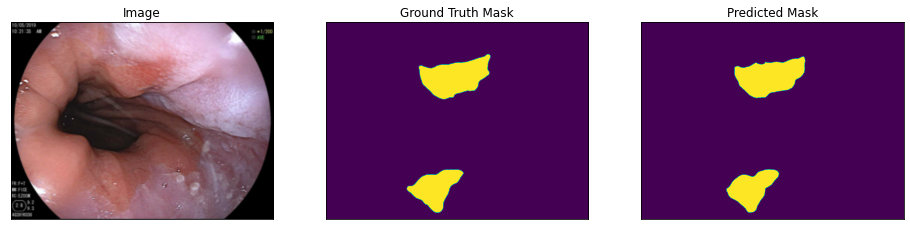

Dice =  0.9513600457294971
IOU =  0.9072328983397884


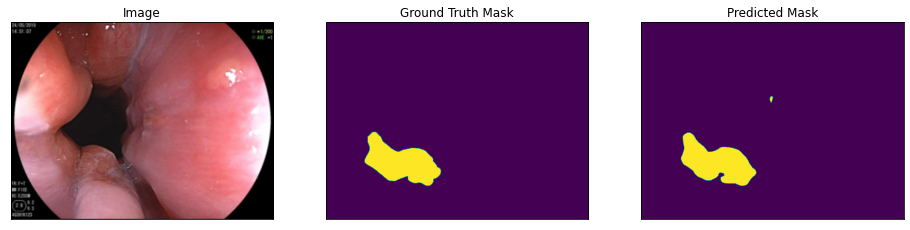

Dice =  0.9574981978253464
IOU =  0.9184626501875646


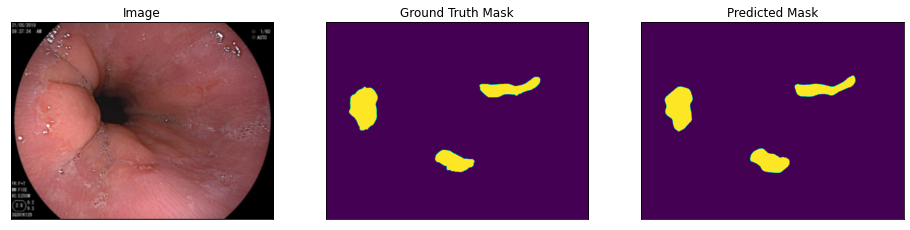

Dice =  0.9490898997855636
IOU =  0.9031132917098735


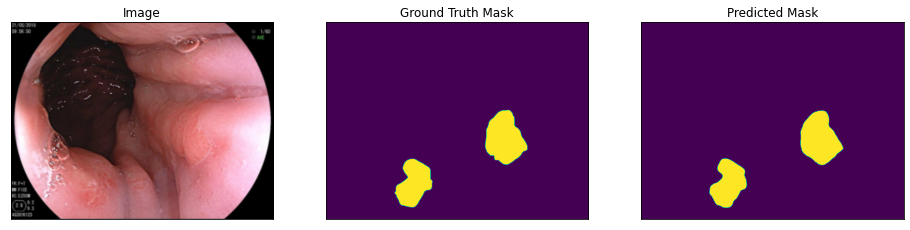

Dice =  0.9713560738319587
IOU =  0.9443078212785625


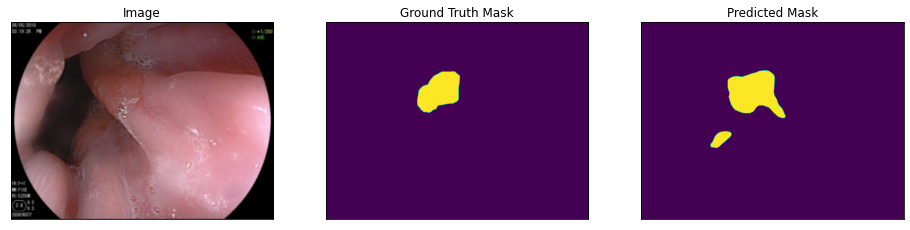

Dice =  0.7741016069010991
IOU =  0.6314605255314069


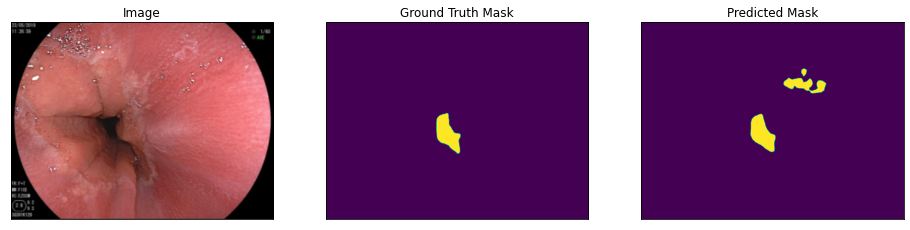

Dice =  0.6979808052584814
IOU =  0.5360854074327188


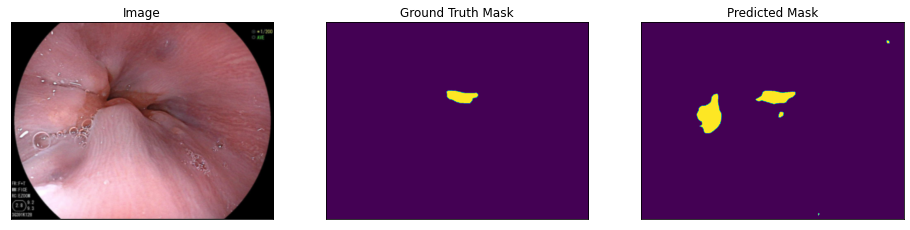

Dice =  0.4109542035098012
IOU =  0.2586318680460493


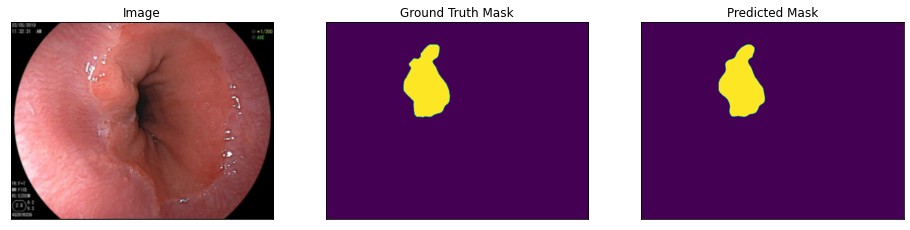

Dice =  0.9791925437393357
IOU =  0.959233734794278


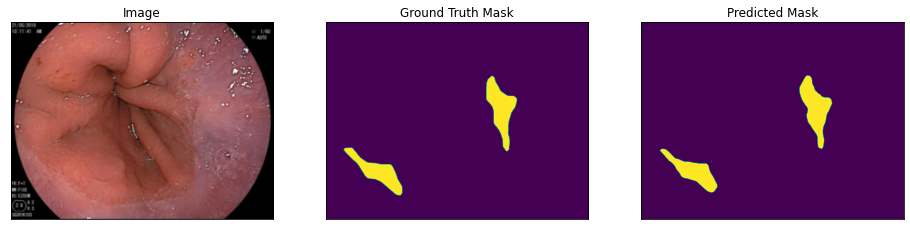

Dice =  0.9278656813459062
IOU =  0.8654392729114126


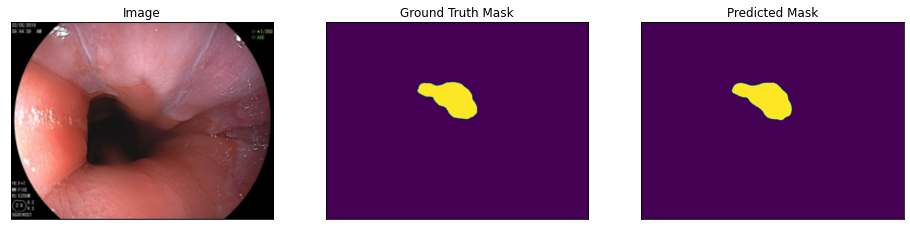

Dice =  0.9720409360727044
IOU =  0.9456036533330221


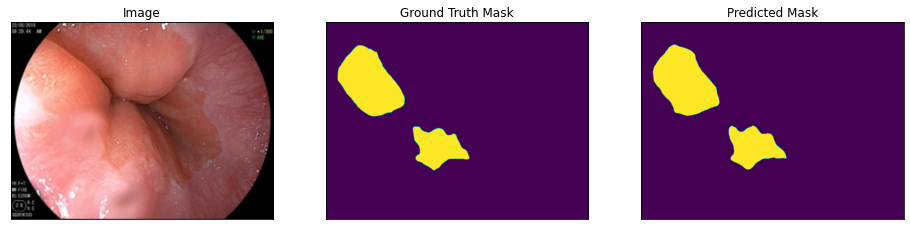

Dice =  0.9646290826178233
IOU =  0.9316751959224518


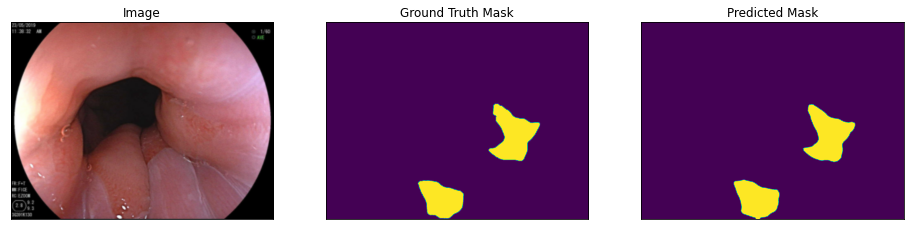

Dice =  0.9700555244960942
IOU =  0.9418526820343429


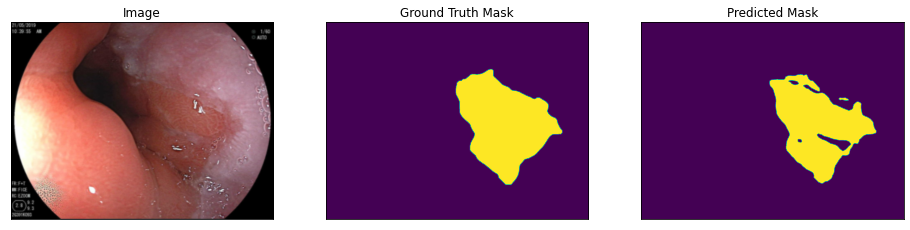

Dice =  0.9182571672711836
IOU =  0.8488687368103708


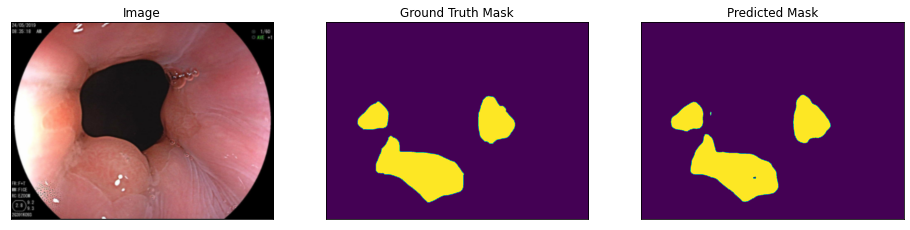

Dice =  0.967572501235491
IOU =  0.9371822930241027


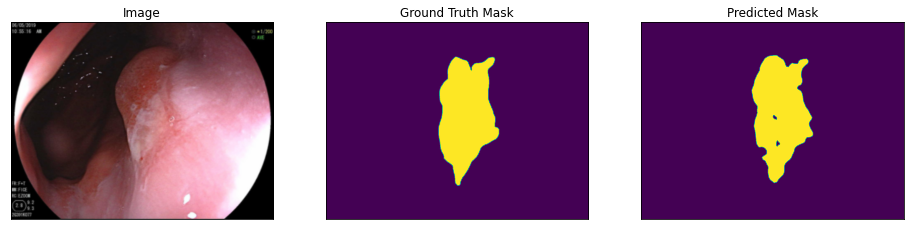

Dice =  0.936986917982423
IOU =  0.8814448584007774


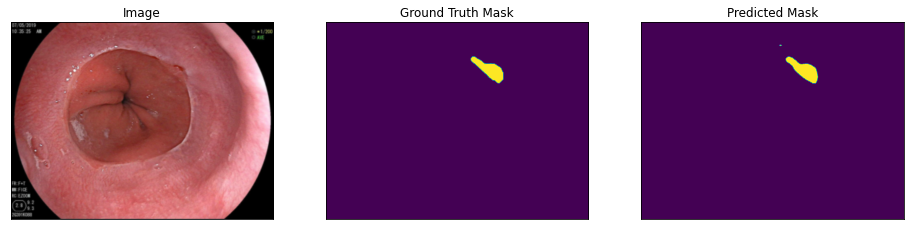

Dice =  0.8932591762587588
IOU =  0.8071170054379703


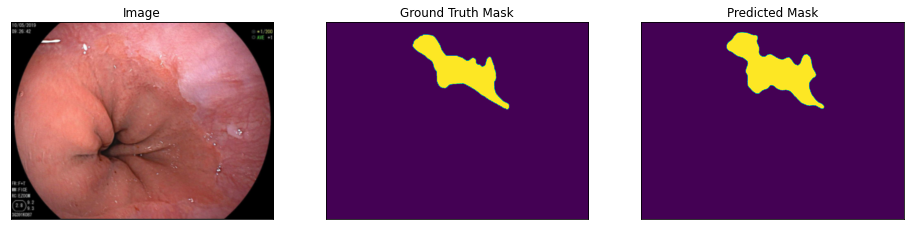

Dice =  0.8818065938899492
IOU =  0.7886008511628859


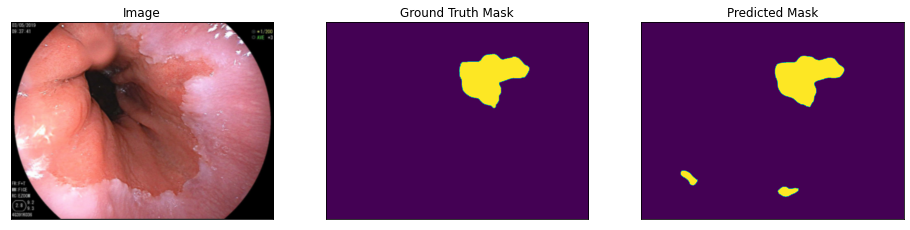

Dice =  0.9113947409248829
IOU =  0.8372146472228468


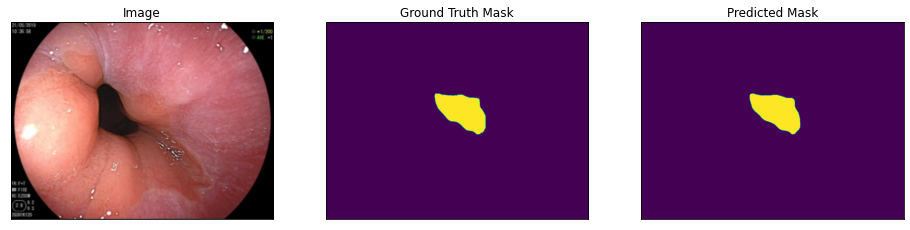

Dice =  0.980560154489527
IOU =  0.9618623040746119


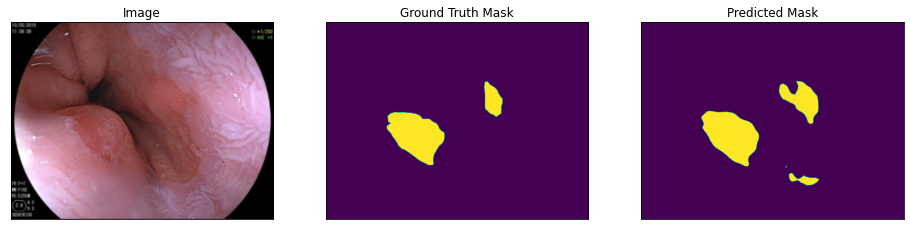

Dice =  0.8644353809966896
IOU =  0.7612400532829666


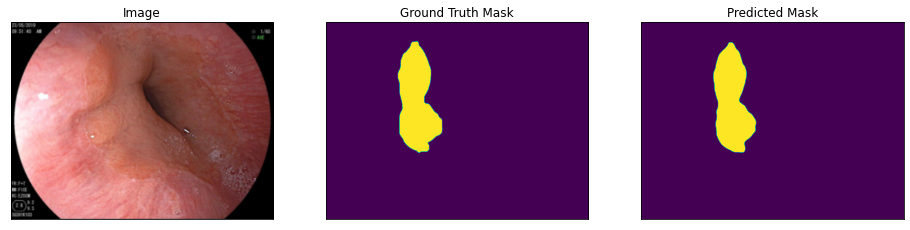

Dice =  0.9679045815381149
IOU =  0.9378057362196515


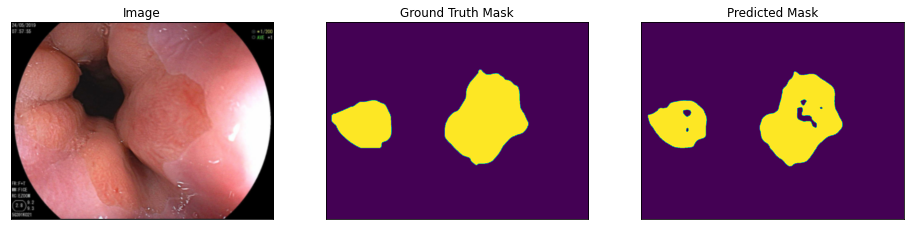

Dice =  0.9552735959295794
IOU =  0.9143770596230376


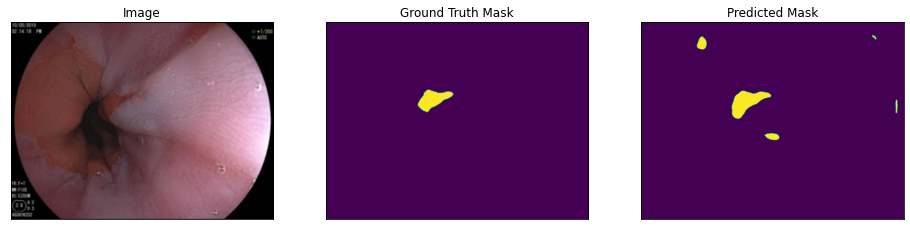

Dice =  0.6576523816505166
IOU =  0.48993997765616143


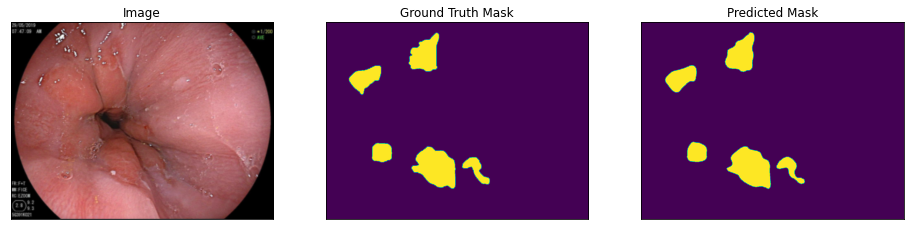

Dice =  0.9494085926780624
IOU =  0.9036902777119041


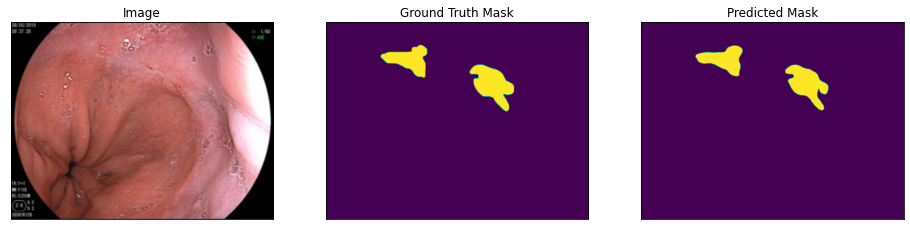

Dice =  0.9508971413260352
IOU =  0.9063917972518923


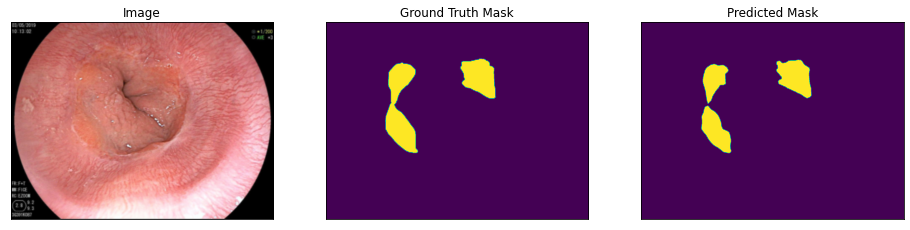

Dice =  0.9279366018559428
IOU =  0.8655623872403483


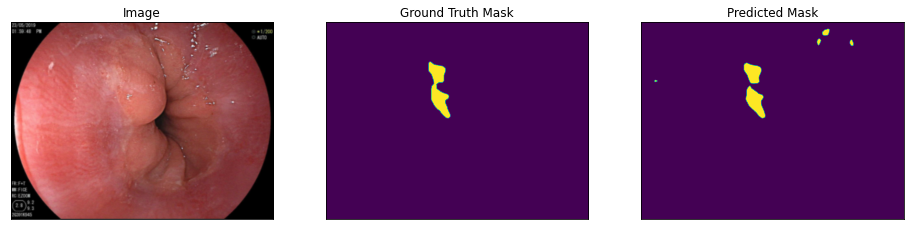

Dice =  0.7929454247401816
IOU =  0.6569343562462243


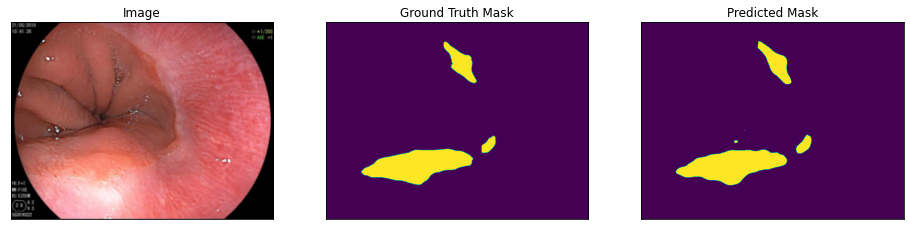

Dice =  0.9588477946538361
IOU =  0.9209492388531572


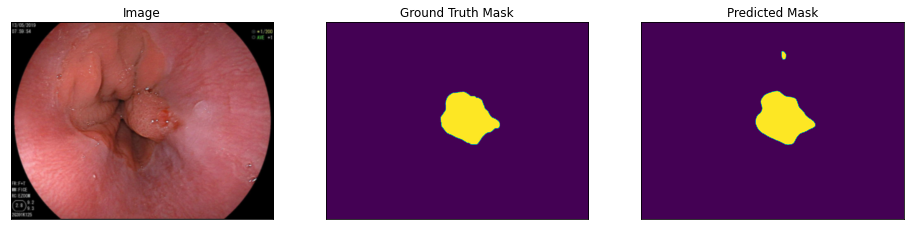

Dice =  0.973072095923866
IOU =  0.9475569193213673


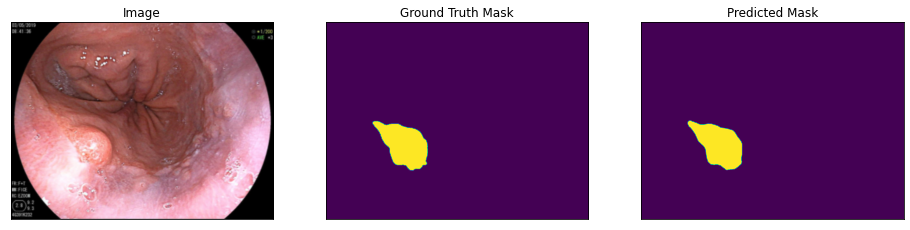

Dice =  0.9788299927465265
IOU =  0.9585382706561775


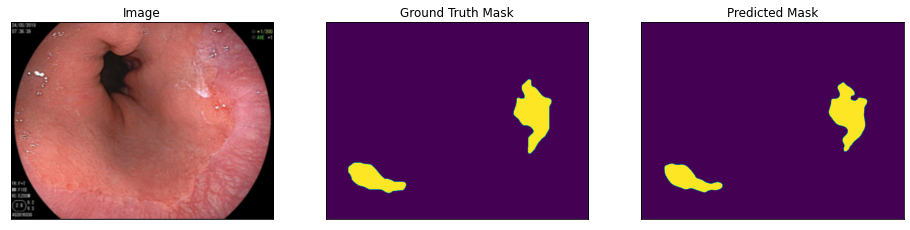

Dice =  0.9454453745461727
IOU =  0.8965361198594698


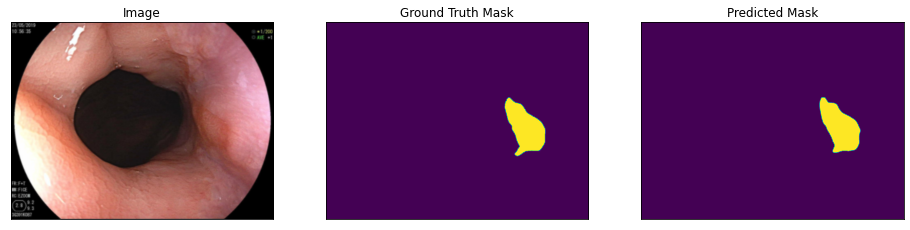

Dice =  0.9639762406191522
IOU =  0.9304587148119791


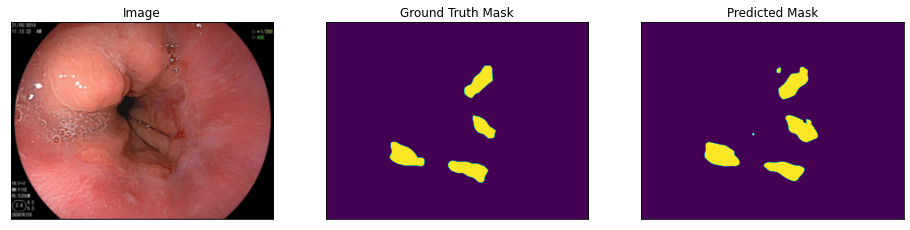

Dice =  0.8561065845523228
IOU =  0.7484170020149808


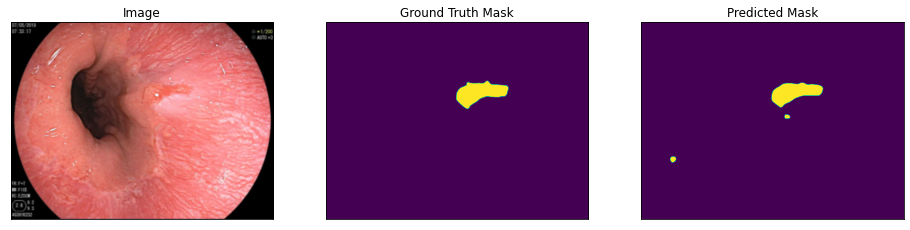

Dice =  0.9137148774021515
IOU =  0.8411410729144765


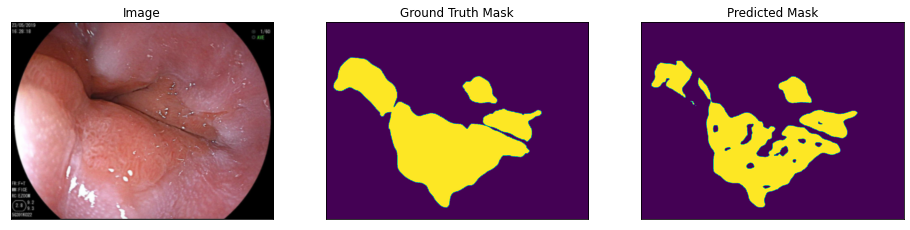

Dice =  0.8733335746616895
IOU =  0.7751487782447992


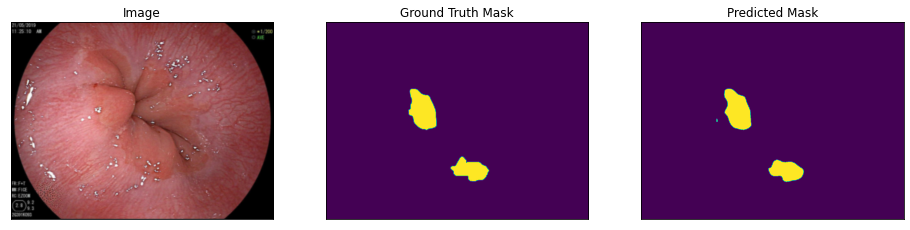

Dice =  0.9453471200070994
IOU =  0.8963600837106005


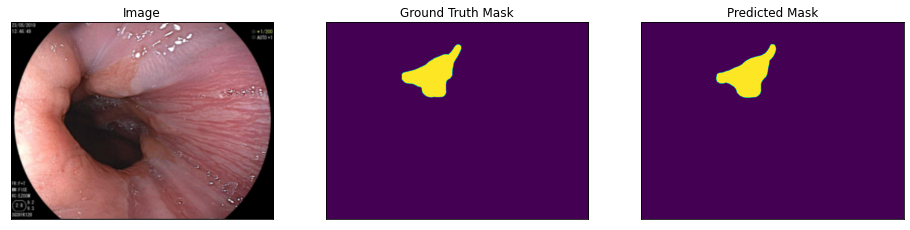

Dice =  0.9695309019107636
IOU =  0.9408644749152746


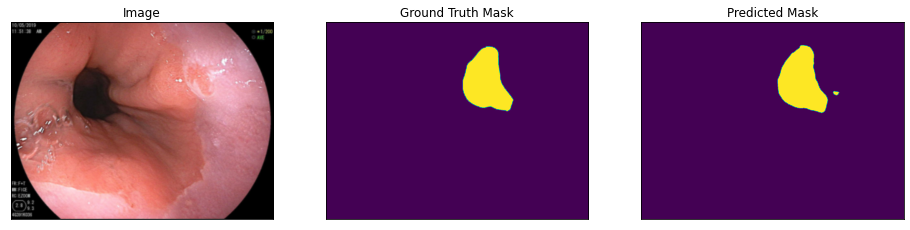

Dice =  0.9727900688331004
IOU =  0.9470221811103815


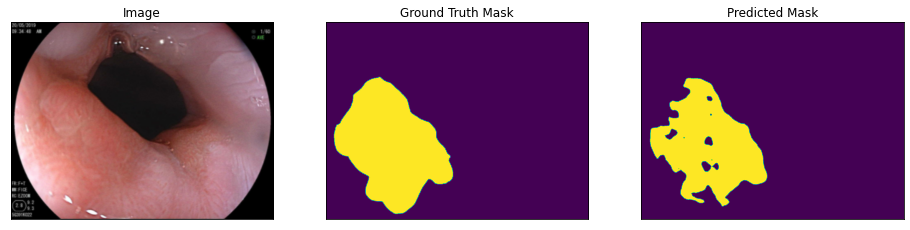

Dice =  0.9007289669745556
IOU =  0.8193879189820641


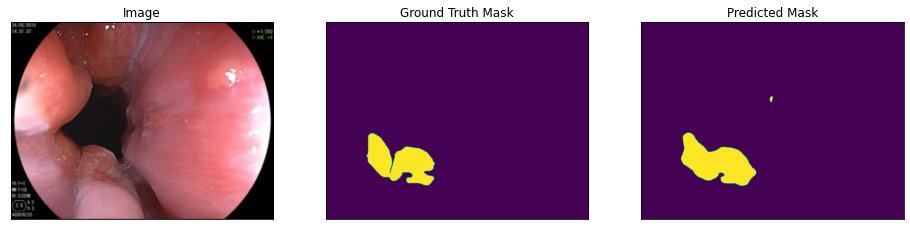

Dice =  0.9240130177225994
IOU =  0.8587598614081794


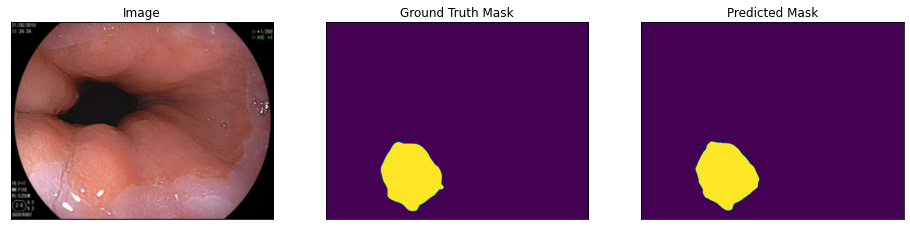

Dice =  0.9754942013852556
IOU =  0.9521610746655795


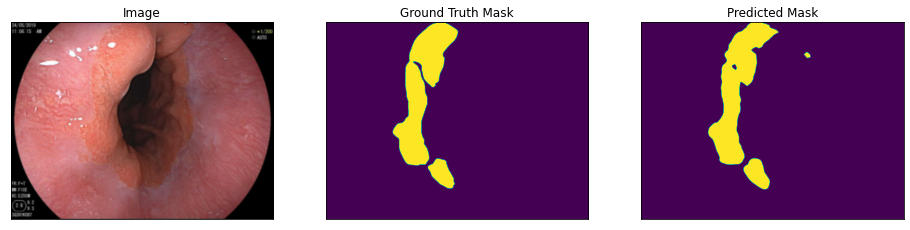

Dice =  0.9382389570140784
IOU =  0.883663547210903


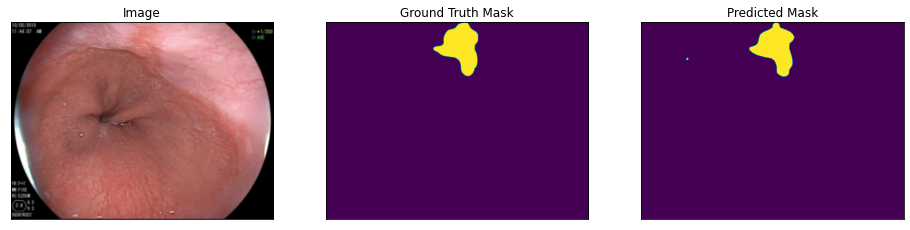

Dice =  0.9510414050832104
IOU =  0.9066543857714586


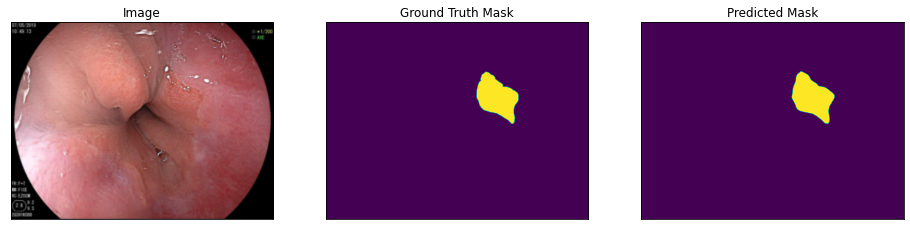

Dice =  0.974348692864085
IOU =  0.9499812453508097


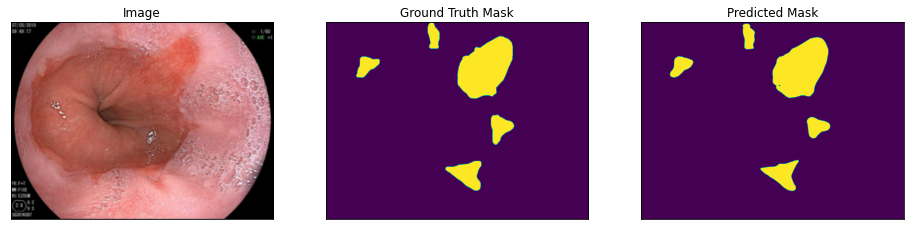

Dice =  0.9490183444821153
IOU =  0.9029832946290561


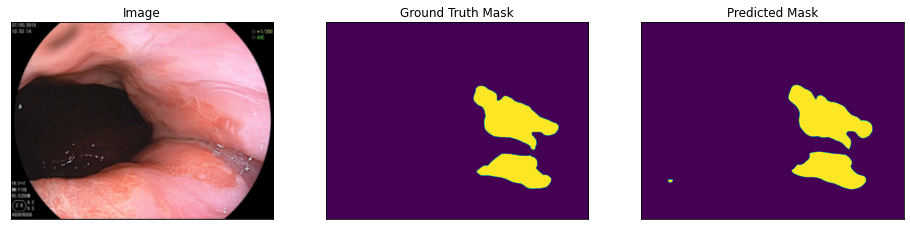

Dice =  0.9573391325930876
IOU =  0.9181696394773335


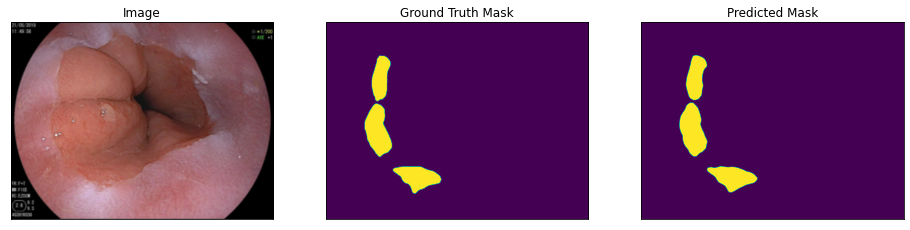

Dice =  0.9547383280798525
IOU =  0.9133972252068646


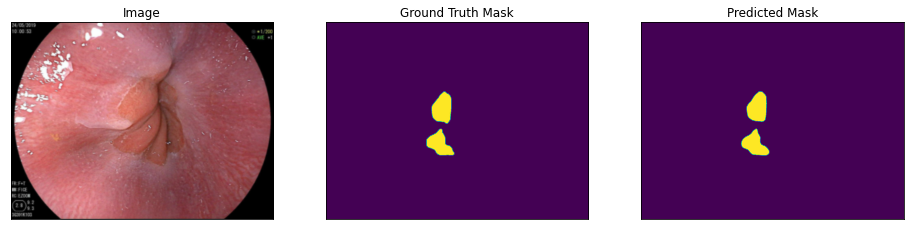

Dice =  0.9534897652980986
IOU =  0.9111156779909979


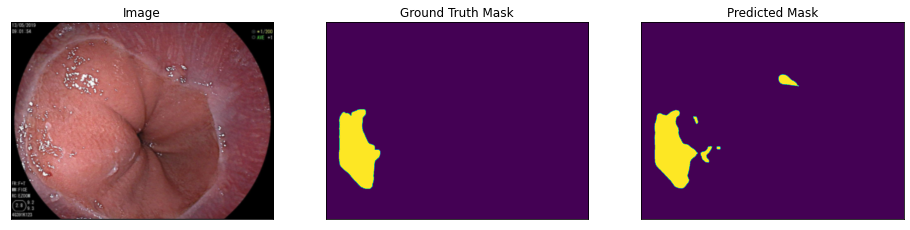

Dice =  0.9054934882090596
IOU =  0.8273090441064239


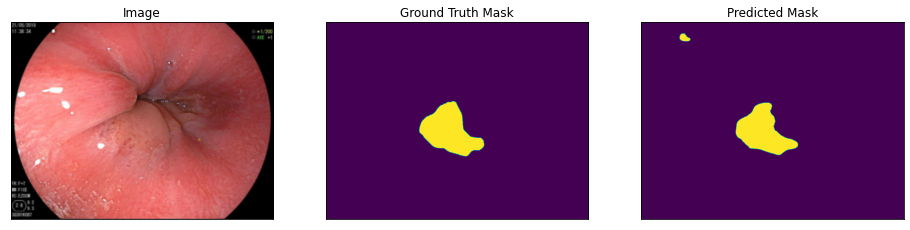

Dice =  0.9138824048356916
IOU =  0.8414228597027882


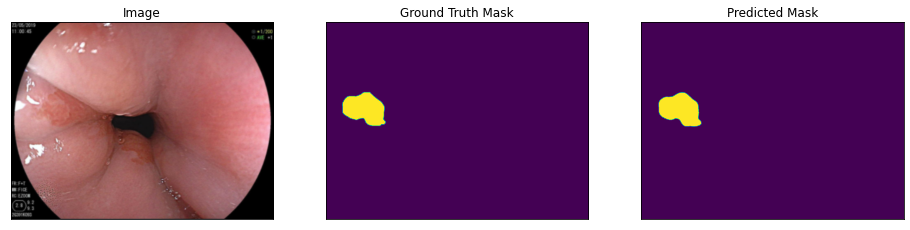

Dice =  0.9566506814639161
IOU =  0.9169051675532567


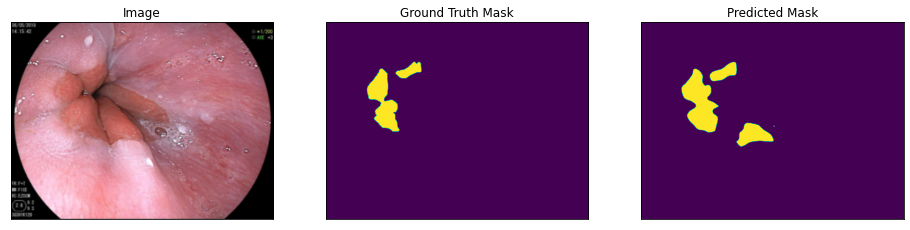

Dice =  0.7158590351104565
IOU =  0.5574656907662893


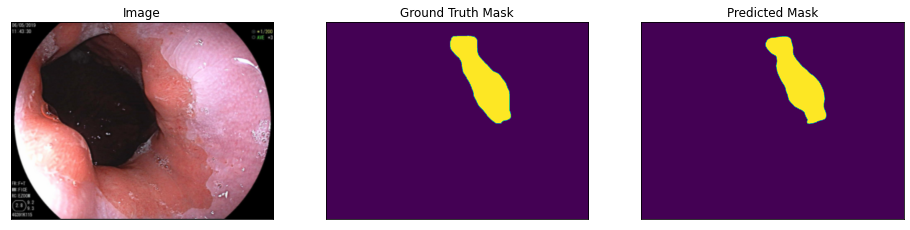

Dice =  0.9525959023002658
IOU =  0.909483440380195


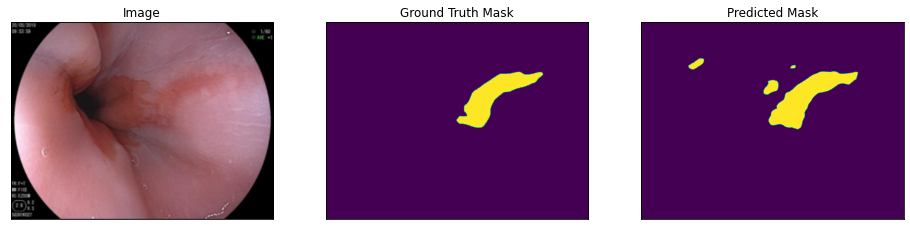

Dice =  0.8618775617070553
IOU =  0.7572824275118121


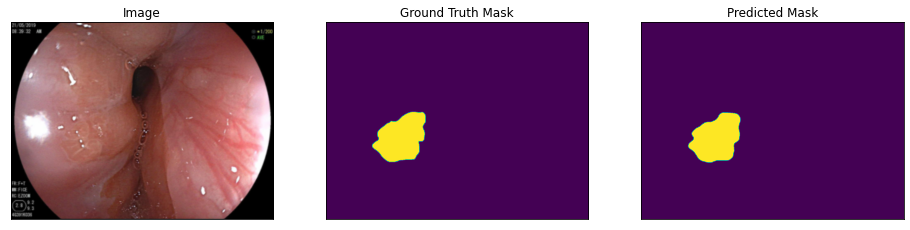

Dice =  0.9730063238072193
IOU =  0.947432243210245


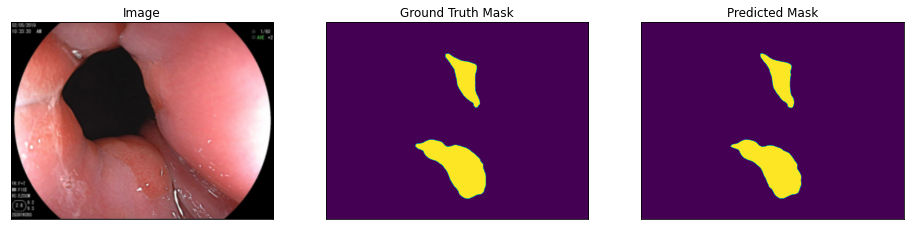

Dice =  0.9755349667716241
IOU =  0.9522387639152285


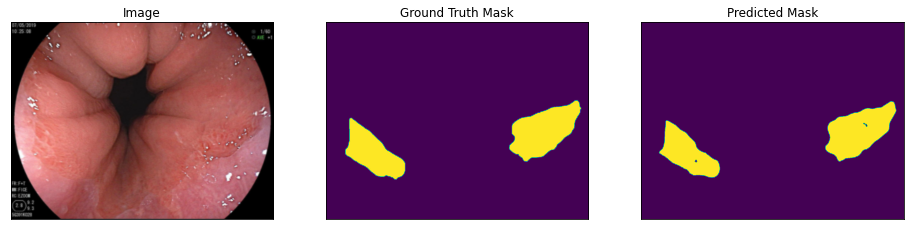

Dice =  0.9626938597331967
IOU =  0.9280714557079985


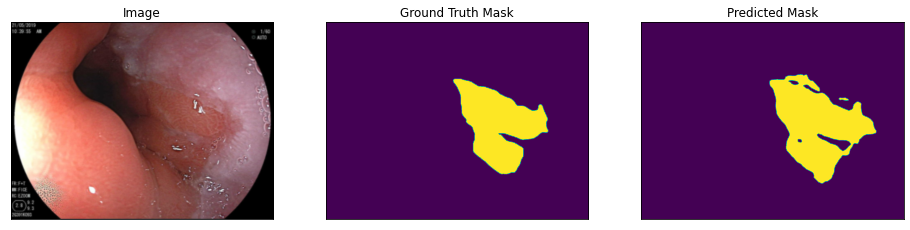

Dice =  0.8883373999977061
IOU =  0.7991077521448007


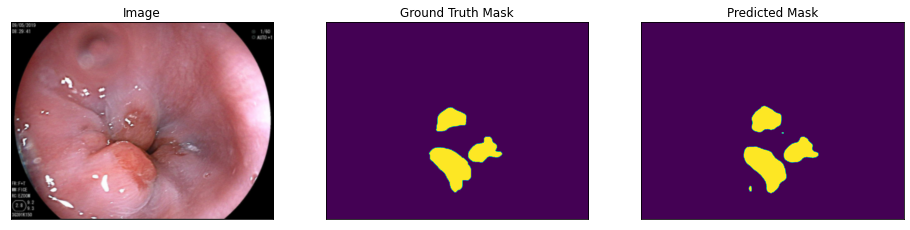

Dice =  0.9303605632552076
IOU =  0.8697901517743716


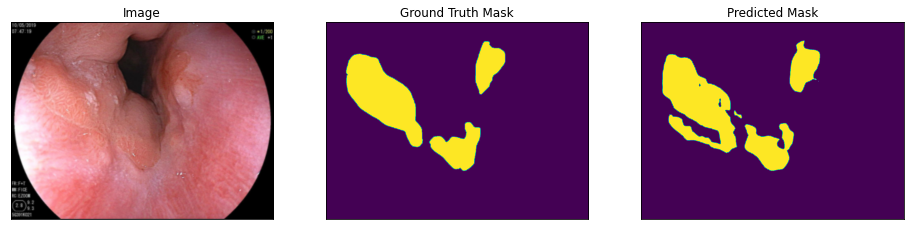

Dice =  0.8773822129666271
IOU =  0.7815509163754497


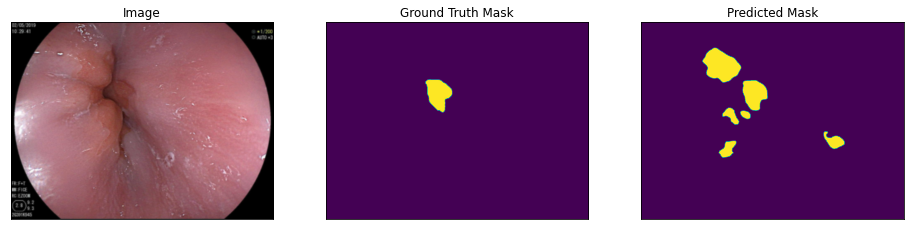

Dice =  0.40621169857912
IOU =  0.2548795165961428


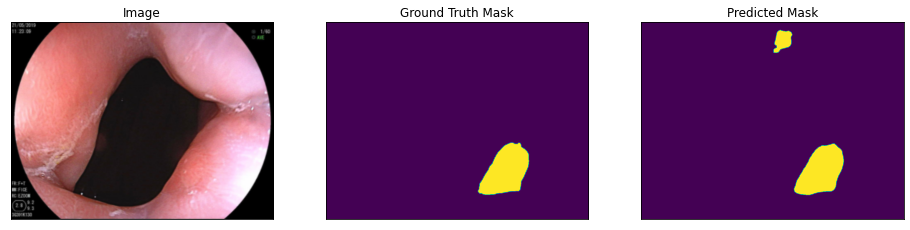

Dice =  0.9015323822885731
IOU =  0.8207200545392861


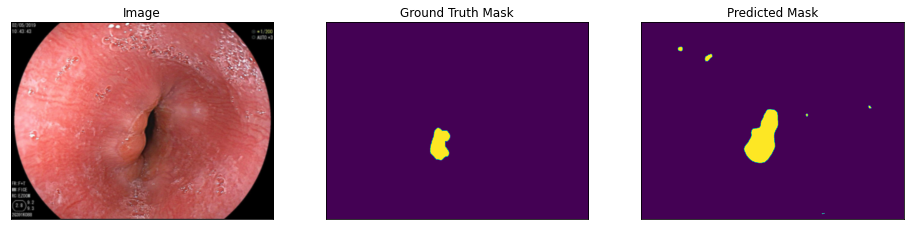

Dice =  0.48913996101738394
IOU =  0.3237603418171741


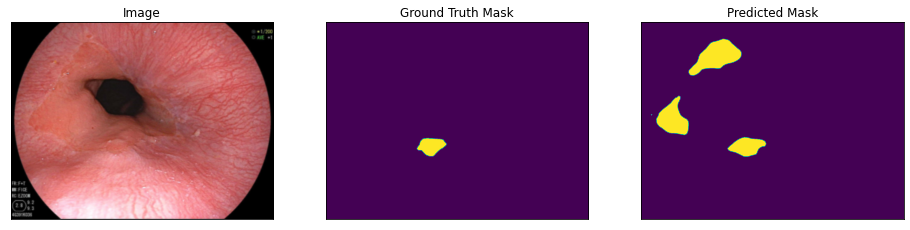

Dice =  0.272707047002759
IOU =  0.1578891035465986


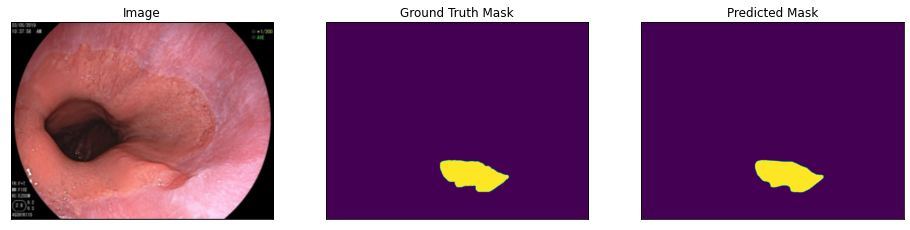

Dice =  0.9780939669955542
IOU =  0.9571277220553784


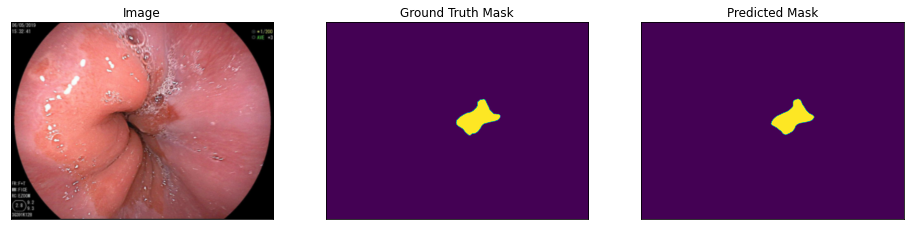

Dice =  0.9506690324702445
IOU =  0.9059788820537543


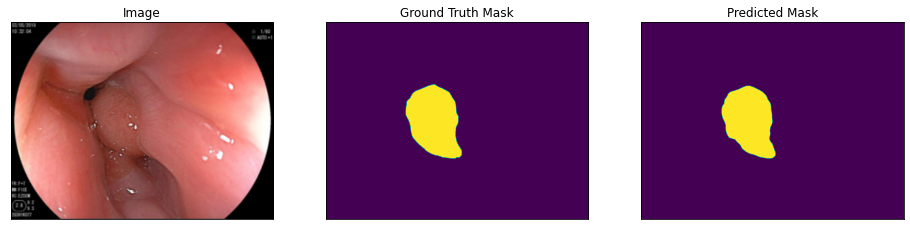

Dice =  0.9636202752025766
IOU =  0.9297950975811695


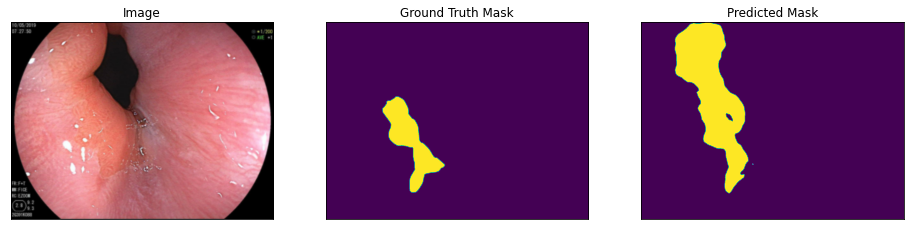

Dice =  0.4867324241368696
IOU =  0.3216457542854211


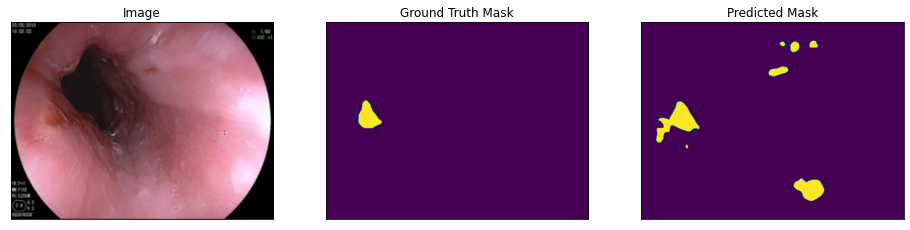

Dice =  0.40223660083511786
IOU =  0.25176012948655474


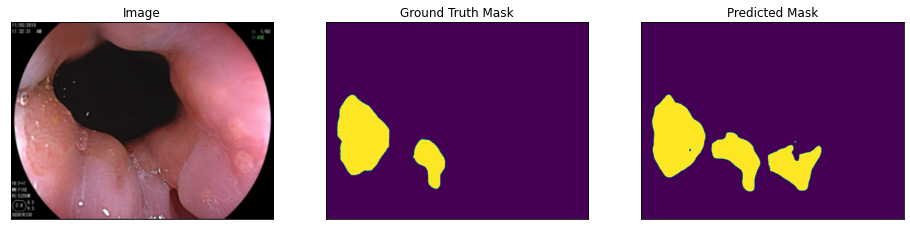

Dice =  0.7784952357960169
IOU =  0.6373260556955624


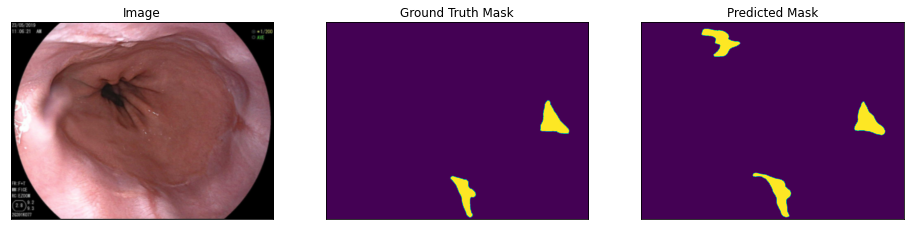

Dice =  0.7251642673245151
IOU =  0.5688354882217768


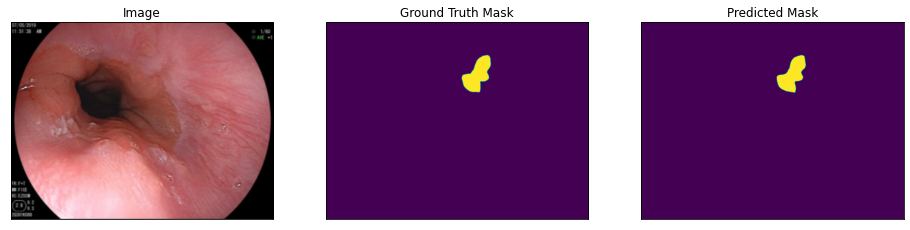

Dice =  0.9544760636412951
IOU =  0.9129193834309041


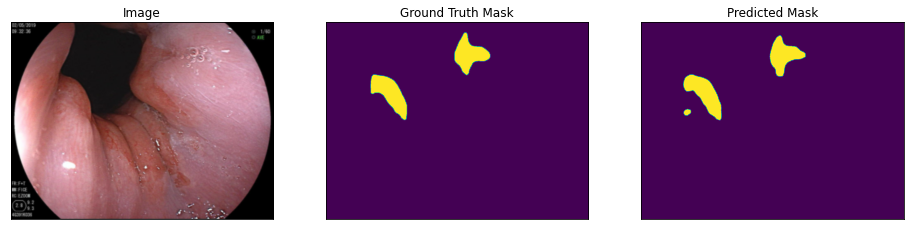

Dice =  0.9219319788565098
IOU =  0.855172316324984


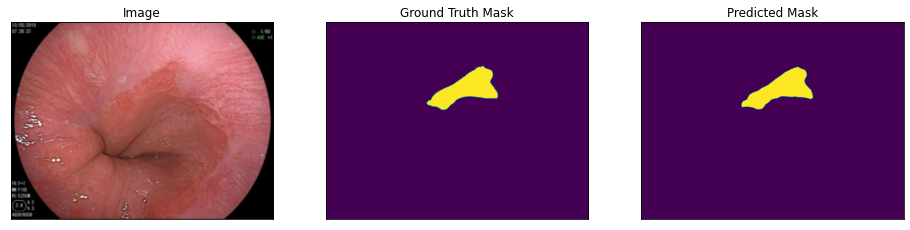

Dice =  0.9635371971058897
IOU =  0.9296408882810149


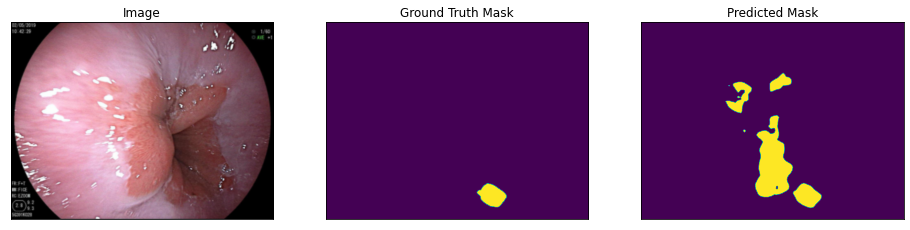

Dice =  0.2641850180077576
IOU =  0.15220275662854546


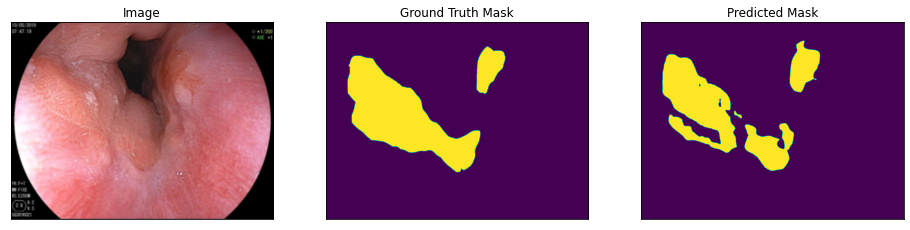

Dice =  0.8704446643692224
IOU =  0.7706088667856534


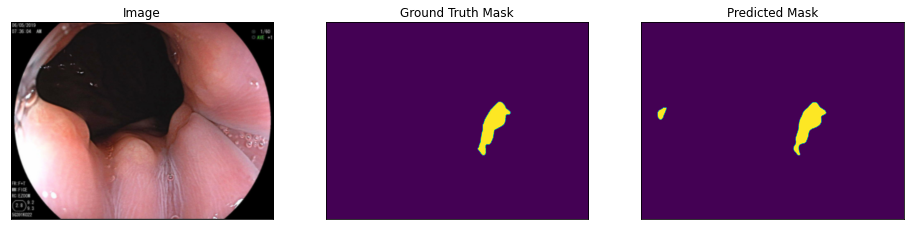

Dice =  0.8901887253119105
IOU =  0.8021131772179495


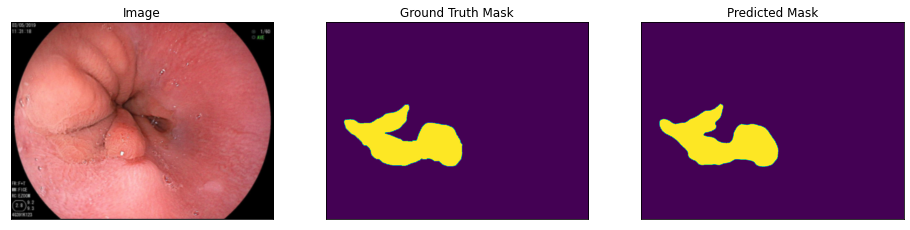

Dice =  0.9596911560889861
IOU =  0.9225064178243719


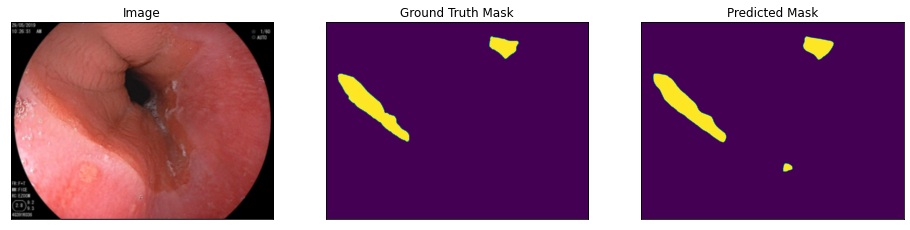

Dice =  0.9258060195310368
IOU =  0.8618626251478906


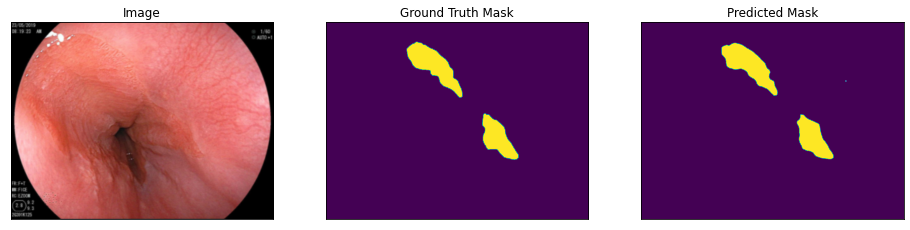

Dice =  0.9442437676376711
IOU =  0.8943776961454512


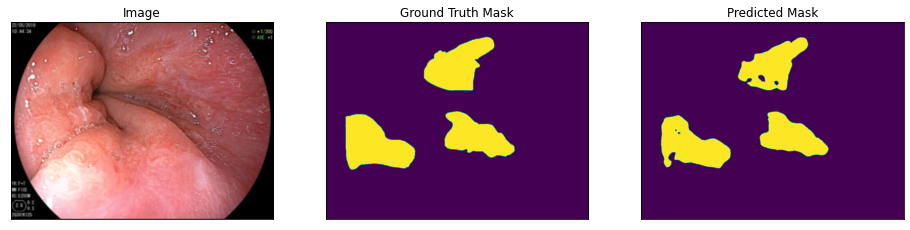

Dice =  0.9237359941005012
IOU =  0.8582805527844156


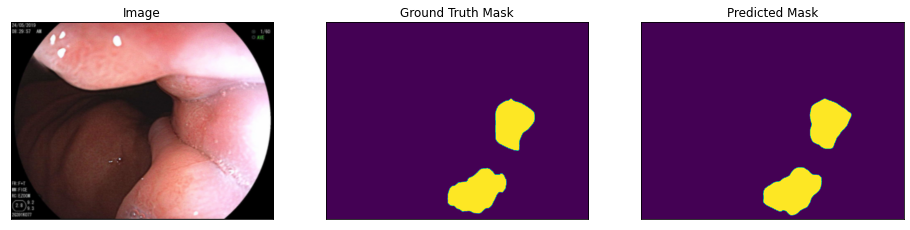

Dice =  0.9644390357614974
IOU =  0.9313208238337296


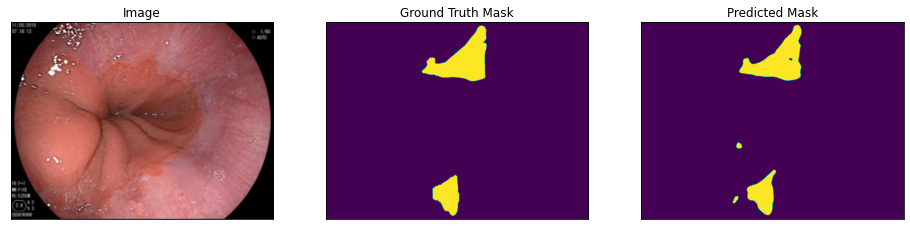

Dice =  0.9356571752804245
IOU =  0.8790947926249318


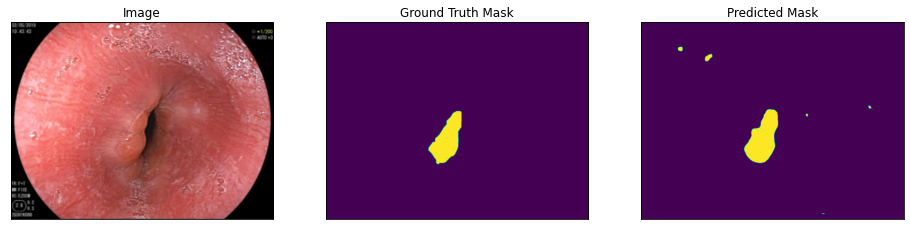

Dice =  0.8482497275228364
IOU =  0.7364918783988647


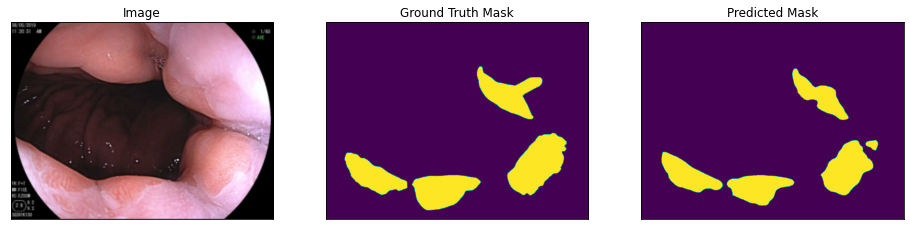

Dice =  0.8725673795686957
IOU =  0.7739425941651086


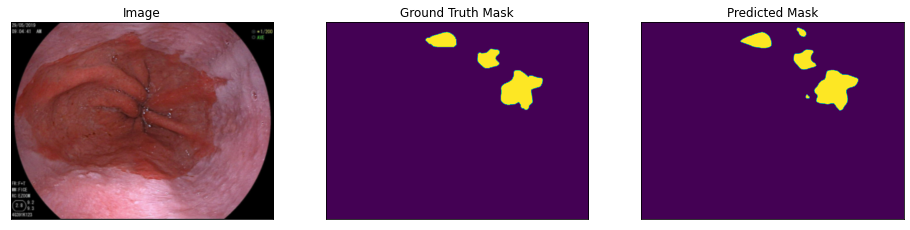

Dice =  0.9133015840703491
IOU =  0.8404388419726648


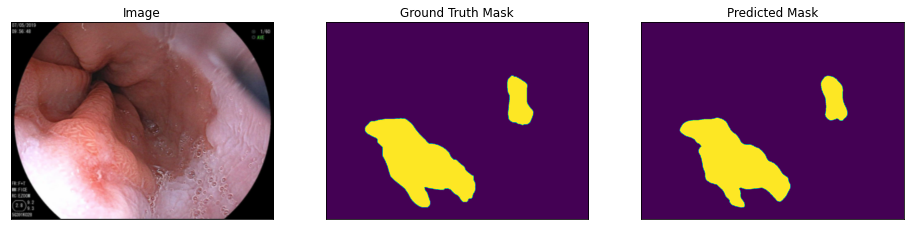

Dice =  0.957469182129517
IOU =  0.918408754163435


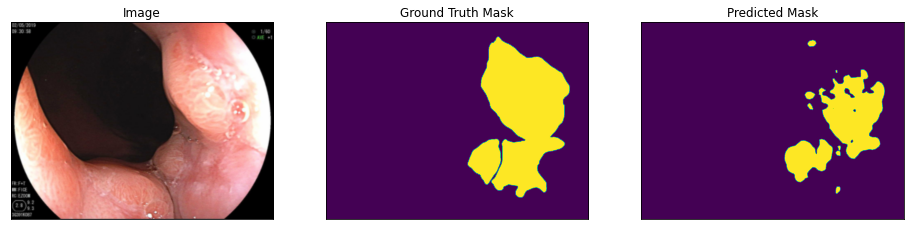

Dice =  0.6632959751813596
IOU =  0.49621865309010227


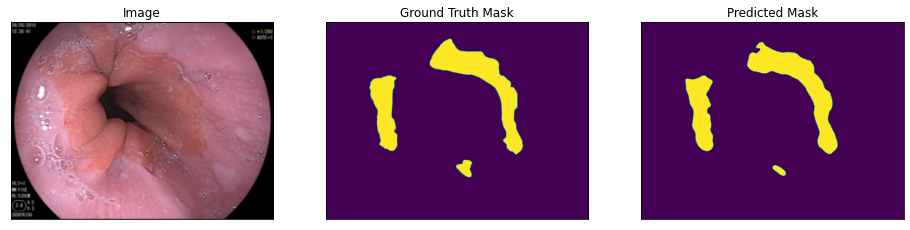

Dice =  0.9046336231885851
IOU =  0.8258738845547217


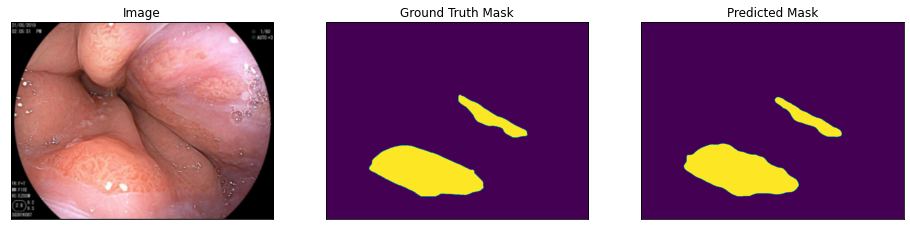

Dice =  0.9588830358441289
IOU =  0.9210141000408835


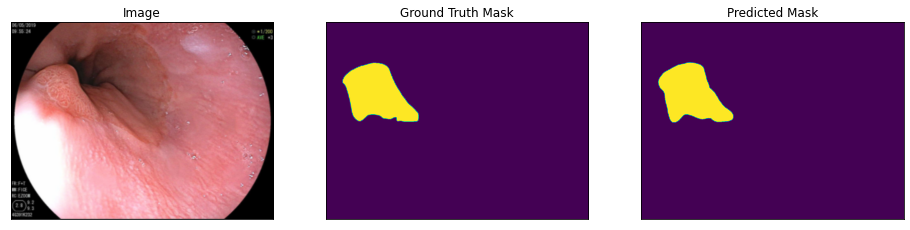

Dice =  0.9699563020629491
IOU =  0.9416656187513108


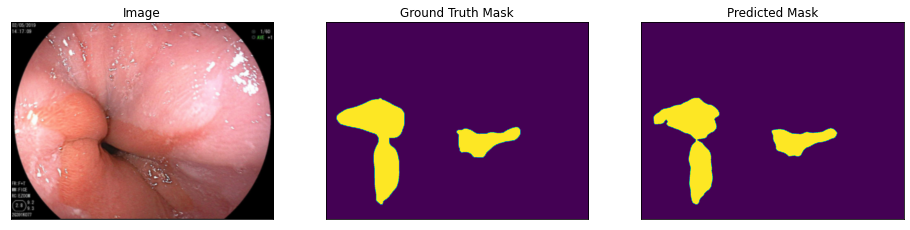

Dice =  0.9376044018319305
IOU =  0.8825385039142163


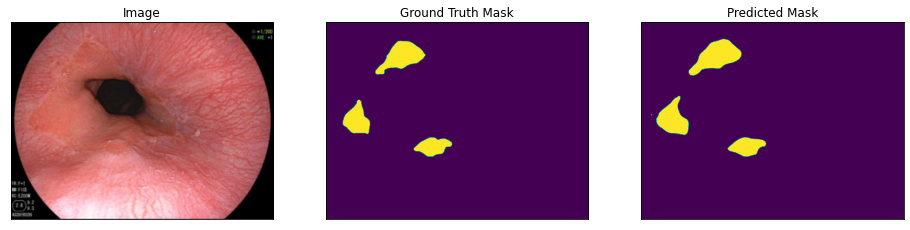

Dice =  0.9008625354110471
IOU =  0.8196102893449619


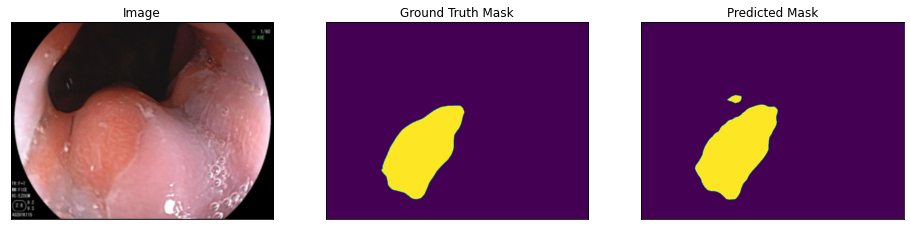

Dice =  0.9679372150973207
IOU =  0.9378668804046733


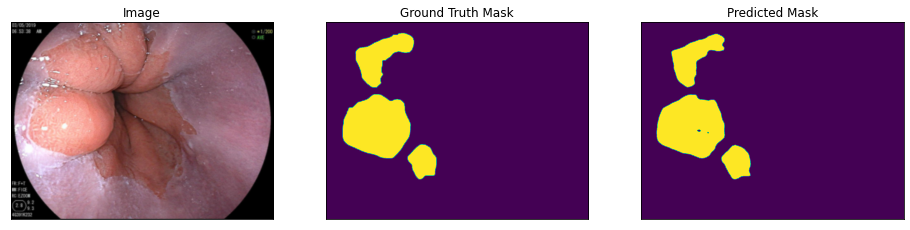

Dice =  0.9552133856286176
IOU =  0.9142668074740721


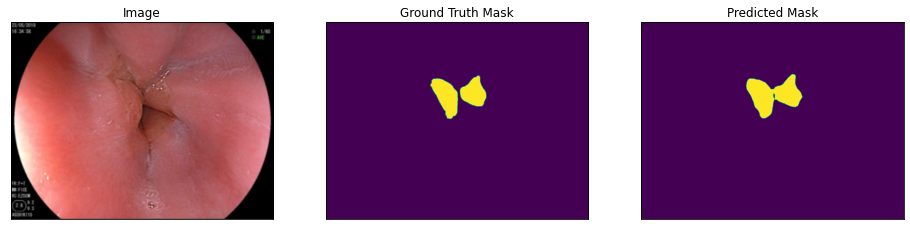

Dice =  0.9356981784697601
IOU =  0.8791680866056889


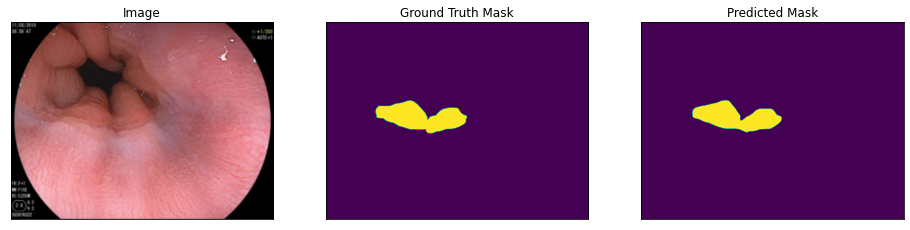

Dice =  0.9581491729743731
IOU =  0.9196615818504081


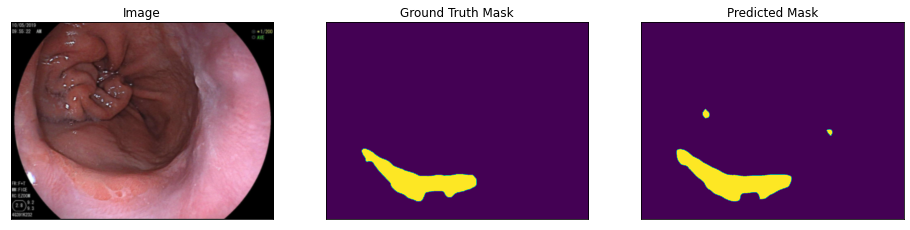

Dice =  0.9264142867316402
IOU =  0.8629172125176912


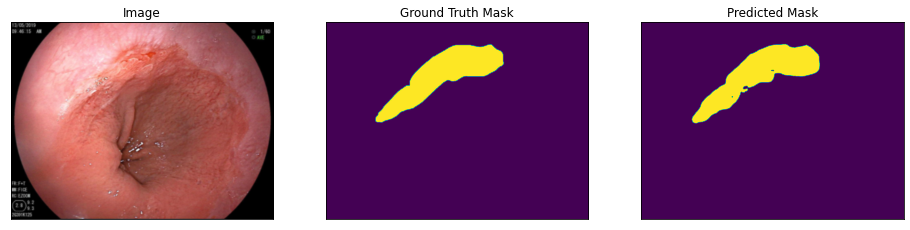

Dice =  0.9477574375119222
IOU =  0.9007029965606624


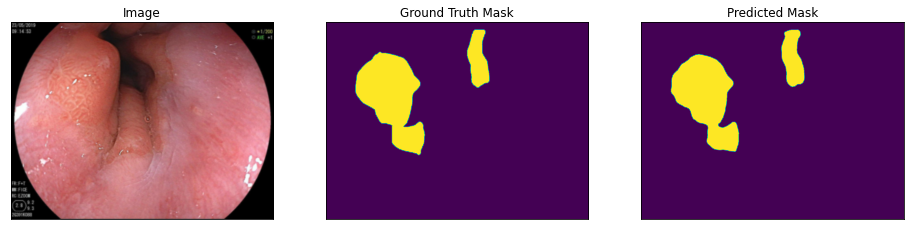

Dice =  0.9582755444018908
IOU =  0.9198938228660228


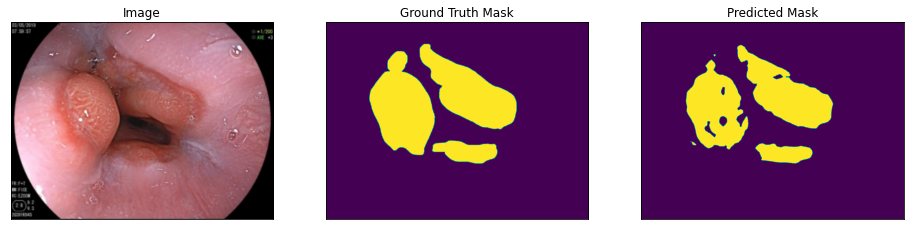

Dice =  0.8982683198382134
IOU =  0.8153244511009183


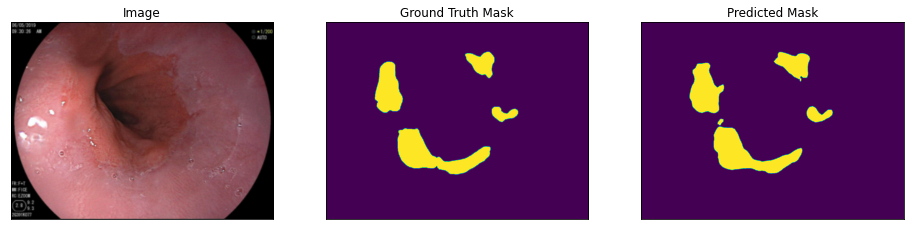

Dice =  0.8912275921727101
IOU =  0.8037977090863587


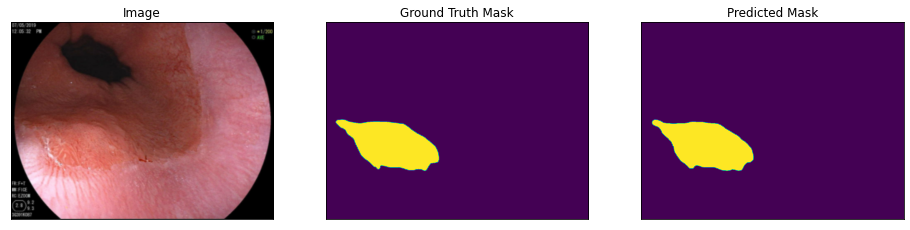

Dice =  0.9796093938481002
IOU =  0.9600339750127799


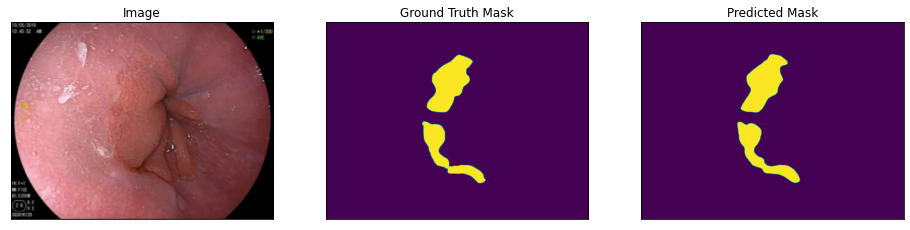

Dice =  0.9520473932231127
IOU =  0.908483973895465


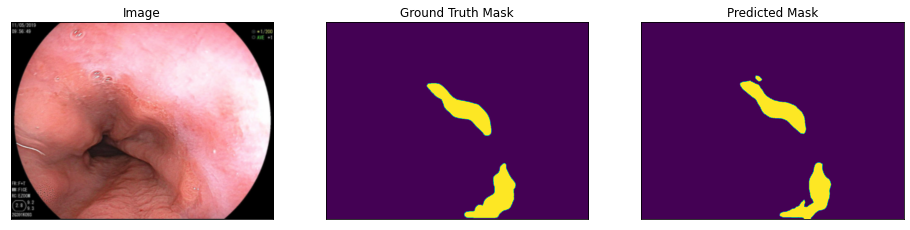

Dice =  0.9184267515754678
IOU =  0.8491594411774469


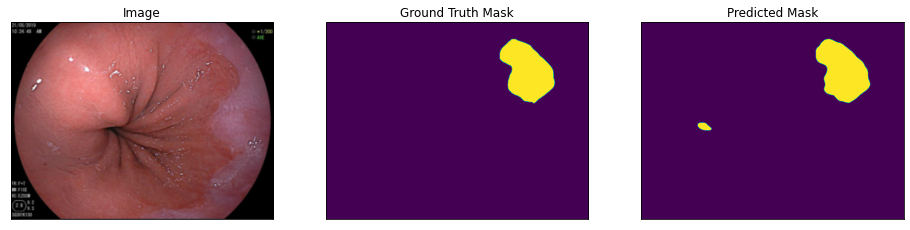

Dice =  0.9617707022959621
IOU =  0.9263573888835775


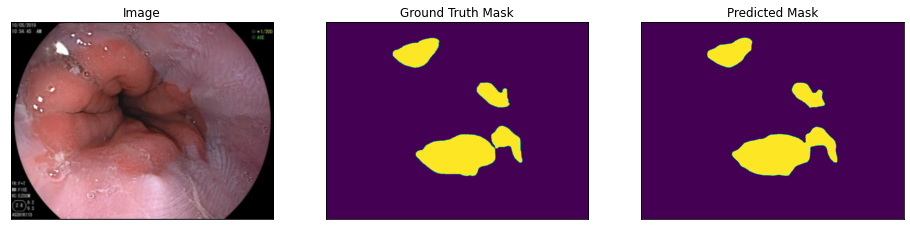

Dice =  0.9575149746153535
IOU =  0.918493169447597


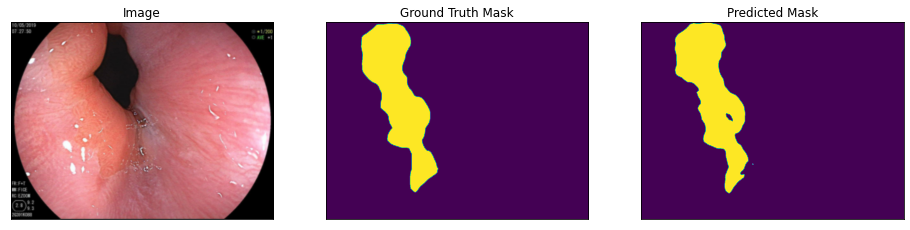

Dice =  0.9437460279012901
IOU =  0.8934843271094292


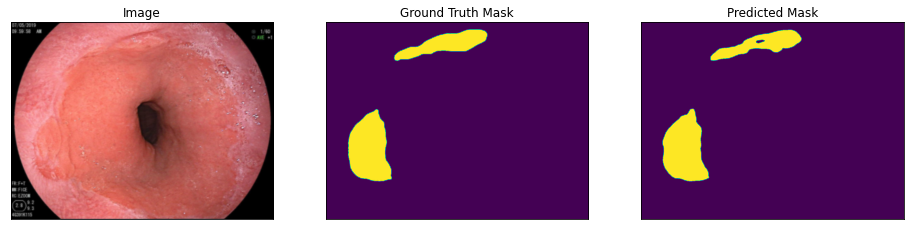

Dice =  0.9470930529087155
IOU =  0.8995036590241535


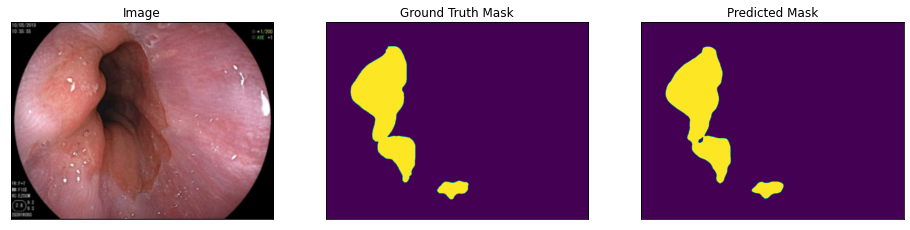

Dice =  0.9720737890452039
IOU =  0.9456651912860109


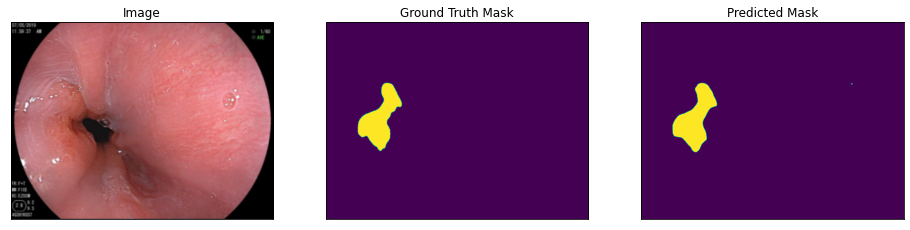

Dice =  0.9560282097879066
IOU =  0.9157617713874426


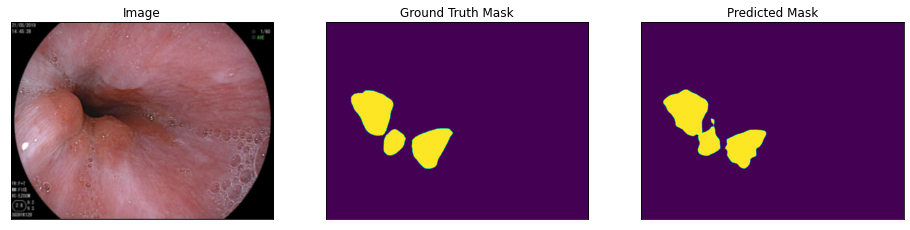

Dice =  0.9312465034362901
IOU =  0.8713398033814351


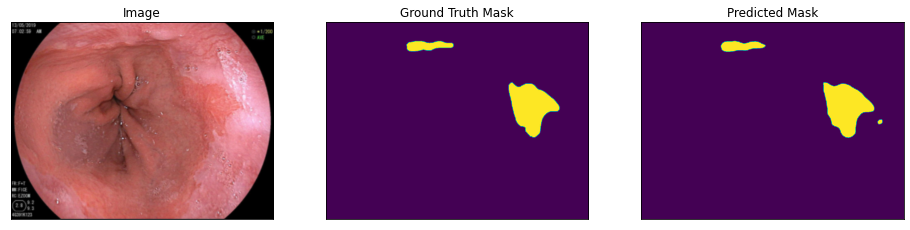

Dice =  0.9606398116281903
IOU =  0.9242615065911812


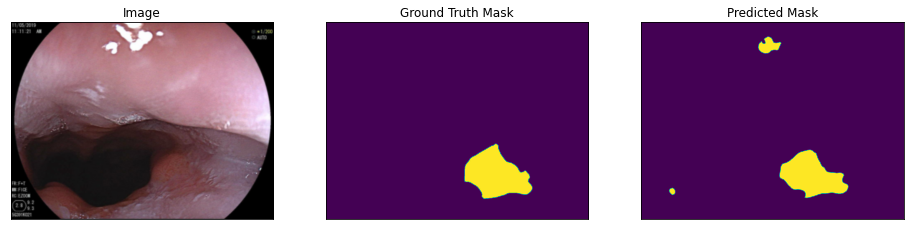

Dice =  0.8546636102787272
IOU =  0.7462139789887791


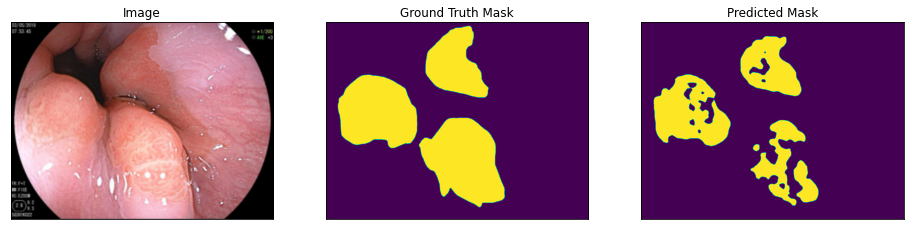

Dice =  0.7775711337667933
IOU =  0.6360876364781609


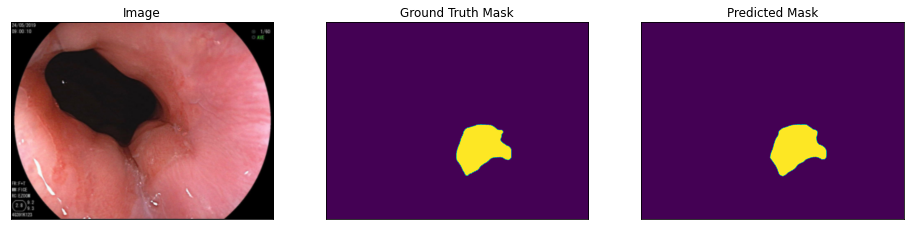

Dice =  0.9801054226149468
IOU =  0.9609874402484964
Mean dice =  0.8970250355062971
Mean IOU =  0.8339081737753647


In [ ]:
# Load checkpoint
print('| Resuming from checkpoint...')
# assert os.path.isdir('checkpoint'), 'Error: No checkpoint directory found!'
# _, file_name = getNetwork(args)
checkpoint = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth')
model.load_state_dict(checkpoint['model'])
best = checkpoint['acc']
start_epoch = checkpoint['epoch']

class test_dataset:
    def __init__(self, image_root, gt_root, testsize):
        self.testsize = testsize
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor()])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)
        self.index = 0

    def load_data(self):
        image = self.rgb_loader(self.images[self.index])
        image = self.transform(image).unsqueeze(0)
        gt = self.binary_loader(self.gts[self.index])
        name = self.images[self.index].split('/')[-1]
        # if name.endswith('.jpg'):
        #     name = name.split('.jpg')[0] + '.png'
        self.index += 1
        return image, gt, name

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('L')

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        # if image.shape[0] == 3:
        #     image = image.transpose([1, 2, 0])
        plt.imshow(image)
    plt.show()

test_image_root = '/content/Train/'
test_mask_root = '/content/GT/train/'
test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
dice = 0.0
IOU = 0.0
for i in range(test_loader.size):
    image, gt, name = test_loader.load_data()
    image = image.cuda()

    res = model(image)
    res = F.upsample(res, size=(960, 1280), mode='bilinear', align_corners=False)
    res = res.sigmoid().data.cpu().numpy().squeeze()
    res = (res - res.min()) / (res.max() - res.min() + 1e-8)
    
    image = F.upsample(image, size=(960, 1280), mode='bilinear', align_corners=False)
    image = image.squeeze().permute(1, 2, 0).cpu().numpy()
    visualize(
      image=image, 
      ground_truth_mask=gt, 
      predicted_mask=res.round()
      # predicted_mask_erosion_with_dilation=pr_mask_er
    )

    gt = np.asarray(gt, np.float32)
    gt /= (gt.max() + 1e-8)
    # gt = gt.round()
    # res = res.round()
    print("Dice = ", (2 * (gt * res).sum() + 1) / (gt.sum() + res.sum() + 1))
    print("IOU = ", ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1))
    dice += (2 * (gt * res).sum() + 1) / (gt.sum() + res.sum() + 1)
    IOU += ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1)
    
print("Mean dice = ",dice / test_loader.size)
print("Mean IOU = ",IOU / test_loader.size)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")


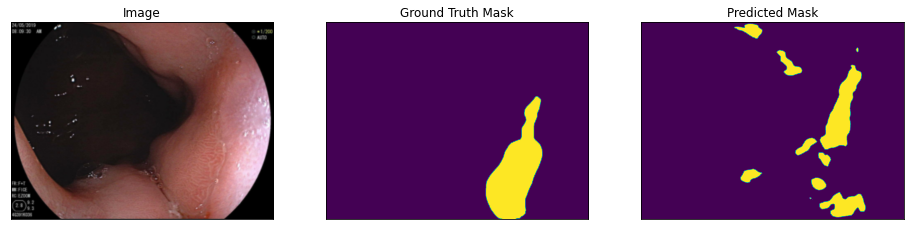

Dice =  0.34104147523824524
IOU =  0.2055785698414614


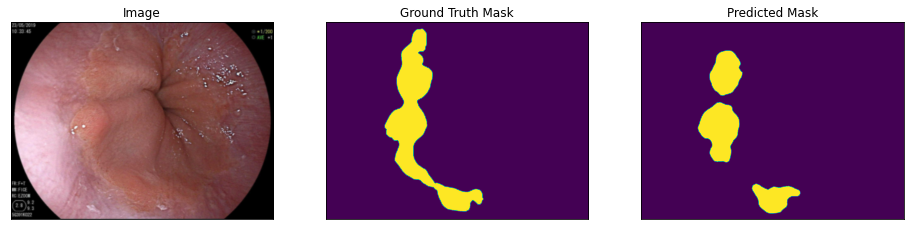

Dice =  0.7744481167710561
IOU =  0.6319194057037146


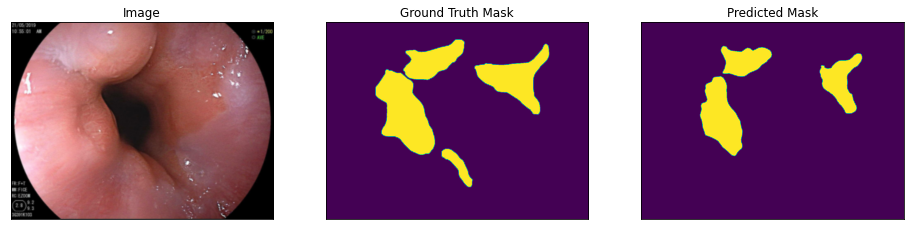

Dice =  0.7505195173120939
IOU =  0.6006664978858497


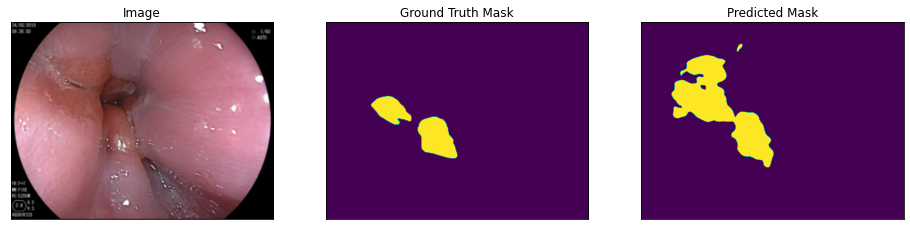

Dice =  0.5794307630963538
IOU =  0.40788921453849375


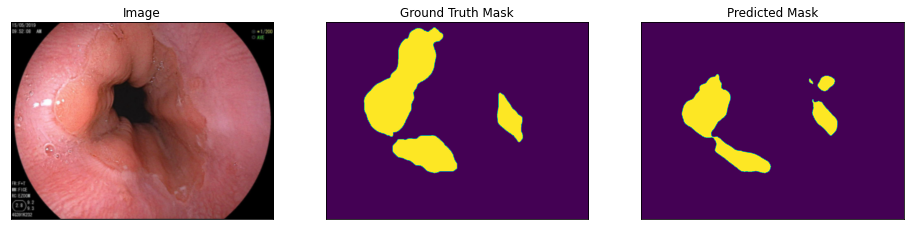

Dice =  0.6376794266162535
IOU =  0.4680848935435445


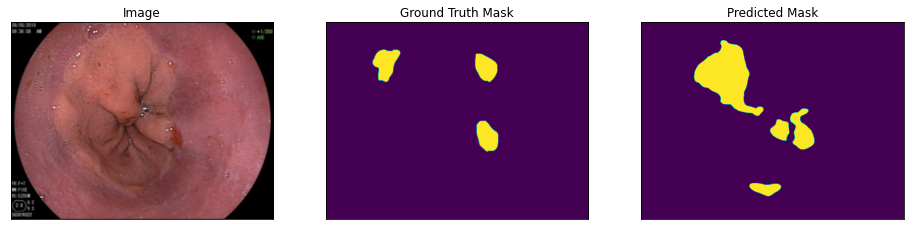

Dice =  0.26424786206470186
IOU =  0.15224224761970778


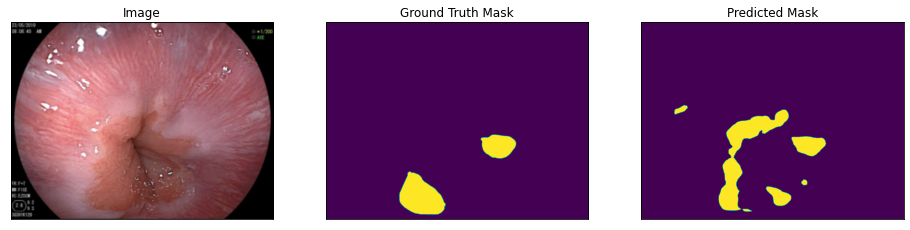

Dice =  0.42814621272530773
IOU =  0.2723869617488759


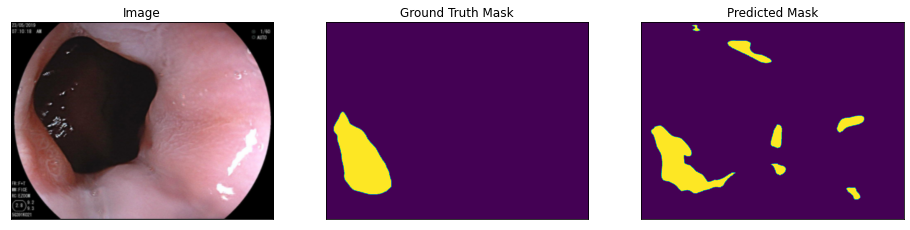

Dice =  0.6432525418719484
IOU =  0.47411654360640715


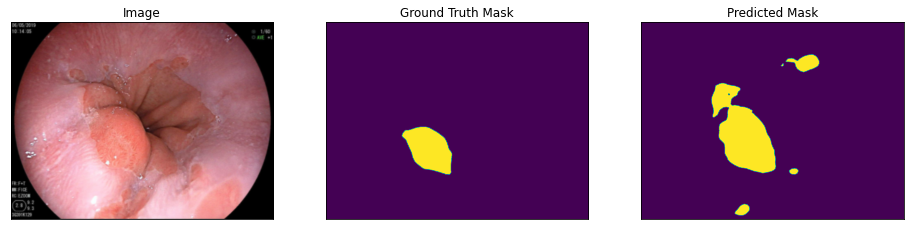

Dice =  0.5733703755613739
IOU =  0.4019088920241089


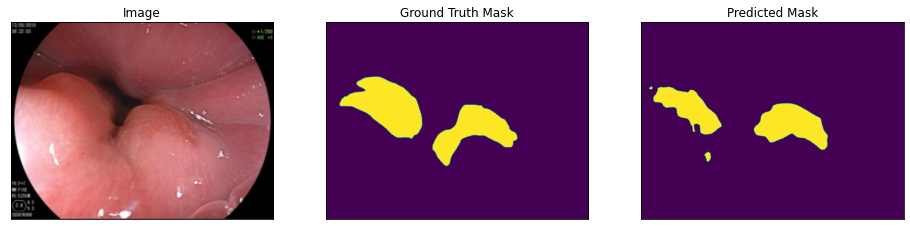

Dice =  0.6714163582551306
IOU =  0.5053643088038912


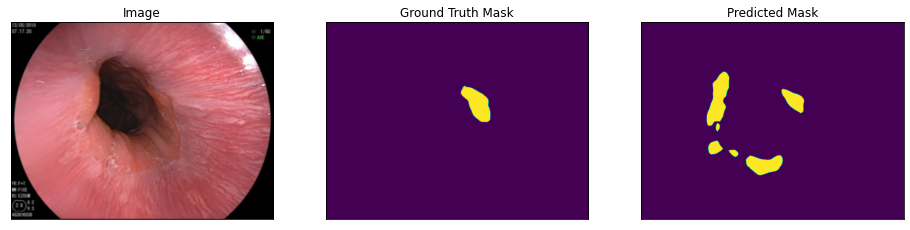

Dice =  0.2453690095989383
IOU =  0.13984923587588544


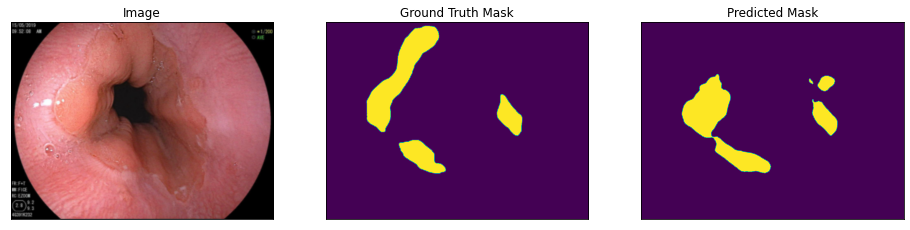

Dice =  0.5740167942148423
IOU =  0.40254344174348805


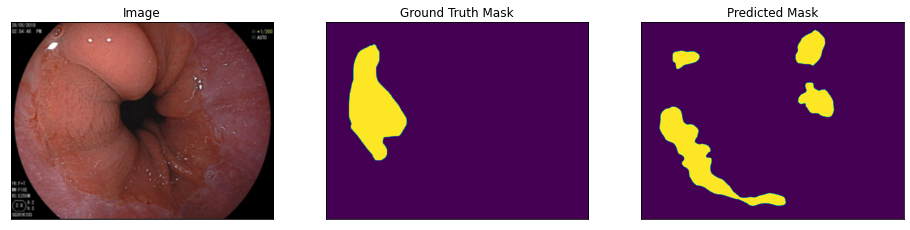

Dice =  0.3223217320442902
IOU =  0.192126100877497


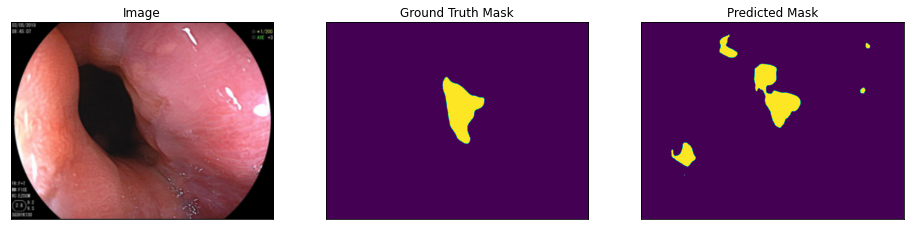

Dice =  0.5105936748727463
IOU =  0.34282240067333936


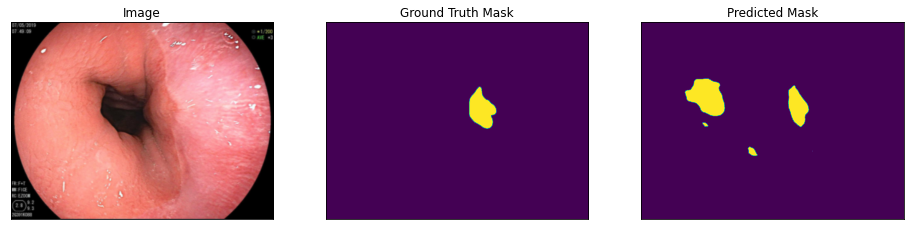

Dice =  0.40747474601206096
IOU =  0.25587530287521454


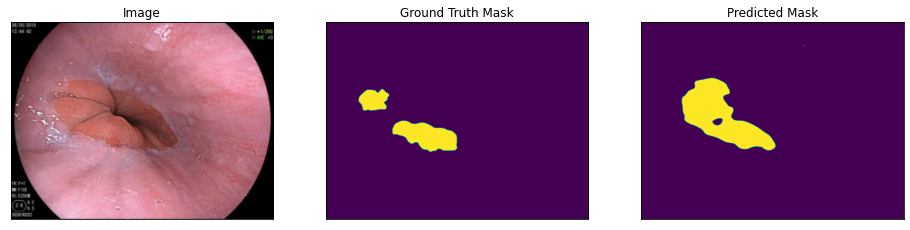

Dice =  0.5993481821972677
IOU =  0.42791008826554655


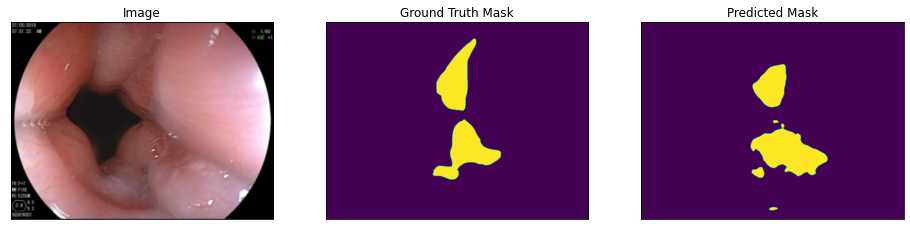

Dice =  0.7032401736726699
IOU =  0.5423079577447105


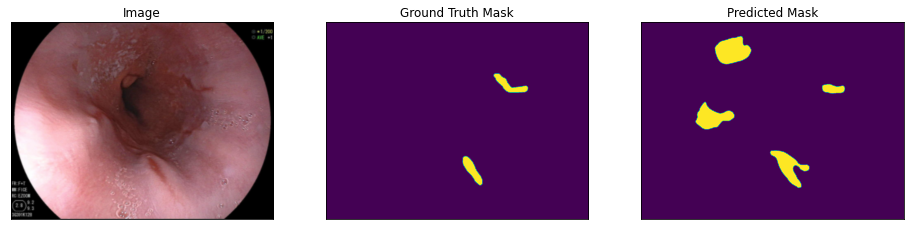

Dice =  0.2840013529833177
IOU =  0.16551025938271036


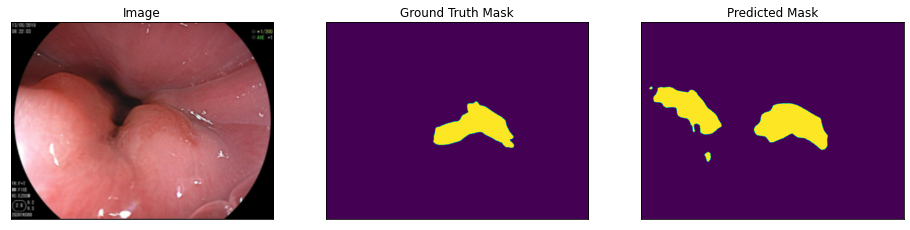

Dice =  0.5955085123921395
IOU =  0.4240060275124874


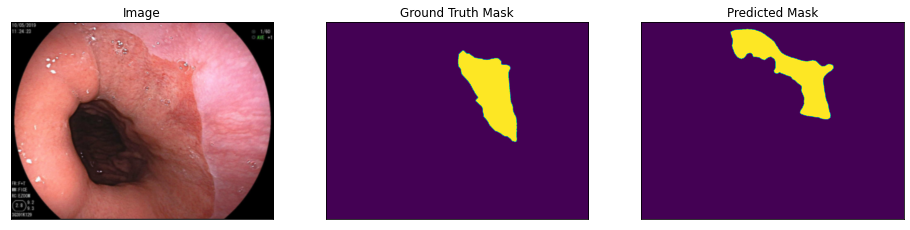

Dice =  0.632466121526302
IOU =  0.4624894345076914


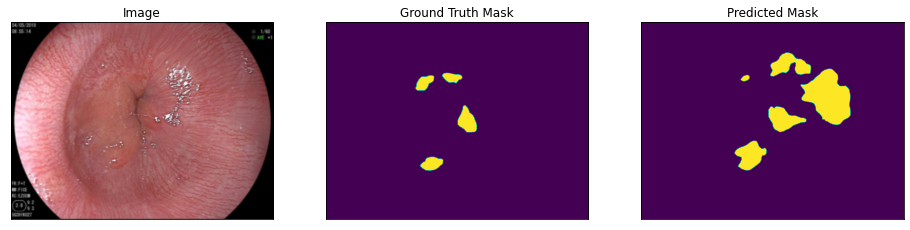

Dice =  0.24936750948707345
IOU =  0.14244899131768216


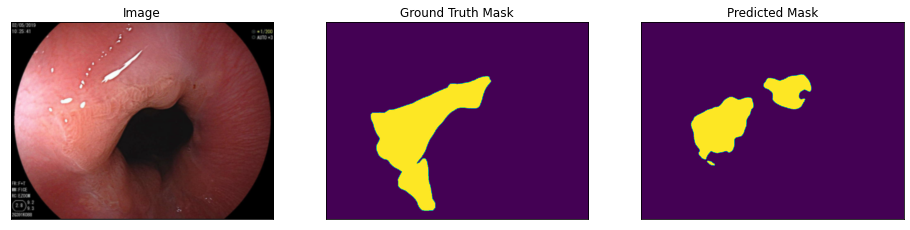

Dice =  0.6712584138248391
IOU =  0.5051852468028086


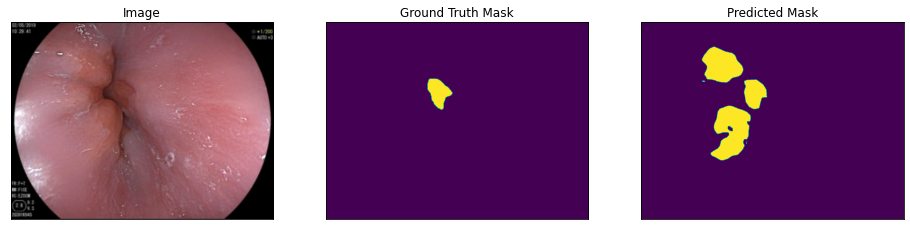

Dice =  0.24655813263839138
IOU =  0.1406198805012395


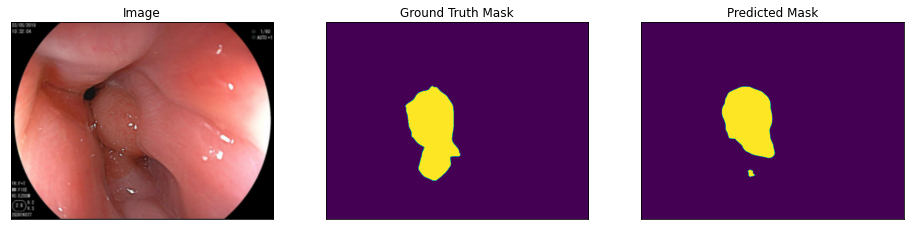

Dice =  0.8260802941243715
IOU =  0.7036958259210561


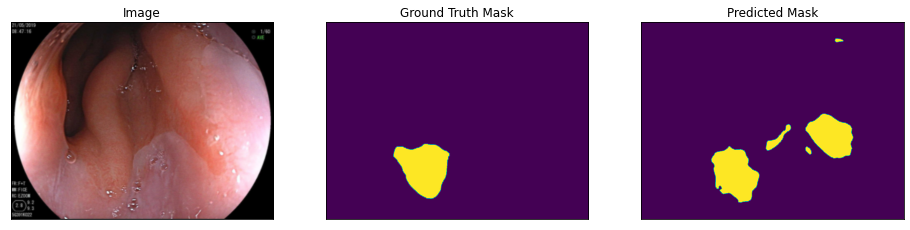

Dice =  0.5481072701271147
IOU =  0.3775155092728674


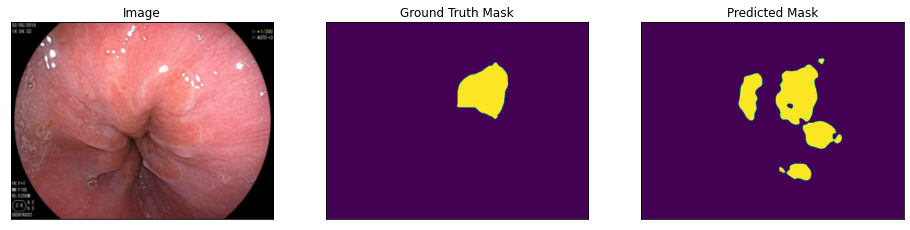

Dice =  0.5423838554122163
IOU =  0.3721066468139329


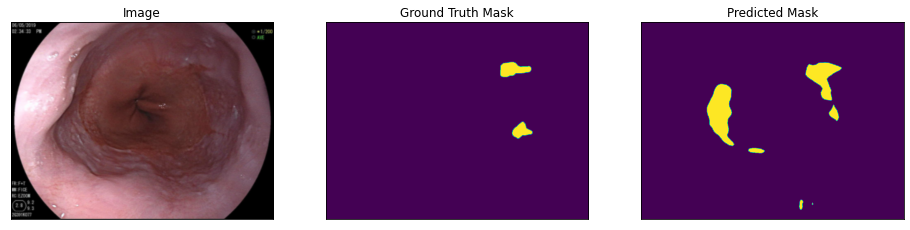

Dice =  0.23148400617569143
IOU =  0.13090014211850187


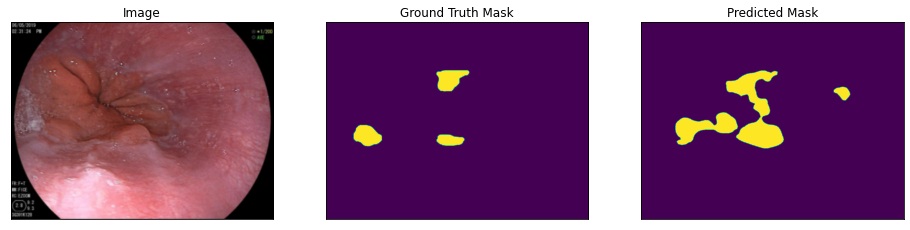

Dice =  0.34623883664315475
IOU =  0.20936930550614846


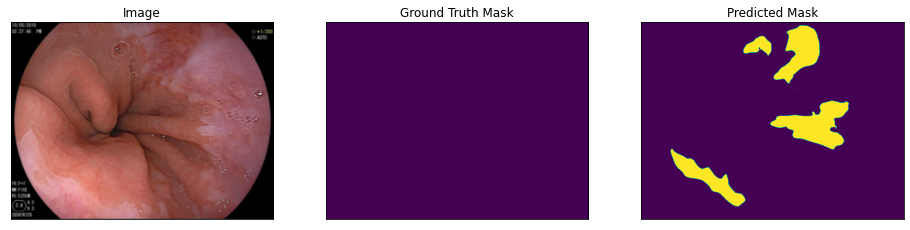

Dice =  8.904233851893653e-06
IOU =  8.904233851893653e-06


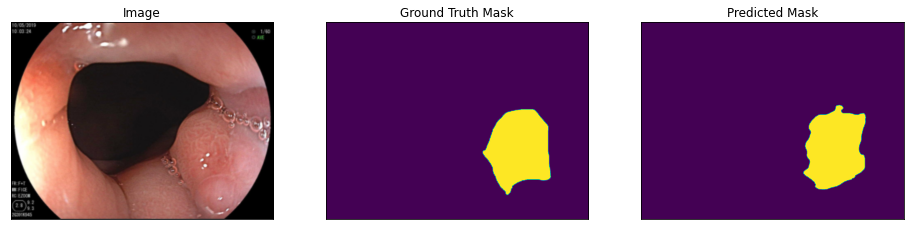

Dice =  0.9093817335126382
IOU =  0.8338230316233242


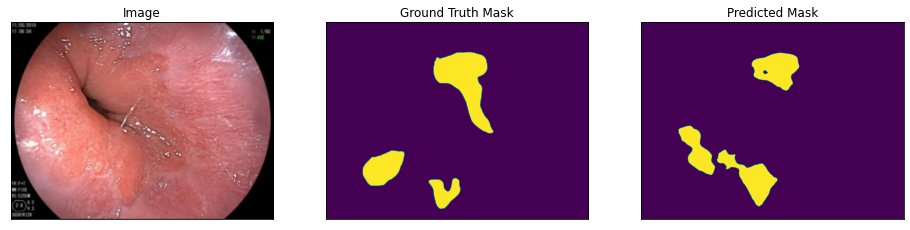

Dice =  0.5690136791040594
IOU =  0.3976398774343612


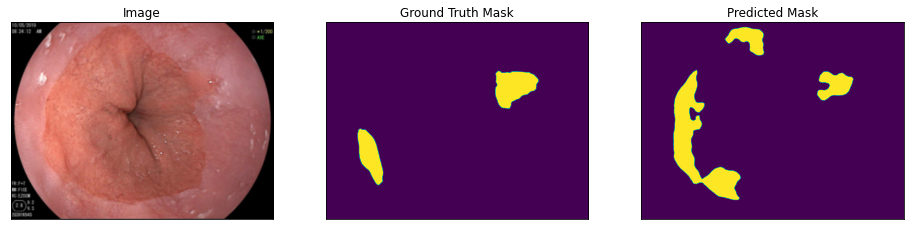

Dice =  0.4668392985200837
IOU =  0.30449784438799427


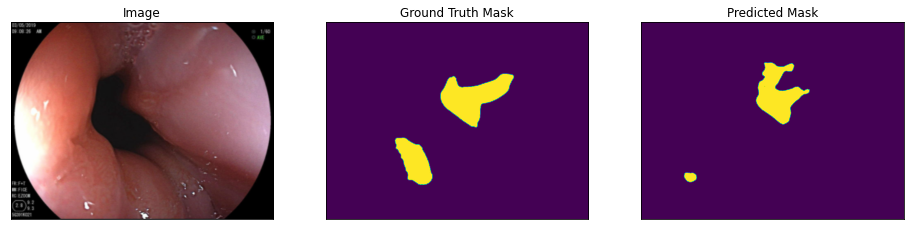

Dice =  0.5133283952417643
IOU =  0.3452909715412353


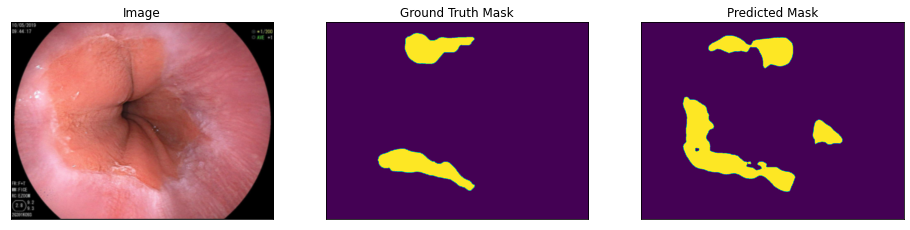

Dice =  0.5430986379913766
IOU =  0.372778913221934


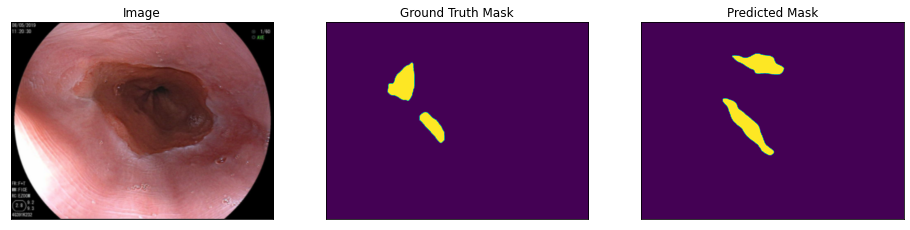

Dice =  0.30048976171875236
IOU =  0.1768179343752712


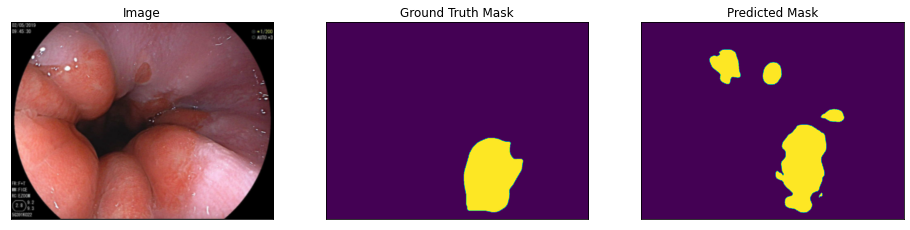

Dice =  0.6484430529298906
IOU =  0.47977701506488724


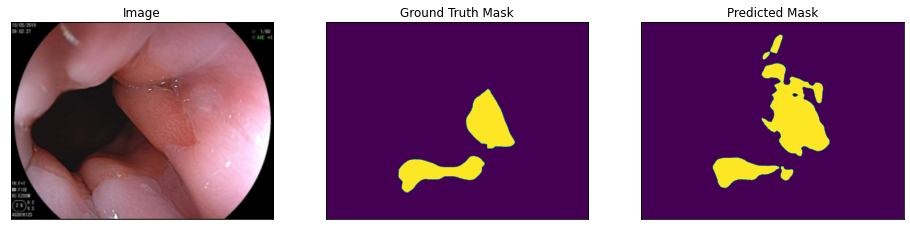

Dice =  0.6777574075341378
IOU =  0.512583670325915


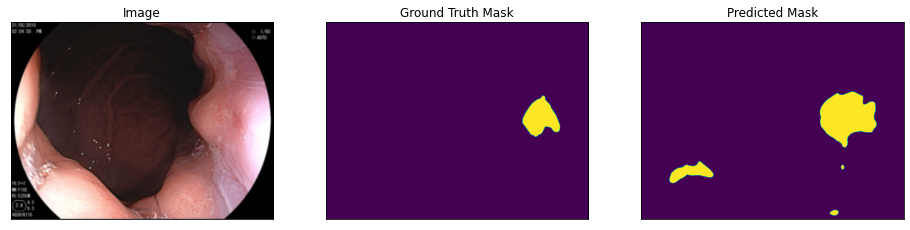

Dice =  0.5082801503048799
IOU =  0.34073956748661555


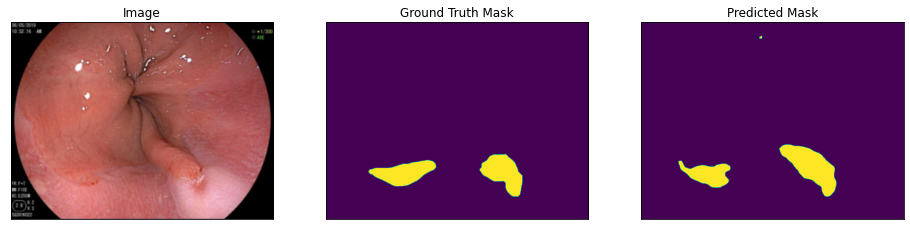

Dice =  0.758047363853834
IOU =  0.6103704152421132


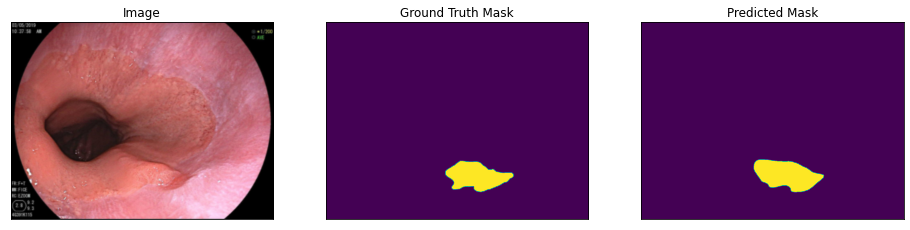

Dice =  0.871798986499404
IOU =  0.772736771590746


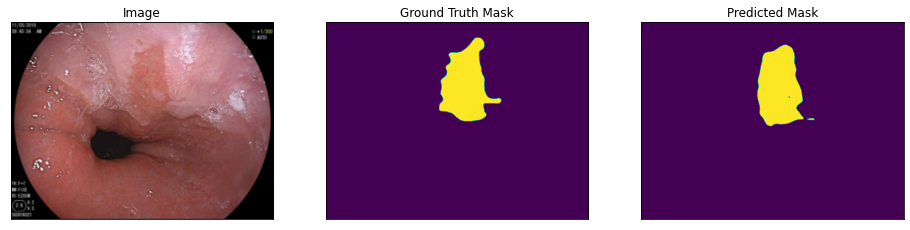

Dice =  0.8940743139271726
IOU =  0.8084410538668855


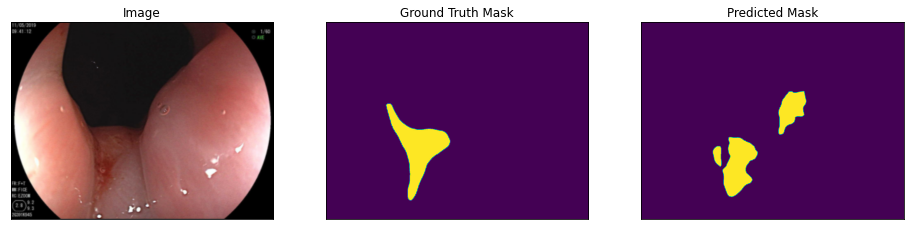

Dice =  0.4244981686010315
IOU =  0.26944138349512187


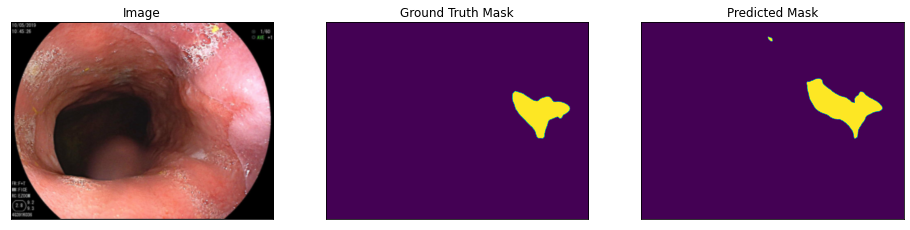

Dice =  0.7097035881883532
IOU =  0.5500360167602604


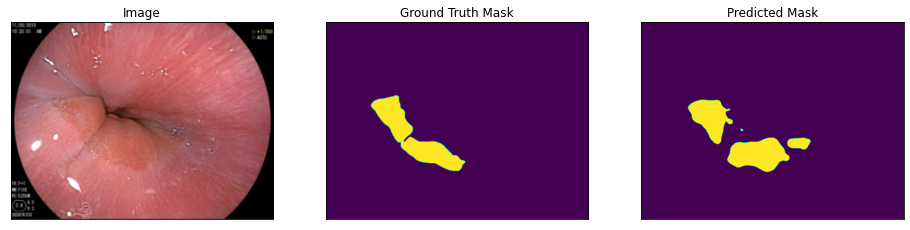

Dice =  0.7229947108274823
IOU =  0.5661671224764839


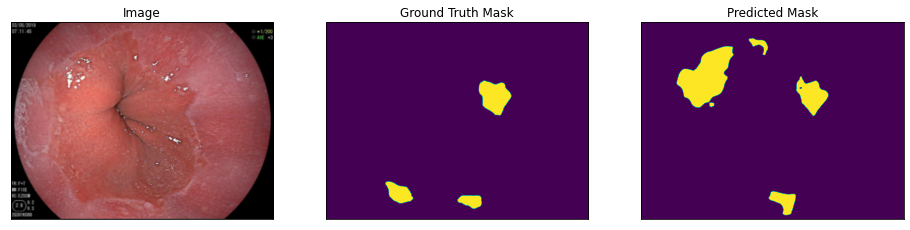

Dice =  0.3635222476621235
IOU =  0.22214138468975253
Mean dice =  0.5351255926246831
Mean IOU =  0.39157180468545805


In [ ]:
# Load checkpoint
print('| Resuming from checkpoint...')
# assert os.path.isdir('checkpoint'), 'Error: No checkpoint directory found!'
# _, file_name = getNetwork(args)
checkpoint = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth')
model.load_state_dict(checkpoint['model'])
best_acc = checkpoint['acc']
start_epoch = checkpoint['epoch']

class test_dataset:
    def __init__(self, image_root, gt_root, testsize):
        self.testsize = testsize
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor()])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)
        self.index = 0

    def load_data(self):
        image = self.rgb_loader(self.images[self.index])
        image = self.transform(image).unsqueeze(0)
        gt = self.binary_loader(self.gts[self.index])
        name = self.images[self.index].split('/')[-1]
        # if name.endswith('.jpg'):
        #     name = name.split('.jpg')[0] + '.png'
        self.index += 1
        return image, gt, name

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('L')

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        # if image.shape[0] == 3:
        #     image = image.transpose([1, 2, 0])
        plt.imshow(image)
    plt.show()

test_image_root = '/content/Test/'
test_mask_root = '/content/GT/test/'
test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
dice = 0.0
IOU = 0.0
for i in range(test_loader.size):
    image, gt, name = test_loader.load_data()
    image = image.cuda()

    res = model(image)
    res = F.upsample(res, size=(960, 1280), mode='bilinear', align_corners=False)
    res = res.sigmoid().data.cpu().numpy().squeeze()
    res = (res - res.min()) / (res.max() - res.min() + 1e-8)
    
    image = F.upsample(image, size=(960, 1280), mode='bilinear', align_corners=False)
    image = image.squeeze().permute(1, 2, 0).cpu().numpy()
    visualize(
      image=image, 
      ground_truth_mask=gt, 
      predicted_mask=res.round()
      # predicted_mask_erosion_with_dilation=pr_mask_er
    )

    gt = np.asarray(gt, np.float32)
    gt /= (gt.max() + 1e-8)
    # gt = gt.round()
    # res = res.round()
    print("Dice = ", (2 * (gt * res).sum() + 1) / (gt.sum() + res.sum() + 1))
    print("IOU = ", ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1))
    dice += (2 * (gt * res).sum() + 1) / (gt.sum() + res.sum() + 1)
    IOU += ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1)
    
print("Mean dice = ",dice / test_loader.size)
print("Mean IOU = ",IOU / test_loader.size)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")


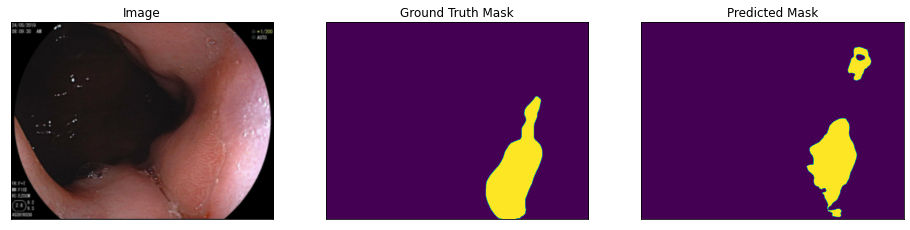

Dice =  0.6609068792498097
IOU =  0.4935504793998194


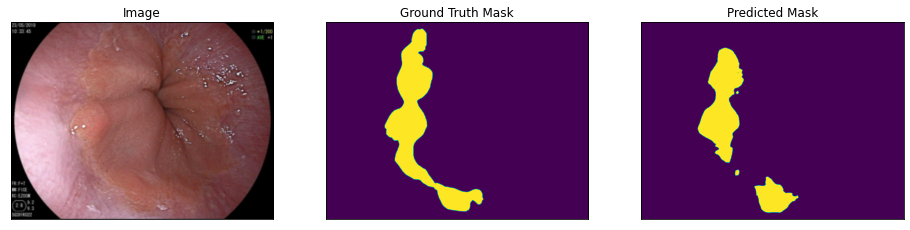

Dice =  0.7607646407161534
IOU =  0.6139000166689202


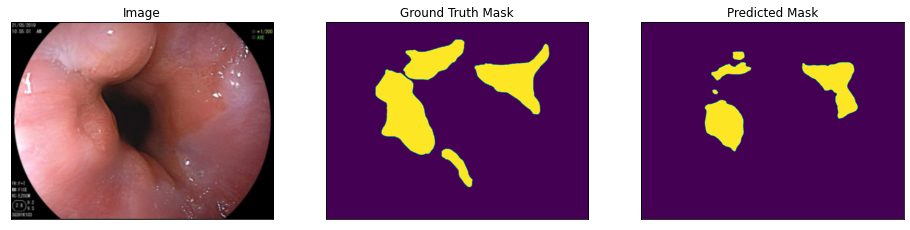

Dice =  0.6279295880247219
IOU =  0.45765273118297156


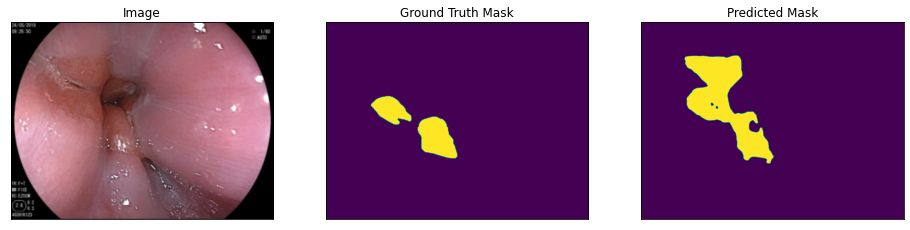

Dice =  0.5210885808925048
IOU =  0.3523493748633726


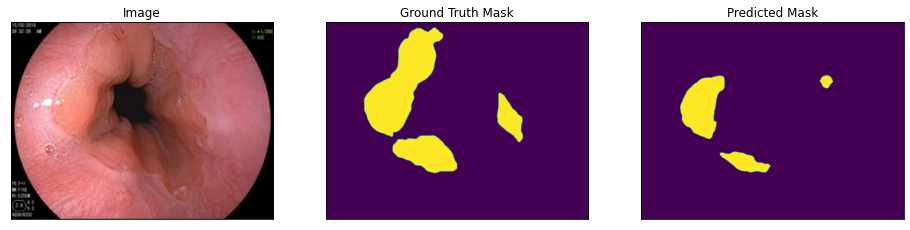

Dice =  0.527946914573516
IOU =  0.35864872699725187


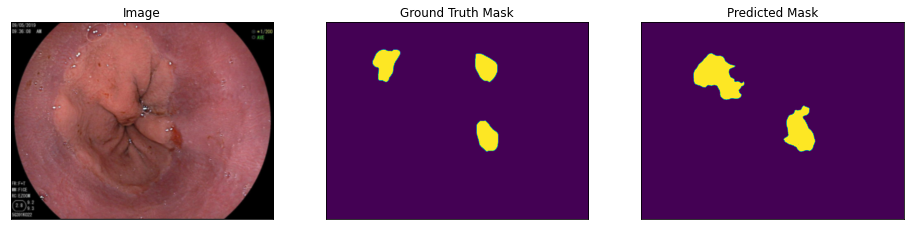

Dice =  0.4148346442544788
IOU =  0.261703156106357


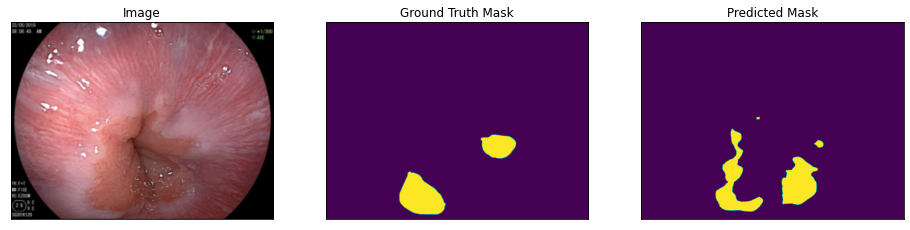

Dice =  0.35642705296475935
IOU =  0.2168654752363868


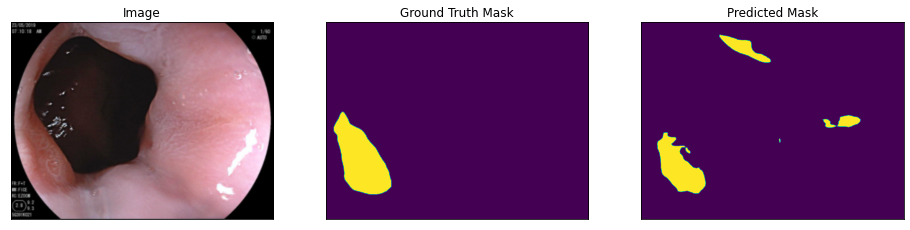

Dice =  0.5860047415405878
IOU =  0.41443529322606115


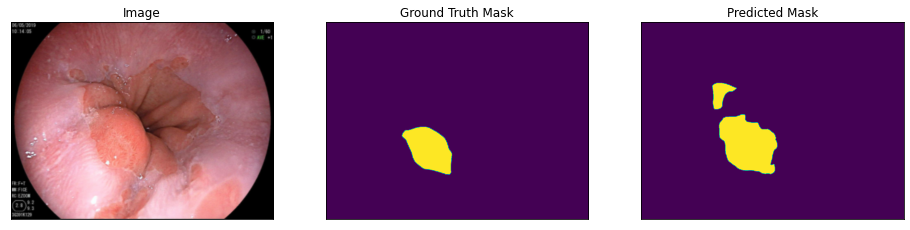

Dice =  0.6774074603732326
IOU =  0.5121849527092555


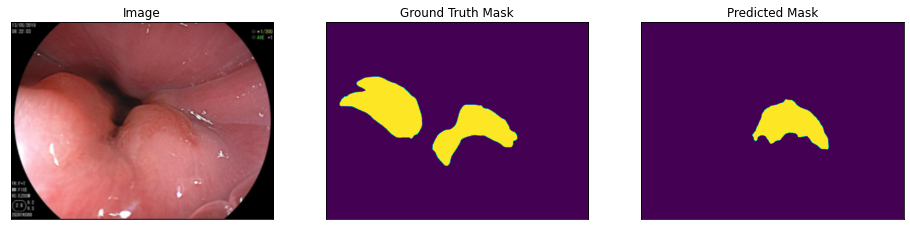

Dice =  0.4632094102186654
IOU =  0.30141614495723135


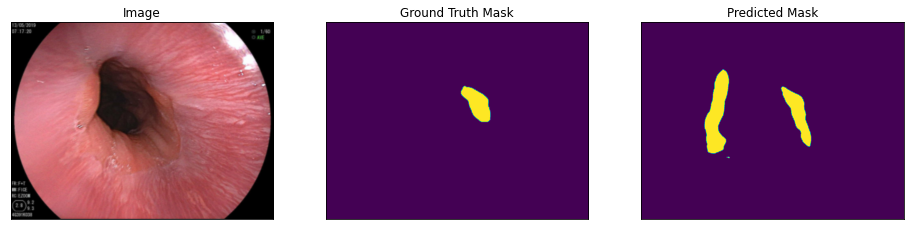

Dice =  0.35721823505857975
IOU =  0.21745492896479712


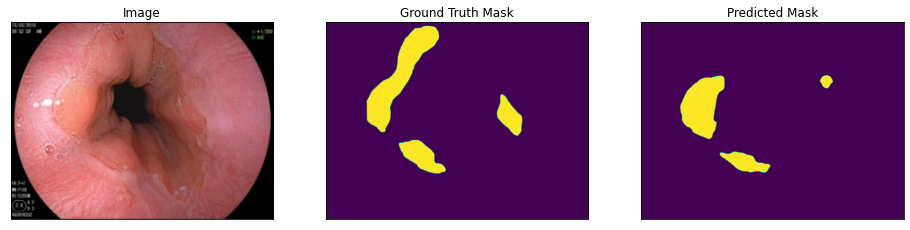

Dice =  0.5291811672669211
IOU =  0.3597895947816557


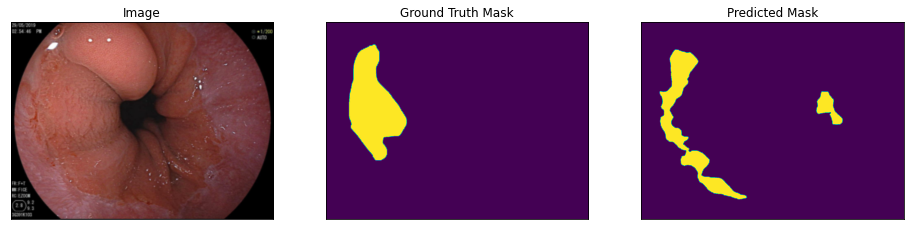

Dice =  0.43540370514183546
IOU =  0.2782879122662449


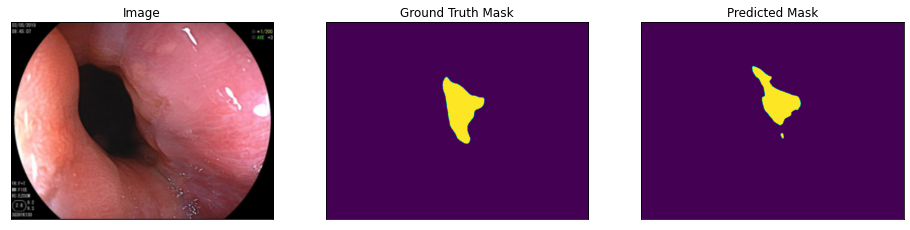

Dice =  0.7079611152118735
IOU =  0.5479464707113919


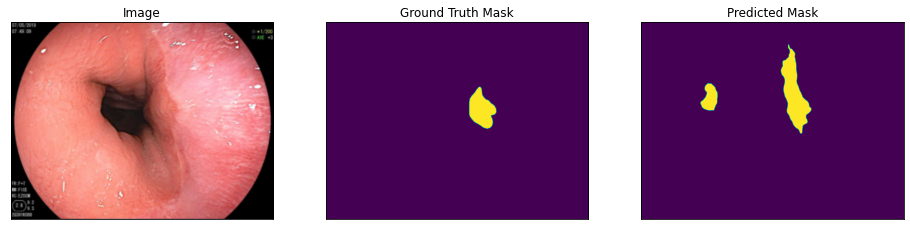

Dice =  0.5328608268558412
IOU =  0.3632052818444423


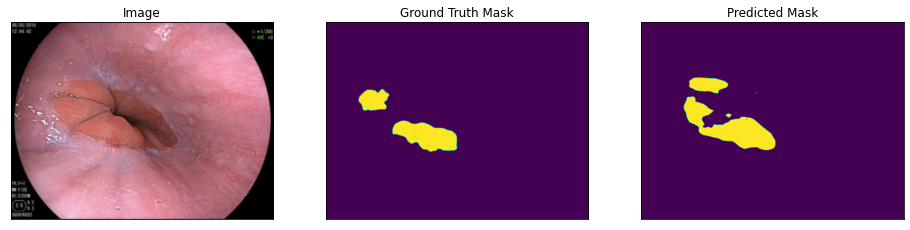

Dice =  0.597600069397484
IOU =  0.42613065929821176


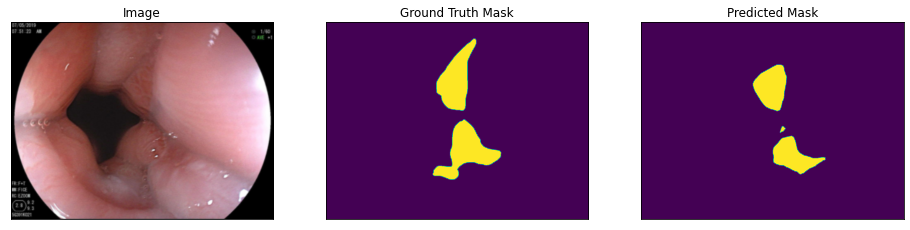

Dice =  0.6529818086296046
IOU =  0.48476397108942343


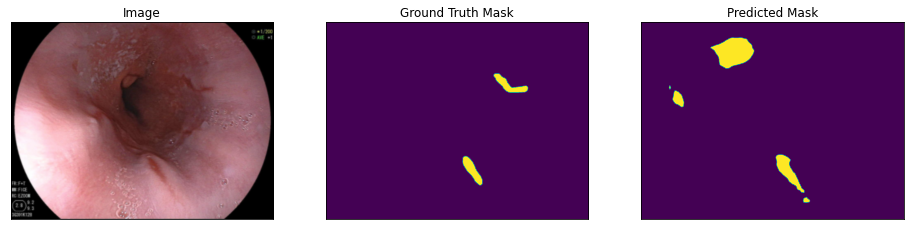

Dice =  0.24288699664364605
IOU =  0.13824063853067262


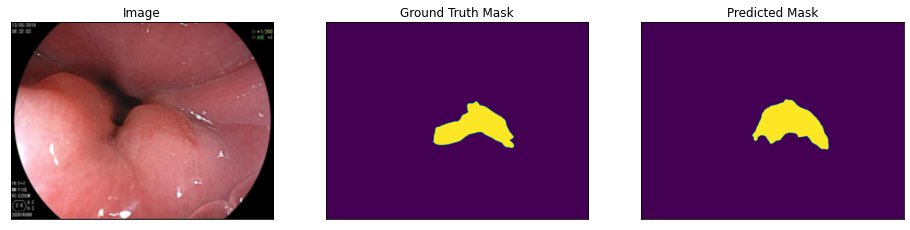

Dice =  0.8318532751624675
IOU =  0.7121163059527276


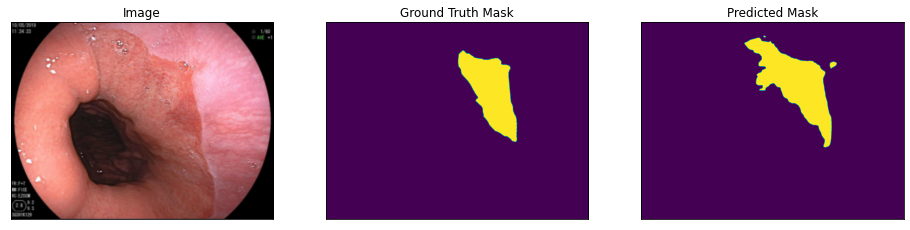

Dice =  0.7545792718432556
IOU =  0.6058850269168911


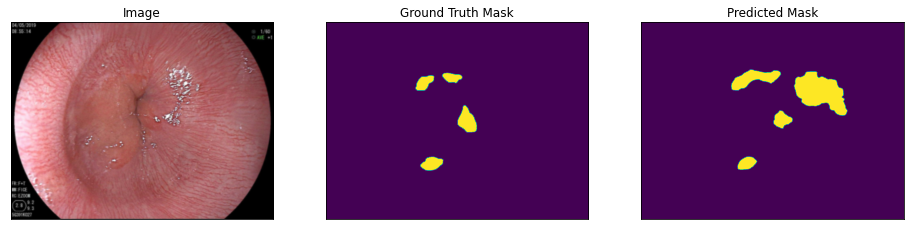

Dice =  0.3904749949974895
IOU =  0.2426086544034101


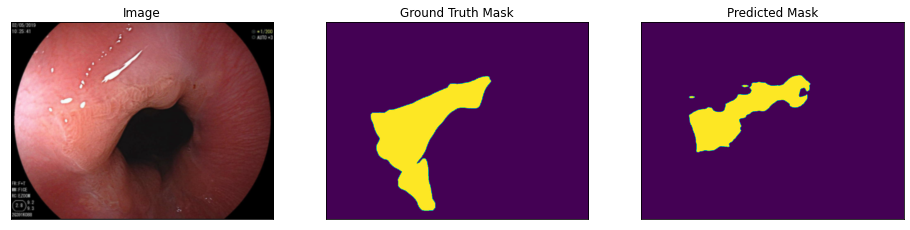

Dice =  0.6357437652561141
IOU =  0.46600204680351814


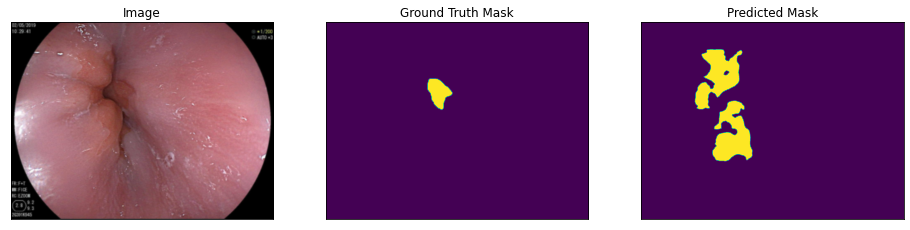

Dice =  0.0020596627413062194
IOU =  0.0010372617046889656


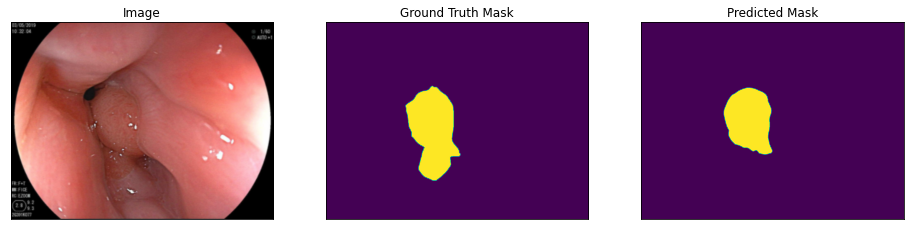

Dice =  0.8075598997413892
IOU =  0.6772350659905568


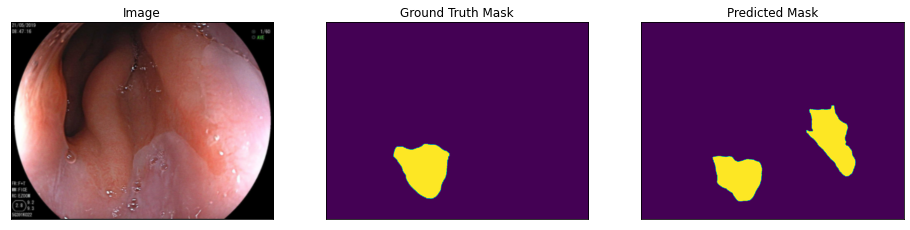

Dice =  0.5099055325144594
IOU =  0.3422002030538678


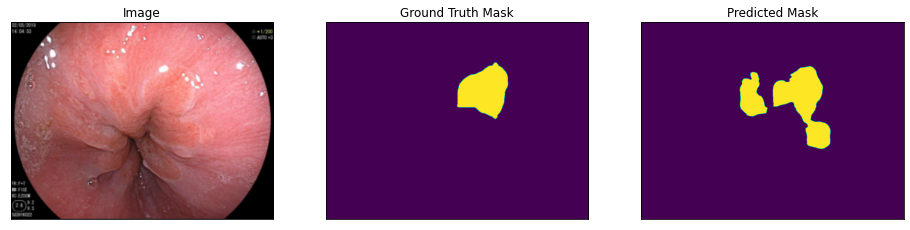

Dice =  0.6236418639606187
IOU =  0.45311352984595643


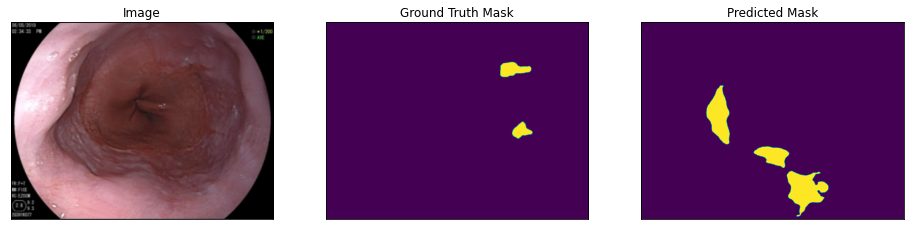

Dice =  0.0061990064762549035
IOU =  0.003116452064826648


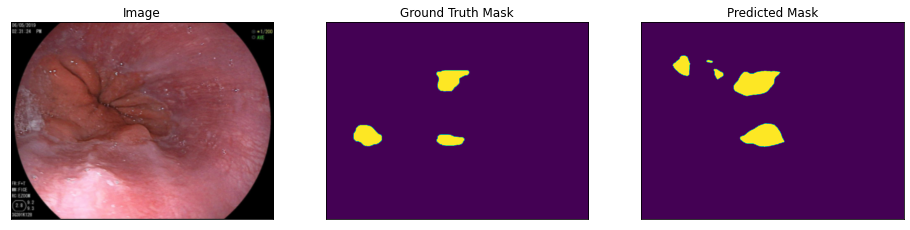

Dice =  0.42538091986619453
IOU =  0.2701548133438811


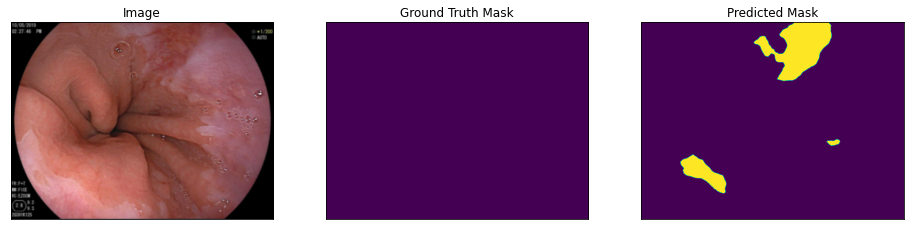

Dice =  1.279276952666353e-05
IOU =  1.279276952666353e-05


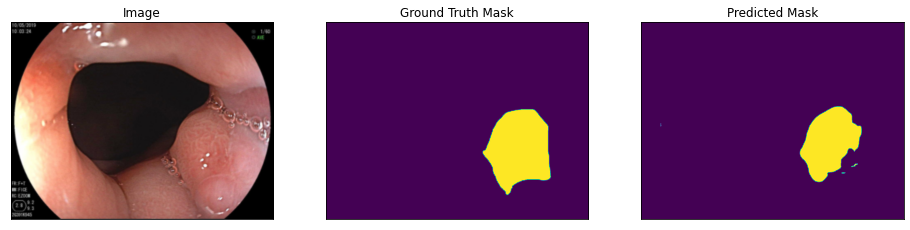

Dice =  0.8197809139383678
IOU =  0.6946021644864382


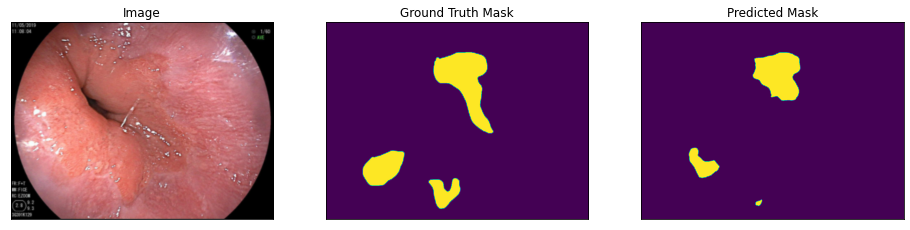

Dice =  0.6556321729701793
IOU =  0.4876907479095758


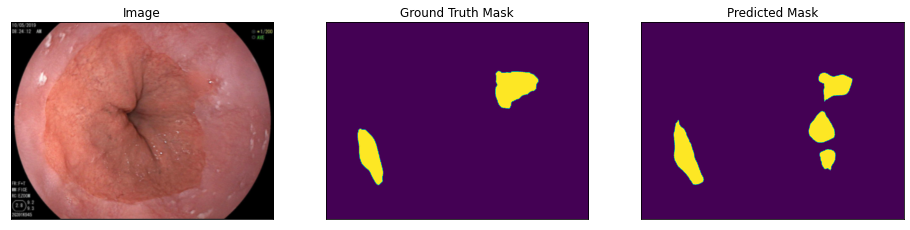

Dice =  0.6114269307315905
IOU =  0.44033138814552236


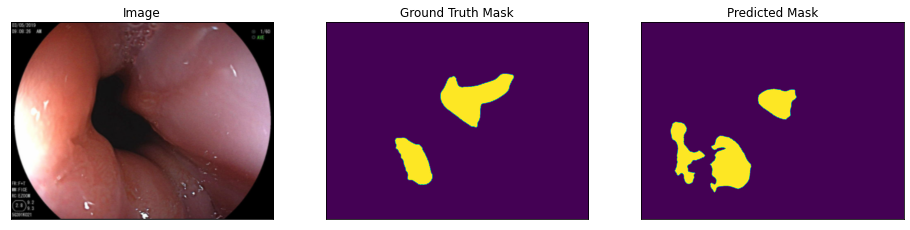

Dice =  0.5383412306050156
IOU =  0.3683112840478006


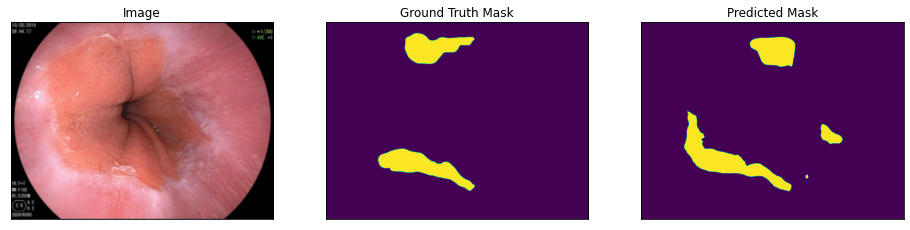

Dice =  0.554699687802546
IOU =  0.38379832864205815


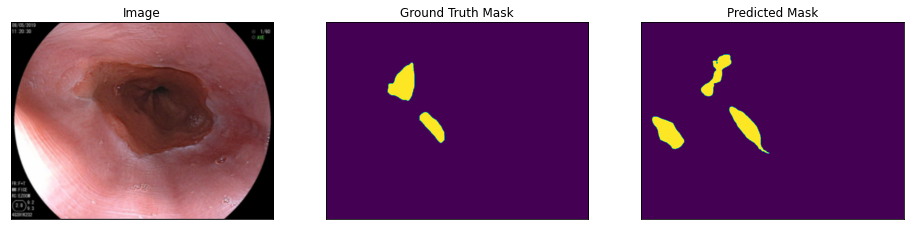

Dice =  0.4495681435822986
IOU =  0.2899702409737269


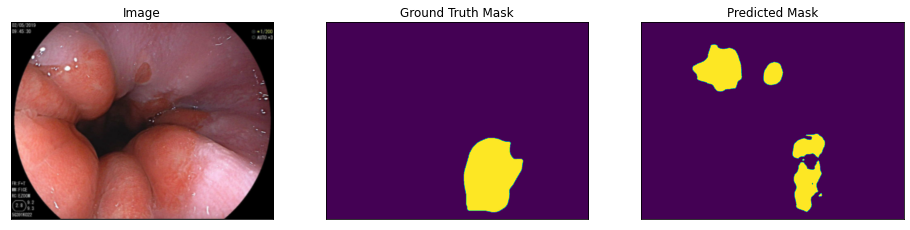

Dice =  0.39301801868625014
IOU =  0.24457199812245625


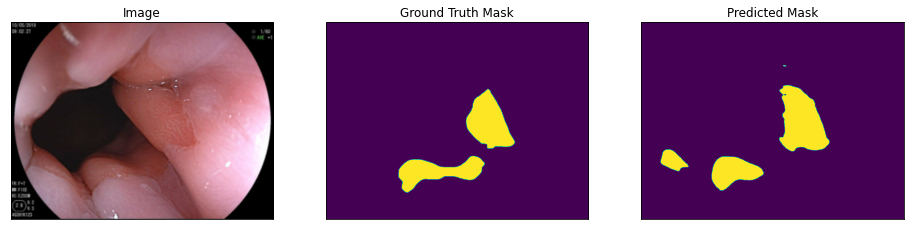

Dice =  0.7089477170082283
IOU =  0.5491259969185337


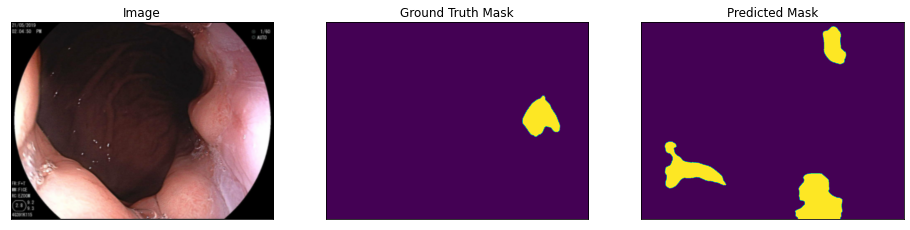

Dice =  0.012411787632365617
IOU =  0.006249577638473921


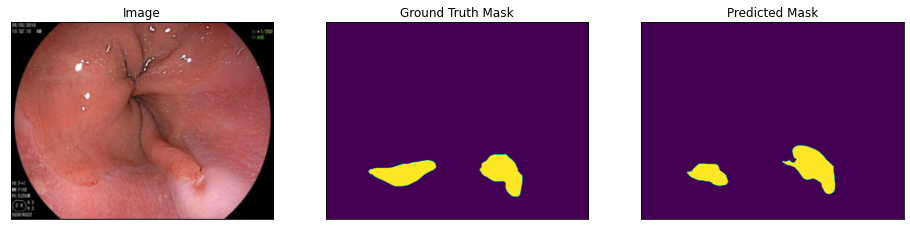

Dice =  0.7222387310759595
IOU =  0.5652412576838448


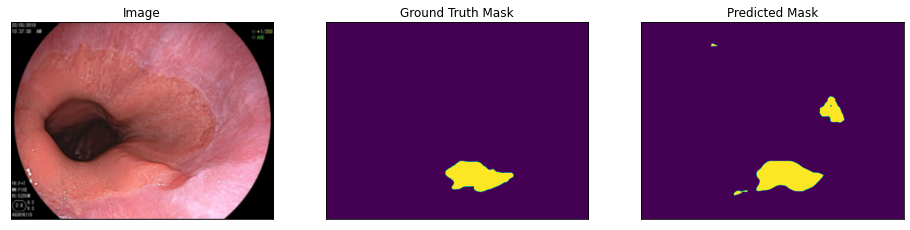

Dice =  0.7000234469370659
IOU =  0.5384935807703952


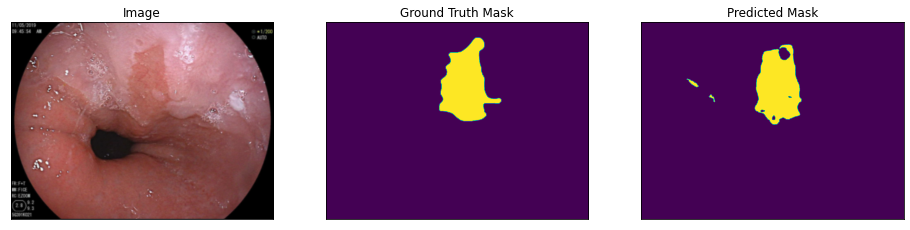

Dice =  0.8570981544190255
IOU =  0.7499332152100099


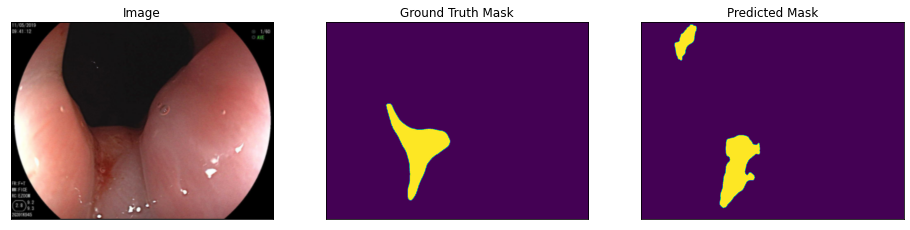

Dice =  0.5330750598484512
IOU =  0.3634007505454174


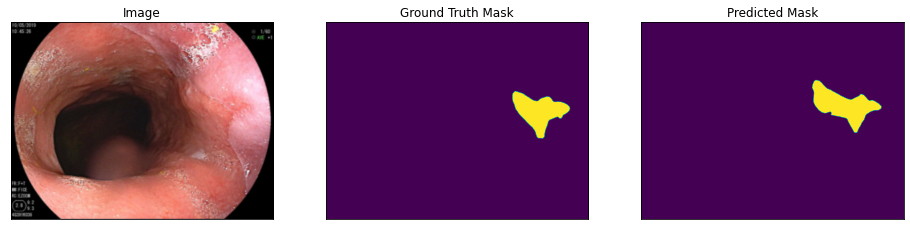

Dice =  0.7210786177382351
IOU =  0.5638227905963754


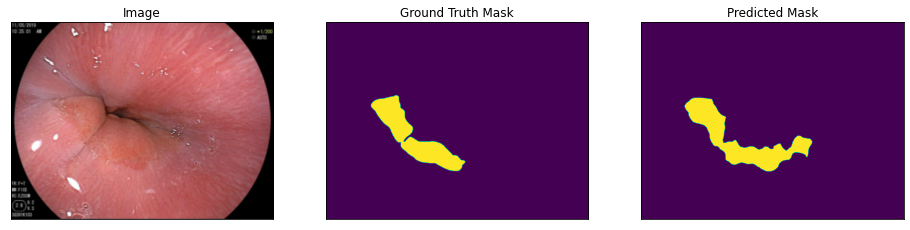

Dice =  0.7441175017545
IOU =  0.5925084812472774


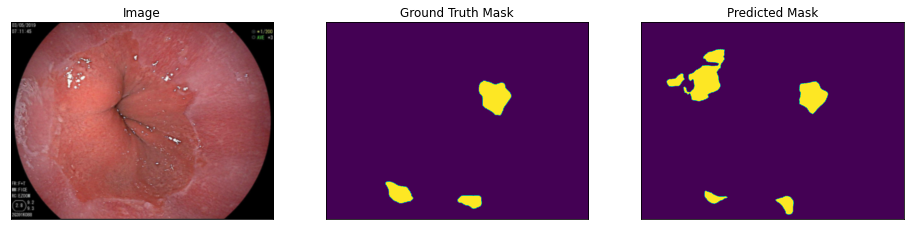

Dice =  0.4624460850901777
IOU =  0.30077243760798184
Mean dice =  0.5360873116036343
Mean IOU =  0.39357404893844905


In [ ]:
# model.load_state_dict(torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth'))

class test_dataset:
    def __init__(self, image_root, gt_root, testsize):
        self.testsize = testsize
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor()])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)
        self.index = 0

    def load_data(self):
        image = self.rgb_loader(self.images[self.index])
        image = self.transform(image).unsqueeze(0)
        gt = self.binary_loader(self.gts[self.index])
        name = self.images[self.index].split('/')[-1]
        # if name.endswith('.jpg'):
        #     name = name.split('.jpg')[0] + '.png'
        self.index += 1
        return image, gt, name

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('L')

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        # if image.shape[0] == 3:
        #     image = image.transpose([1, 2, 0])
        plt.imshow(image)
    plt.show()

test_image_root = '/content/Test/'
test_mask_root = '/content/GT/test/'
test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
dice = 0.0
IOU = 0.0
for i in range(test_loader.size):
    image, gt, name = test_loader.load_data()
    image = image.cuda()

    res = model(image)
    res = F.upsample(res, size=(960, 1280), mode='bilinear', align_corners=False)
    res = res.sigmoid().data.cpu().numpy().squeeze()
    res = (res - res.min()) / (res.max() - res.min() + 1e-8)
    
    image = F.upsample(image, size=(960, 1280), mode='bilinear', align_corners=False)
    image = image.squeeze().permute(1, 2, 0).cpu().numpy()
    visualize(
      image=image, 
      ground_truth_mask=gt, 
      predicted_mask=res.round()
      # predicted_mask_erosion_with_dilation=pr_mask_er
    )

    gt = np.asarray(gt, np.float32)
    gt /= (gt.max() + 1e-8)
    # gt = gt.round()
    # res = res.round()
    print("Dice = ", (2 * (gt * res).sum() + 1) / (gt.sum() + res.sum() + 1))
    print("IOU = ", ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1))
    dice += (2 * (gt * res).sum() + 1) / (gt.sum() + res.sum() + 1)
    IOU += ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1)
    
print("Mean dice = ",dice / test_loader.size)
print("Mean IOU = ",IOU / test_loader.size)

In [ ]:
learning_rate = 1e-3
from torch.optim import Optimizer
from torch.optim.lr_scheduler import _LRScheduler
import math

class CosineAnnealingWarmupLR(_LRScheduler):
    def __init__(self,
        optimizer: Optimizer,
        T_max: int, 
        eta_min: float = 0,
        last_epoch: int = -1,
        warmup_epochs=5
    ) -> None:
        self.T_max = T_max
        self.eta_min = eta_min
        self.warmup_epochs = warmup_epochs

        super().__init__(optimizer, last_epoch)

    def get_lr(self):
        if not self._get_lr_called_within_step:
            warnings.warn("To get the last learning rate computed by the scheduler, "
                          "please use `get_last_lr()`.", UserWarning)

        offset_epoch = self.last_epoch - self.warmup_epochs
        if self.last_epoch < self.warmup_epochs:
            return [
                lr * (self.last_epoch + 1) / self.warmup_epochs
                for lr in self.base_lrs
            ]
        elif self.last_epoch == self.warmup_epochs:
            return self.base_lrs
        elif (offset_epoch - 1 - self.T_max) % (2 * self.T_max) == 0:
            return [group['lr'] + (base_lr - self.eta_min) *
                    (1 - math.cos(math.pi / self.T_max)) / 2
                    for base_lr, group in
                    zip(self.base_lrs, self.optimizer.param_groups)]
        return [(1 + math.cos(math.pi * offset_epoch / self.T_max)) /
                (1 + math.cos(math.pi * (offset_epoch - 1) / self.T_max)) *
                (group['lr'] - self.eta_min) + self.eta_min
                for group in self.optimizer.param_groups]

scheduler = CosineAnnealingWarmupLR(optimizer,
                                    T_max=295,
                                    warmup_epochs=5,
                                    eta_min=0)

def structure_loss(pred, mask):
    
    weit = 1 + 5*torch.abs(F.avg_pool2d(mask, kernel_size=31, stride=1, padding=15) - mask)
    wbce = F.binary_cross_entropy_with_logits(pred, mask, reduce='none')
    wbce = (weit*wbce).sum(dim=(2, 3)) / weit.sum(dim=(2, 3))

    pred = torch.sigmoid(pred)
    inter = ((pred * mask)*weit).sum(dim=(2, 3))
    union = ((pred + mask)*weit).sum(dim=(2, 3))
    wiou = 1 - (inter + 1)/(union - inter+1)
    
    return (wbce + wiou).mean()

def test(model):
    
    ##### put ur data_path of TestDataSet/Kvasir here #####
    # data_path = path
    #####                                             #####
    
    model.eval()
    # test_path = '/content/TestDataset/Kvasir'
    # image_root = '{}/images/'.format(test_path)
    # gt_root = '{}/masks/'.format(test_path)
    test_image_root = '/content/Test/'
    test_mask_root = '/content/GT/test/'
    test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
    b=0.0
    for i in range(test_loader.size):
        image, gt, name = test_loader.load_data()
        gt = np.asarray(gt, np.float32)
        gt /= (gt.max() + 1e-8)
        image = image.cuda()
        
        res  = model(image)
        res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
        res = res.sigmoid().data.cpu().numpy().squeeze()
        res = (res - res.min()) / (res.max() - res.min() + 1e-8)
        
        input = res
        target = np.array(gt)
        N = gt.shape
        smooth = 1
        input_flat = np.reshape(input,(-1))
        target_flat = np.reshape(target,(-1))
 
        intersection = (input_flat*target_flat)
        
        loss =  (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)

        a =  '{:.4f}'.format(loss)
        a = float(a)
        b = b + a
        
    return b/test_loader.size



def train(train_loader, model, optimizer, epoch):
    model.train()
    # ---- multi-scale training ----
    size_rates = [0.75, 1, 1.25]
    loss_record2, loss_record3, loss_record4, loss_record5 = AvgMeter(), AvgMeter(), AvgMeter(), AvgMeter()

    for i, pack in enumerate(train_loader, start=1):
        for rate in size_rates:
            optimizer.zero_grad()
            # ---- data prepare ----
            images, gts = pack
            images = Variable(images).cuda()
            gts = Variable(gts).cuda()
            # ---- rescale ----
            Train_size = int(round(trainsize*rate/32)*32)
            if rate != 1:
                images = F.upsample(images, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
                gts = F.upsample(gts, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
            # ---- forward ----
            #lateral_map_5, lateral_map_4, lateral_map_3, lateral_map_2 = model(images)
            lateral_map_5 = model(images)
            # ---- loss function ----
            loss5 = structure_loss(lateral_map_5, gts)
            
            
            #loss = loss2 + 0.4*loss3 + 0.4*loss4 + 0.2*loss5    # TODO: try different weights for loss
            loss = loss5
            # ---- backward ----
            loss.backward()
            clip_gradient(optimizer, clip)
            optimizer.step()
            # ---- recording loss ----
            if rate == 1:
                
                loss_record5.update(loss5.data, batchsize)
        # ---- train visualization ----
        if i % 20 == 0 or i == total_step:
            print('{} Epoch [{:03d}/{:03d}], Step [{:04d}/{:04d}], '
                  ' lateral-5: {:0.4f}]'.
                  format(datetime.now(), epoch, 100, i, total_step,
                          loss_record5.show()))
    save_path = '{}/'.format(train_save)
    os.makedirs(save_path, exist_ok=True)
    
    global best
    # if (epoch+1) % 1 == 0:
    meandice = test(model)
    if meandice > best:
        print ("current best is "+str(best) +" new best is "+str(meandice))
        best = meandice
        torch.save(model.state_dict(), save_path + 'HarD-MSEG-best.pth' )
        print('[Saving Snapshot:]', save_path + 'HarD-MSEG-best.pth',meandice)

# train_path = '/content/TrainDataset'
# image_root = '{}/image/'.format(train_path)
# gt_root = '{}/mask/'.format(train_path)
train_image_root = '/content/Train/'
train_mask_root = '/content/GT/train/'
train_loader = get_loader(train_image_root, train_mask_root, batchsize=batchsize, trainsize=trainsize, augmentation = True)
total_step = len(train_loader)

  # ---- build models ----
    # torch.cuda.set_device(0)  # set your gpu device


print("#"*20, "Start Training", "#"*20)
    
for epoch in range(1, 300):
    # adjust_lr(optimizer, learning_rate, epoch, 0.9, 30)
    train(train_loader, model, optimizer, epoch)
    scheduler.step()

True
Using RandomRotation, RandomFlip
#################### Start Training ####################


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:1249: UserWarning: Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead
  "Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead"
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate 

2021-11-28 13:03:08.797956 Epoch [001/100], Step [0012/0012],  lateral-5: 0.5720]
2021-11-28 13:03:31.045409 Epoch [002/100], Step [0012/0012],  lateral-5: 0.5489]
2021-11-28 13:03:53.259927 Epoch [003/100], Step [0012/0012],  lateral-5: 0.5357]
2021-11-28 13:04:15.672503 Epoch [004/100], Step [0012/0012],  lateral-5: 0.5778]
2021-11-28 13:04:38.006167 Epoch [005/100], Step [0012/0012],  lateral-5: 0.5757]
2021-11-28 13:05:00.292016 Epoch [006/100], Step [0012/0012],  lateral-5: 0.5885]
2021-11-28 13:05:22.426449 Epoch [007/100], Step [0012/0012],  lateral-5: 0.6120]
2021-11-28 13:05:44.589050 Epoch [008/100], Step [0012/0012],  lateral-5: 0.5860]
2021-11-28 13:06:06.852608 Epoch [009/100], Step [0012/0012],  lateral-5: 0.5680]
2021-11-28 13:06:29.173528 Epoch [010/100], Step [0012/0012],  lateral-5: 0.5718]
2021-11-28 13:06:51.237379 Epoch [011/100], Step [0012/0012],  lateral-5: 0.5944]
2021-11-28 13:07:13.157161 Epoch [012/100], Step [0012/0012],  lateral-5: 0.5723]
2021-11-28 13:07

In [ ]:
# best_model = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth')

model.load_state_dict(torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth'))

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        if image.shape[0] == 3:
            image = image.transpose([1, 2, 0])
        plt.imshow(image)
    plt.show()

test_image_root = '/content/Test/'
test_mask_root = '/content/GT/test/'
test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)

dice = 0.0
iou_score = 0.0

for i in range(test_loader.size):
    image, gt, name = test_loader.load_data()
    gt = np.asarray(gt, np.float32)
    gt /= (gt.max() + 1e-8)
    image = image.cuda()
    
    res  = model(image)
    res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
    res = res.sigmoid().data.cpu().numpy().squeeze()
    res = (res - res.min()) / (res.max() - res.min() + 1e-8)
    
    input = res
    target = np.array(gt)
    N = gt.shape
    smooth = 1
    input_flat = np.reshape(input,(-1))
    target_flat = np.reshape(target,(-1))

    intersection = (input_flat*target_flat)
    
    loss = (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)
    iou = (intersection.sum() + smooth) / (input.sum() + target.sum() - intersection.sum() + smooth)

    dice += loss
    iou_score += iou
print('Dice = ', dice / test_loader.size)
print('IOU Score = ', iou_score / test_loader.size)

# for i in range(25):
#     n = np.random.choice(len(test_dataset))
    
#     image_vis = test_dataset_vis[n][0].astype('uint8')
#     mask_vis = test_dataset_vis[n][1].astype('uint8')
#     image, gt_mask = test_dataset[n]
    
#     gt_mask = gt_mask.squeeze()
    
#     x_tensor = torch.from_numpy(image).to(device).unsqueeze(0)
#     pr_mask = best_model.predict(x_tensor)
#     pr_mask = pr_mask.squeeze().cpu().numpy().round()


#     pr_mask = cv2.resize(pr_mask, (580, 420))

#     mask_vis = mask_vis.squeeze()

#     visualize(
#         image=image_vis, 
#         ground_truth_mask=mask_vis, 
#         predicted_mask=pr_mask,

#     )

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")


Dice =  0.5360873116036343
IOU Score =  0.39357404893844905
